# Set up and Config

In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
import seaborn as sns
import anndata as ad
import PyPDF2
import matplotlib.pyplot as plt
import statistics as st
from pathlib import Path
import scipy.stats as stats
from collections import defaultdict
from statannot import add_stat_annotation



#Adata Files
adata_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_processed__02172022.h5ad"
adata = sc.read_h5ad(adata_processed)

adata_tissue = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_thymus_processed_02172022.h5ad"
tissue = sc.read_h5ad(adata_tissue)

tissue_sg_path = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/tissue_sg1_02172022.h5ad"
tissue_sg1 = sc.read_h5ad(tissue_sg_path)

sc.settings.verbosity = 3             
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.20.1 scipy==1.6.2 pandas==1.2.4 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.9.8 pynndescent==0.5.5


# Clustering

Thymus

In [ ]:
#adata_thymus = adata[adata.obs['tissue'] == "Thymus"].copy()
#sc.pp.pca(adata_thymus)
#sc.pp.neighbors(adata_thymus, n_pcs=9)
#sc.tl.leiden(adata_thymus) 
#sc.tl.umap(adata_thymus)

In [ ]:
#adata_thymus_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_thymus_processed_02172022.h5ad"
#adata_thymus.write(adata_thymus_processed)

Heart

In [7]:
adata_heart = adata[adata.obs['tissue'] == "Heart"].copy()
sc.pp.pca(adata_heart)
sc.pp.neighbors(adata_heart, n_pcs=9)
sc.tl.leiden(adata_heart) 
sc.tl.umap(adata_heart)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 9
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


In [9]:
#adata_heart_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_heart_processed_03022022.h5ad"
#adata_heart.write(adata_heart_processed)
tissue_heart_path = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_heart_processed_03022022.h5ad"
tissue_heart = sc.read_h5ad(tissue_heart_path)


MAT

In [70]:
#adata_mat = adata[adata.obs['tissue'] == "MAT"].copy()
#sc.pp.pca(adata_mat)
#sc.pp.neighbors(adata_mat, n_pcs=9)
#sc.tl.leiden(adata_mat) 
#sc.tl.umap(adata_mat)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 9
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


In [72]:
#adata_mat_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_mat_processed_03022022.h5ad"
#adata_mat.write(adata_mat_processed)
tissue_mat_path = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_mat_processed_03022022.h5ad"
tissue_mat = sc.read_h5ad(tissue_mat_path)


Limb_Muscle

In [187]:
#adata_lm = adata[adata.obs['tissue'] == "Limb_Muscle"].copy()
#sc.pp.pca(adata_lm)
#sc.pp.neighbors(adata_lm, n_pcs=9)
#sc.tl.leiden(adata_lm) 
#sc.tl.umap(adata_lm)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 9
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 17 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


In [188]:
#adata_lm_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_lm_processed_03022022.h5ad"
#adata_lm.write(adata_lm_processed)

In [194]:
tissue_lm_path = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_lm_processed_03022022.h5ad"
tissue_lm = sc.read_h5ad(tissue_lm_path)

# Clustering consistancy

## Thymus

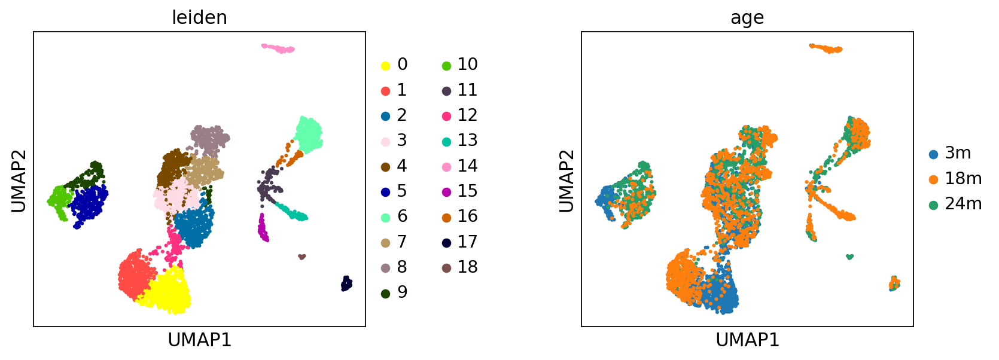

In [35]:
sc.pl.umap(tissue, color = ['leiden', 'age'], wspace=.5)

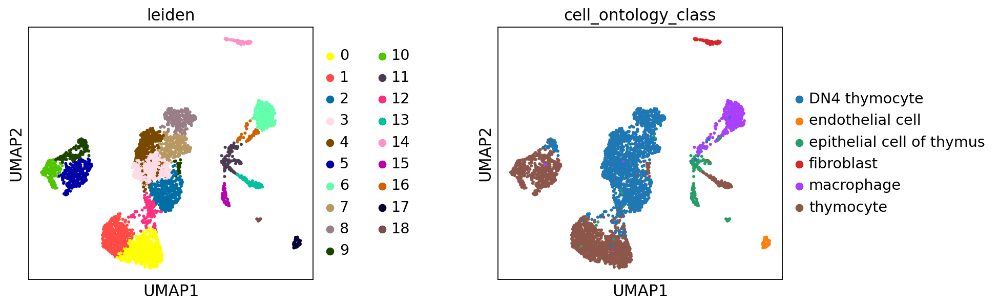

In [31]:
sc.pl.umap(tissue, color = ['leiden', 'cell_ontology_class'], wspace= 0.5)

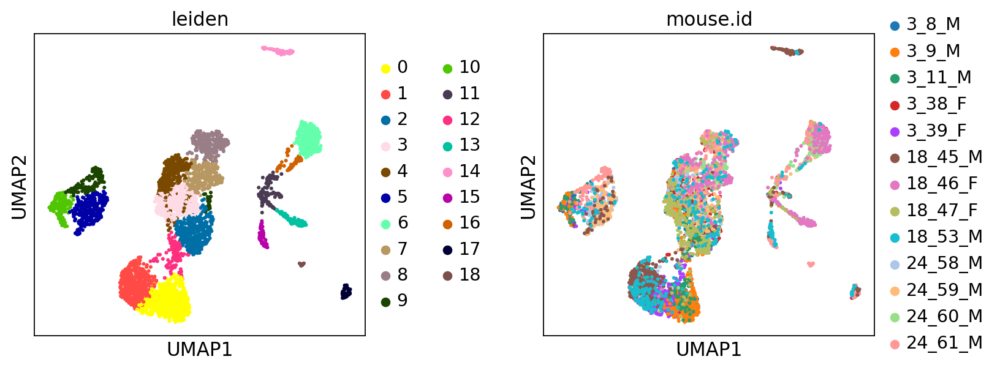

In [34]:
sc.pl.umap(tissue, color = ['leiden', 'mouse.id'], wspace= 0.4)

### Macrophage inflammatory protein production

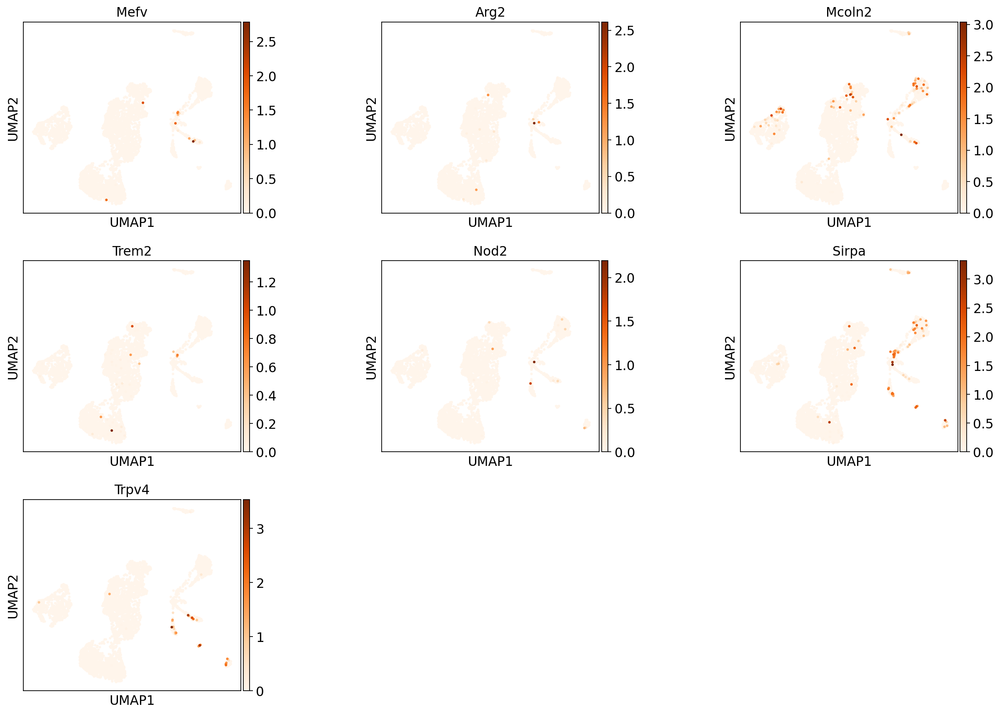

In [42]:
#as noted on geneontology.org
sc.pl.umap(tissue, color = ['Mefv', 'Arg2','Mcoln2','Trem2','Nod2','Sirpa','Trpv4'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### B cell receptor complex

... storing 'FACS.selection' as categorical
... storing 'age' as categorical
... storing 'cell_ontology_class' as categorical
... storing 'cell_ontology_id' as categorical
... storing 'free_annotation' as categorical
... storing 'method' as categorical
... storing 'mouse.id' as categorical
... storing 'sex' as categorical
... storing 'subtissue' as categorical
... storing 'tissue' as categorical
... storing 'leiden' as categorical


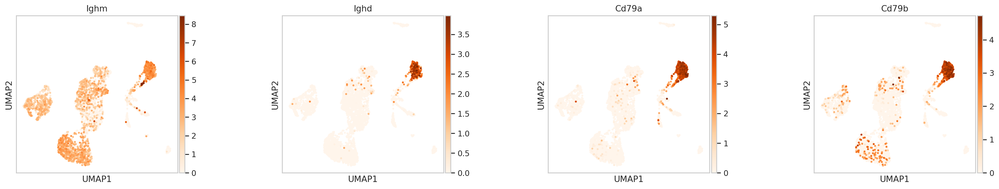

In [213]:
#as noted on geneontology.org
#sc.pl.umap(tissue, color = ['Ighm','Iglc1','Syk','Ighd','Lime1', 'Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 3)
sc.pl.umap(tissue, color = ['Ighm','Ighd','Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 4)


### Macrophage regulation

According to Human Protein Atlas
* Ulbp1: All immune cells, higest in macrophages
* Grn: Many immune cells, most highly in Hofbauer, Kupffer and macrophage cells
* Cx3cl1: low in immune cells
* Fer1l5: low in immune cells
* Cd200: Enriched in B cells, monocytes. most immune cells
* Syt11: all immune cells
* Bpi: Among immune cells, highest in monocytes
* Pla2g10: barely detected in immune cells

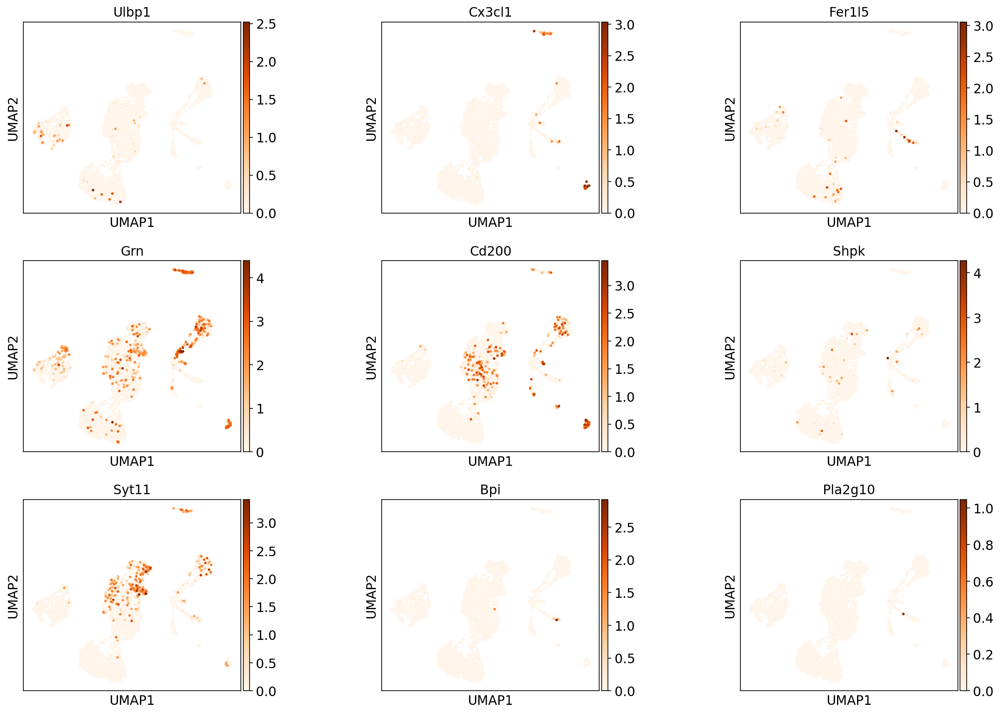

In [25]:
#as noted on geneontology.org
sc.pl.umap(tissue, color = ['Ulbp1','Cx3cl1','Fer1l5','Grn','Cd200','Shpk', 'Syt11','Bpi','Pla2g10'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### B cell differentiation

* Cd24a: results in acquisition of features of immature B cell
* Bcl6: results in acquisition of features of B cell

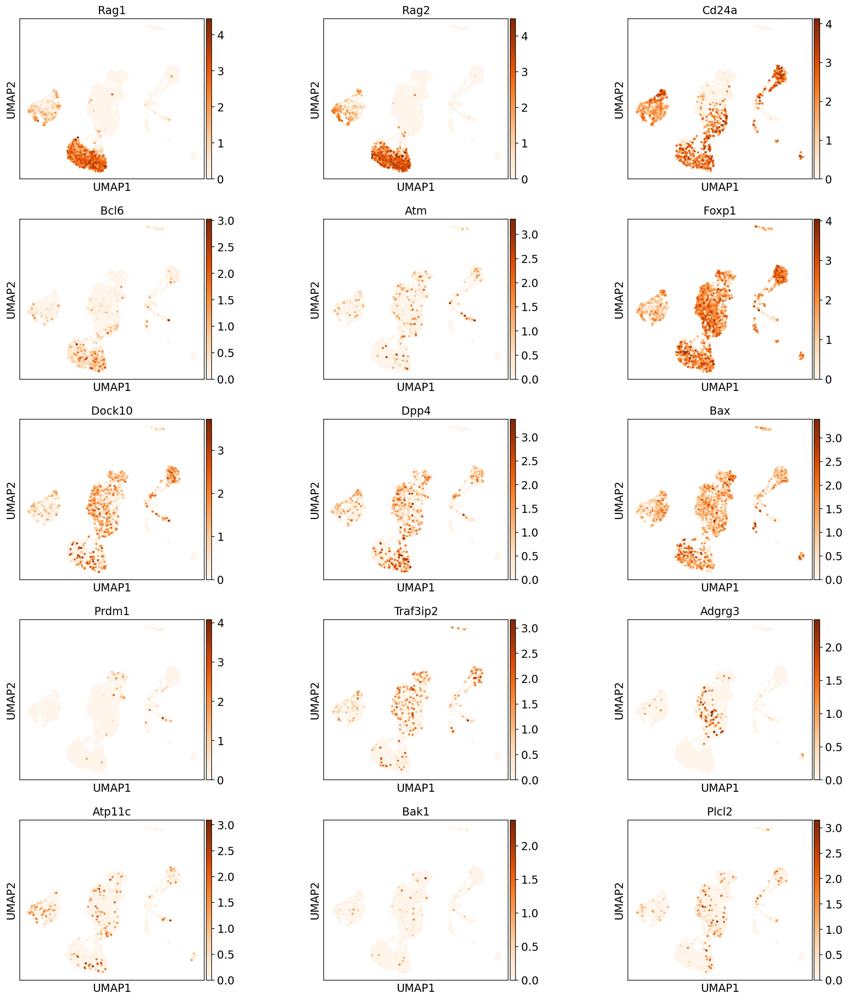

In [44]:
#as noted on geneontology.org
sc.pl.umap(tissue, color = ['Rag1', 'Rag2','Cd24a','Bcl6','Atm','Foxp1','Dock10','Dpp4','Bax','Prdm1','Traf3ip2','Adgrg3','Atp11c', 'Bak1','Plcl2'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### Interferon genes

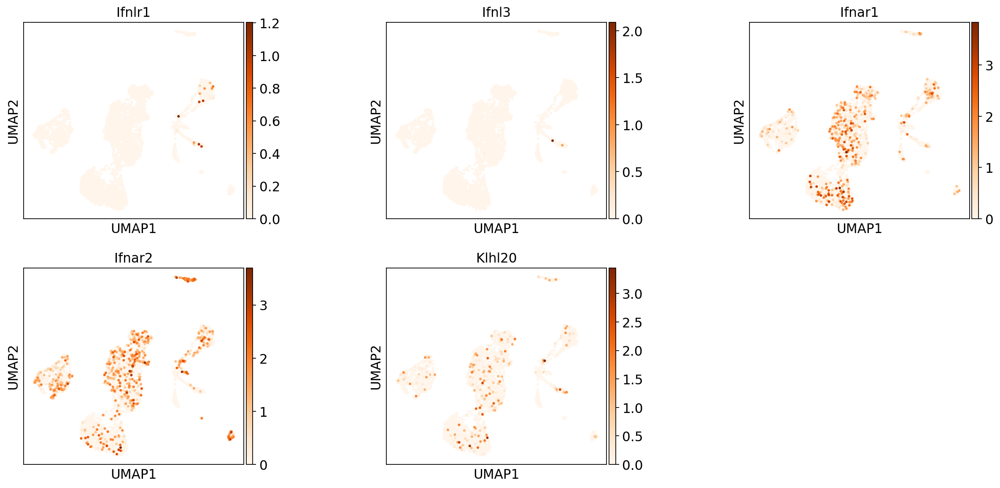

In [33]:
sc.pl.umap(tissue, color = ['Ifnlr1','Ifnl3','Ifnar1','Ifnar2','Klhl20'], wspace= 0.5, color_map= 'Oranges', ncols= 3)
#Ifnl3 is interferon lambda
#Ifnlr1 is interferon lambda receptor 
#Ifnar1 IFN-a and -b receptor
#Ifnar2 IFN-a and -b receptor
#Klhl20 IFN gamma binding

### Macropahge proliferation genes

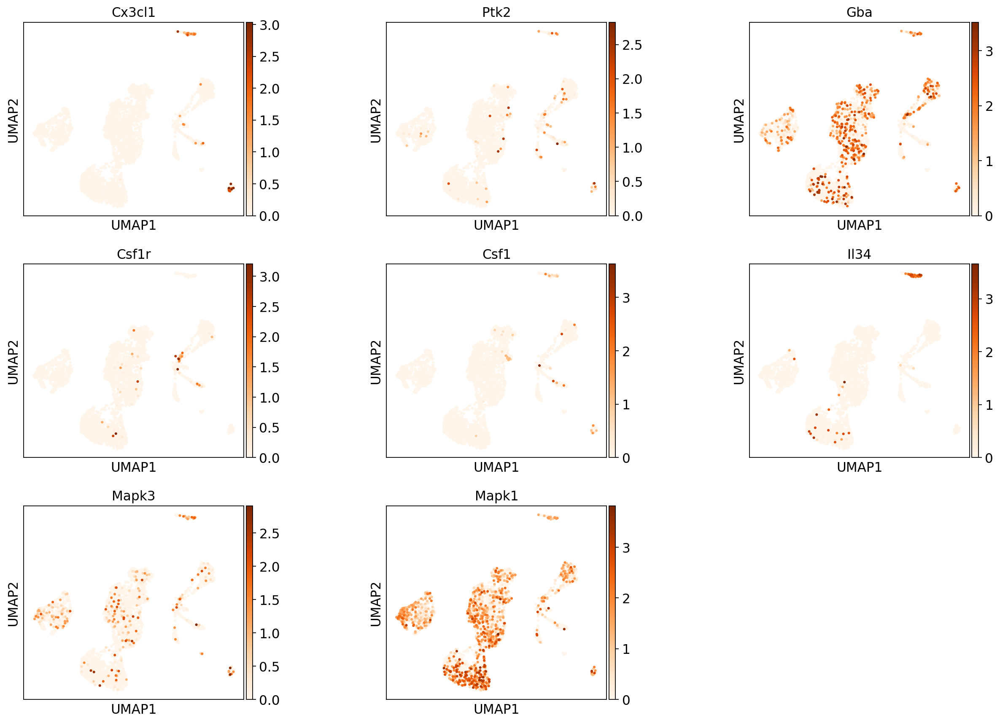

In [30]:
sc.pl.umap(tissue, color = ['Cx3cl1','Ptk2','Gba','Csf1r','Csf1','Il34','Mapk3','Mapk1'], wspace= 0.5, color_map= 'Oranges', ncols= 3)

### 'Iglc3','Iglc2','Igkc'

Highly expressed in B cells and Plasma cells, less so in T cells, not macrophages

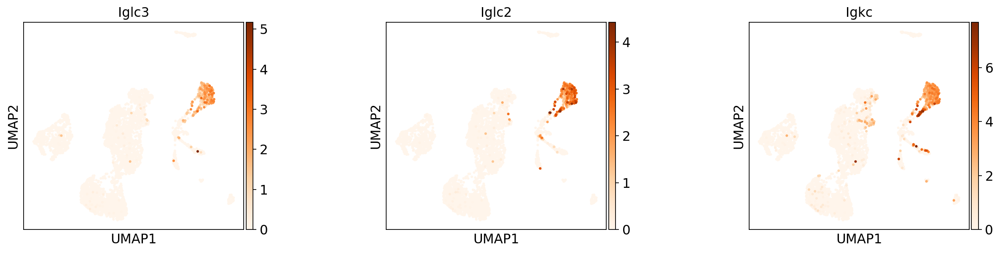

In [5]:
sc.pl.umap(tissue, color = ['Iglc3','Iglc2','Igkc'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### 'Cd79a','Cd79b','Cd37'

"CD37 is a tetraspanin expressed prominently on the surface of B cells" (https://pubmed.ncbi.nlm.nih.gov/33333768/)

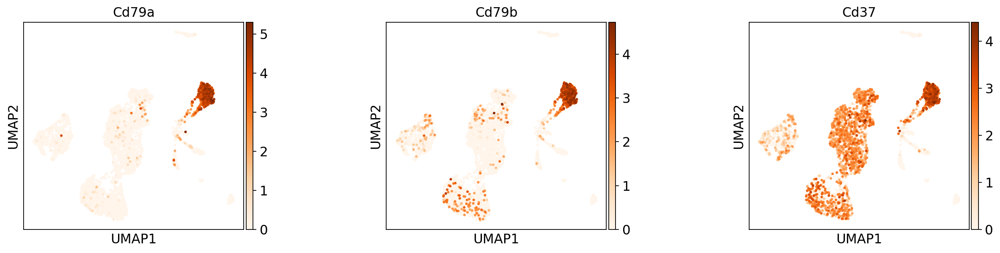

In [11]:
sc.pl.umap(tissue, color = ['Cd79a','Cd79b','Cd37'], wspace= 0.5, color_map= 'Oranges')

### 'Blnk','Mzb1', 'Jchain','Ighg2b'

Once IgG2b [IgG2b] synthesis is initiated, however, undermethylated forms of [Jchain] are found. MAYUMI YAGI AND MARIAN ELLIOTT KOSHLAND, 1981


* Blnk: most highly expressed in microglial, B cells, Plasma cells, dentrictic cells.
* Mzb1: highly expressed in Plasma cells, B cells, melanocytes.
* Jchain: highly expressed in Plasma cells, some B and T cells


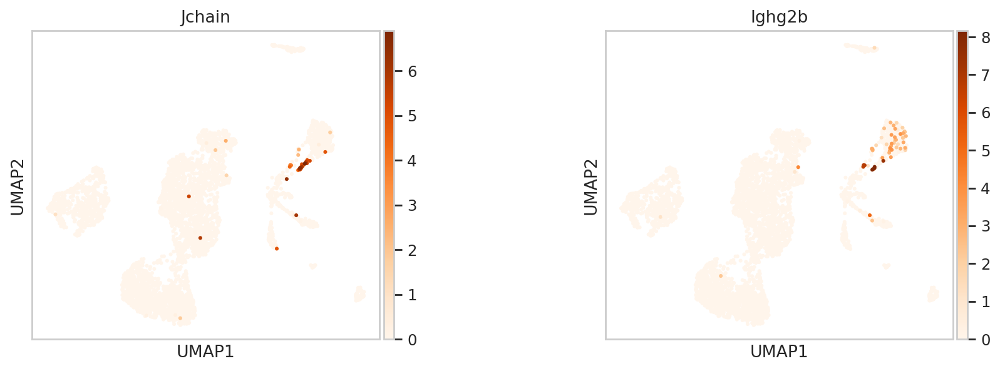

In [223]:
#sc.pl.umap(tissue, color = ['Blnk','Mzb1', 'Jchain','Ighg2b'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )
sc.pl.umap(tissue, color = ['Jchain','Ighg2b'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )

### 'Ms4a1','Cd53', 'Cd81', 'Cd82'

Energy transfer experiments indicate that CD20 is in close proximity to other tetraspan molecules, such as CD53, CD81, and CD82, forming supramolecular complexes (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7271567/)

* Ms4a1: highly expressed in B cells, a little in T cells and dendritic cells

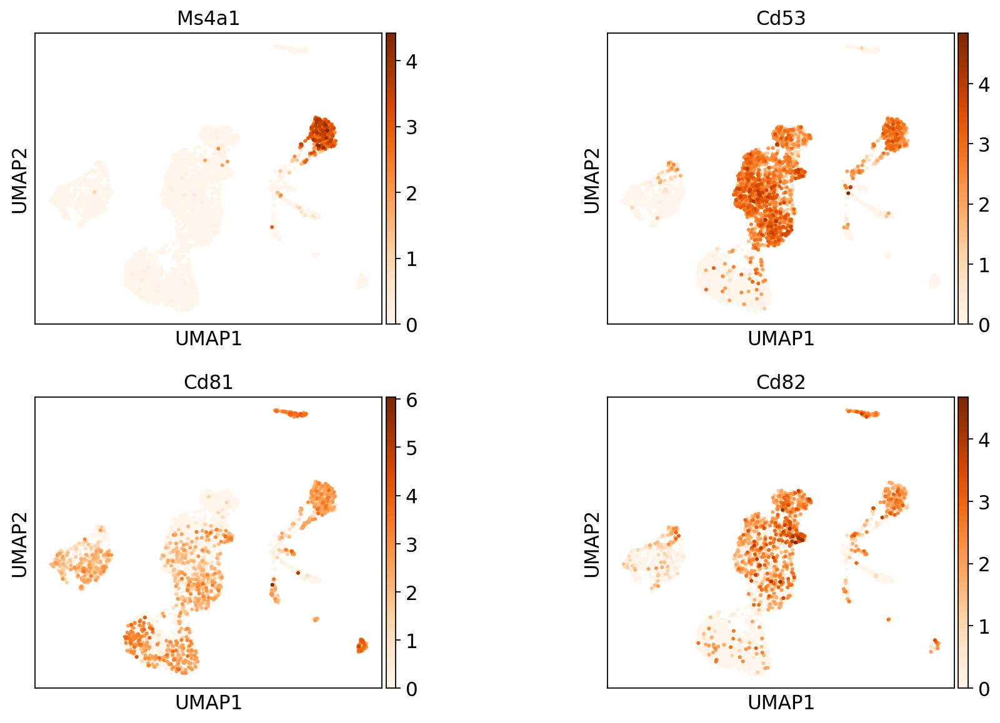

In [33]:
#Ms4a1 encodes for CD20

sc.pl.umap(tissue, color = ['Ms4a1','Cd53', 'Cd81', 'Cd82'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )


CD27- CD38+ B cells? (https://pubmed.ncbi.nlm.nih.gov/34260905/)

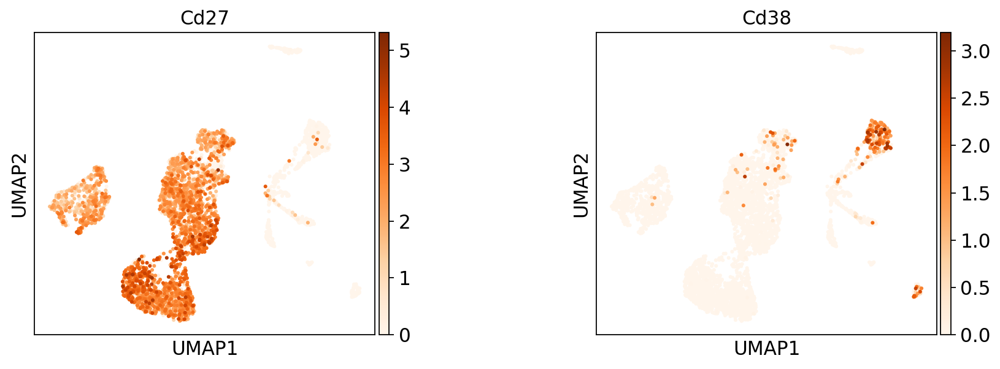

In [43]:
sc.pl.umap(tissue, color = ['Cd27', 'Cd38'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )


### Jablonski M1 & M2 marker genes

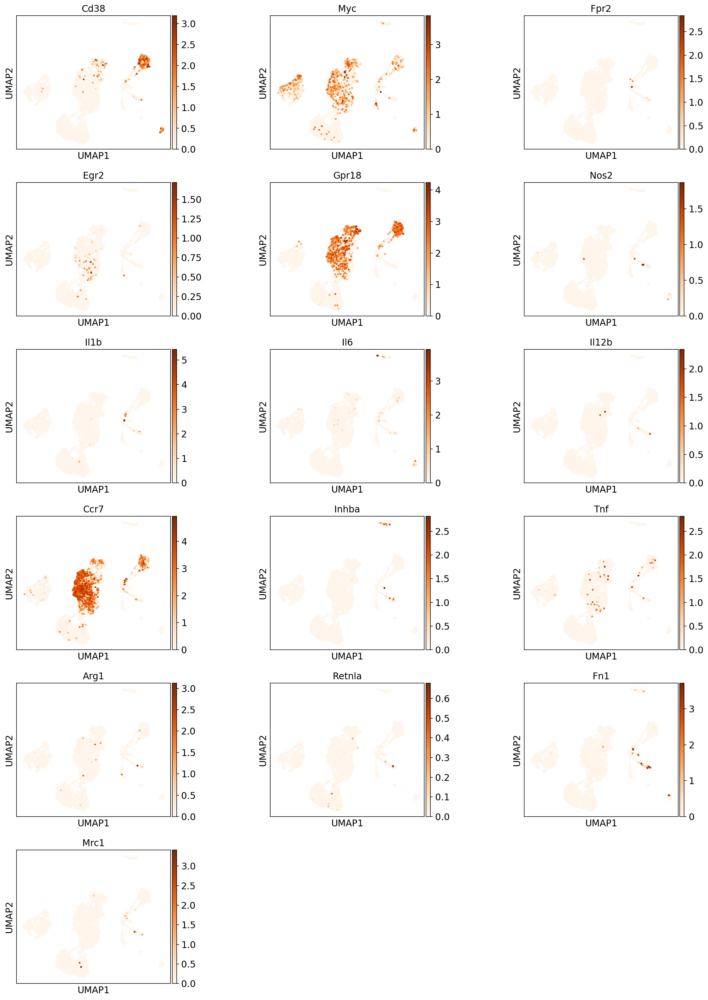

In [34]:
sc.pl.umap(tissue, color = ['Cd38','Myc','Fpr2','Egr2','Gpr18',
                   'Nos2','Il1b','Il6','Il12b','Ccr7',
                   'Inhba','Tnf','Arg1','Retnla','Fn1',
                   'Mrc1'], wspace= 0.5, color_map= 'Oranges',ncols = 3)

### MAT macrophage genes

* MAT macrophages and B cells highly expressed 'H2-Ab1','H2-Eb1'

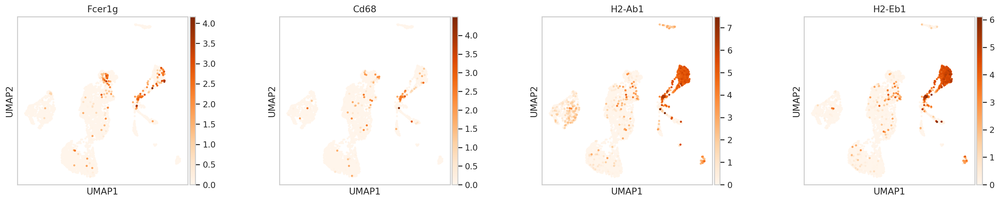

In [218]:
#sc.pl.umap(tissue, color = ['Lyz2','Mrc1','Ccl6','Fcer1g','H2-Ab1','H2-Eb1','Fcgr3','Ccl9','Cd68'], color_map= 'Oranges', wspace= 0.4, ncols = 3)

#H2 genes also express in B cells for MAT and Limb Muscle
#genes express in MAT & Limb Muscle macrophages. Not doing so for Thymus macrophages
sc.pl.umap(tissue, color = ['Fcer1g','Cd68','H2-Ab1','H2-Eb1'], color_map= 'Oranges', wspace= 0.4, ncols = 4)


### Gene umaps

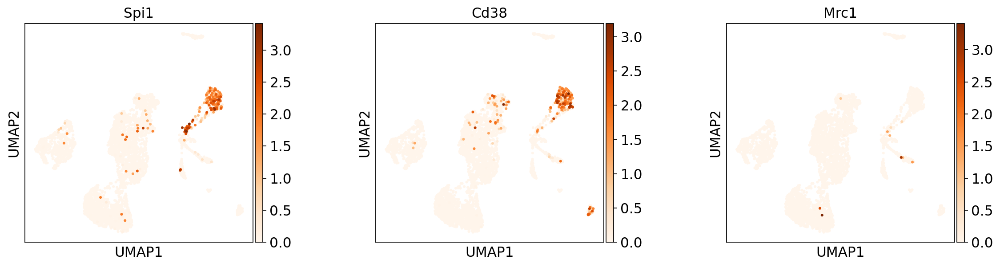

In [103]:
#macrophage assc.genes
sc.pl.umap(tissue, color = ['Spi1','Cd38', 'Mrc1'], color_map= 'Oranges', wspace= 0.4)

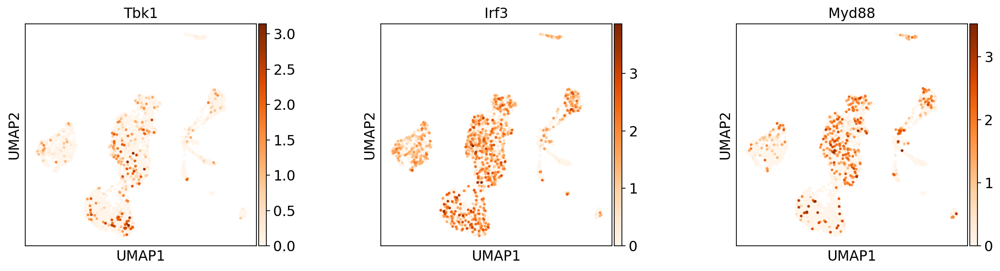

In [17]:
sc.pl.umap(tissue, color = ['Tbk1', 'Irf3','Myd88'], color_map= 'Oranges', wspace= 0.4)

* Csf1r enriched in Hofbauer cells, Kupffer cells, Macrophages, Microglial cells, Extravillous trophoblasts, Langerhans cells).
* C1qa,C1qb,C1qc in single cell type expression cluster: Macrophages - Innate immune response (mainly). Group enriched (Kupffer cells, Hofbauer cells, Macrophages)

'Csf1r','C1qc','C1qb','C1qa','C5ar1'typically cluster as macropahges

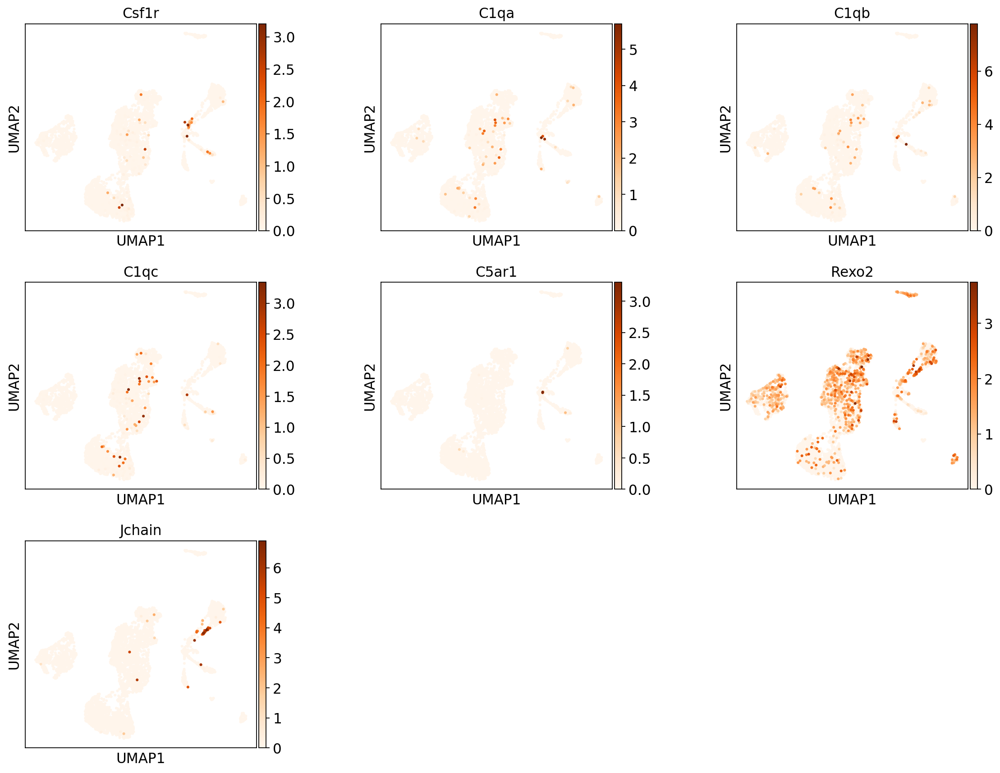

In [56]:
sc.pl.umap(tissue, color = ['Csf1r','C1qa','C1qb','C1qc','C5ar1','Rexo2','Jchain'], color_map= 'Oranges', wspace= 0.4, ncols = 3)


## Heart

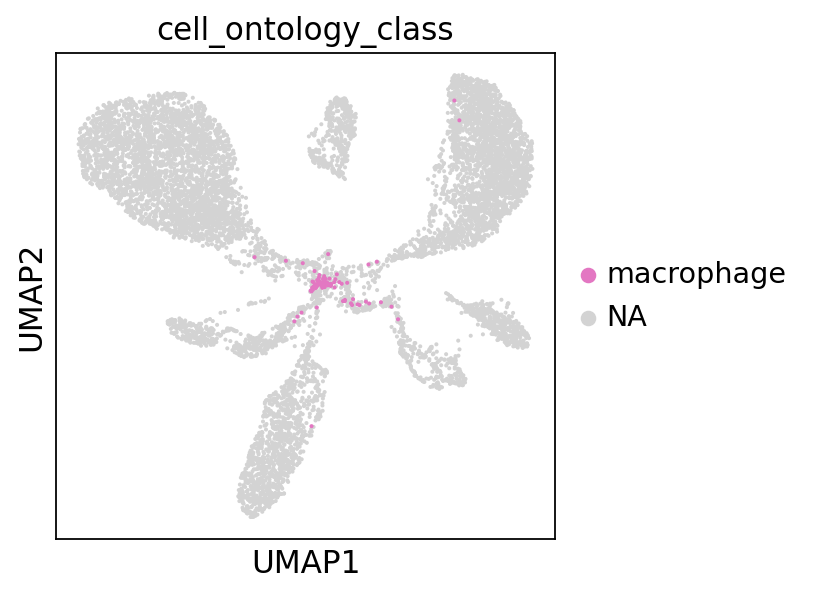

In [20]:
sc.pl.umap(tissue_heart, color = ['cell_ontology_class'], groups = 'macrophage', wspace=.5, ncols = 2)

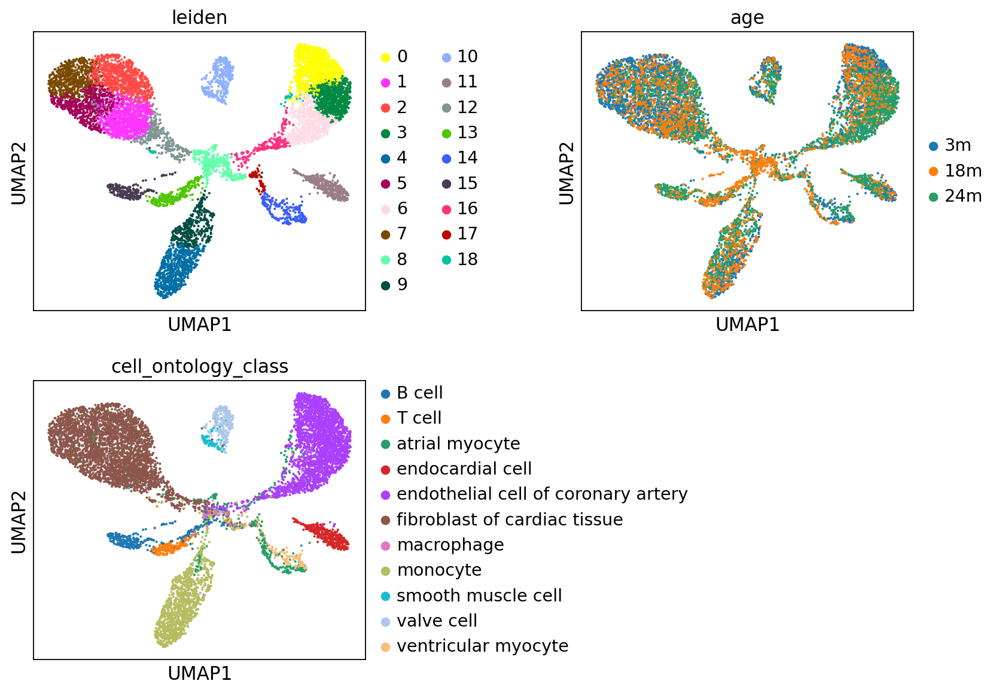

In [19]:
sc.pl.umap(tissue_heart, color = ['leiden', 'age', 'cell_ontology_class'], wspace=.5, ncols = 2)

### B cell differentiation genes

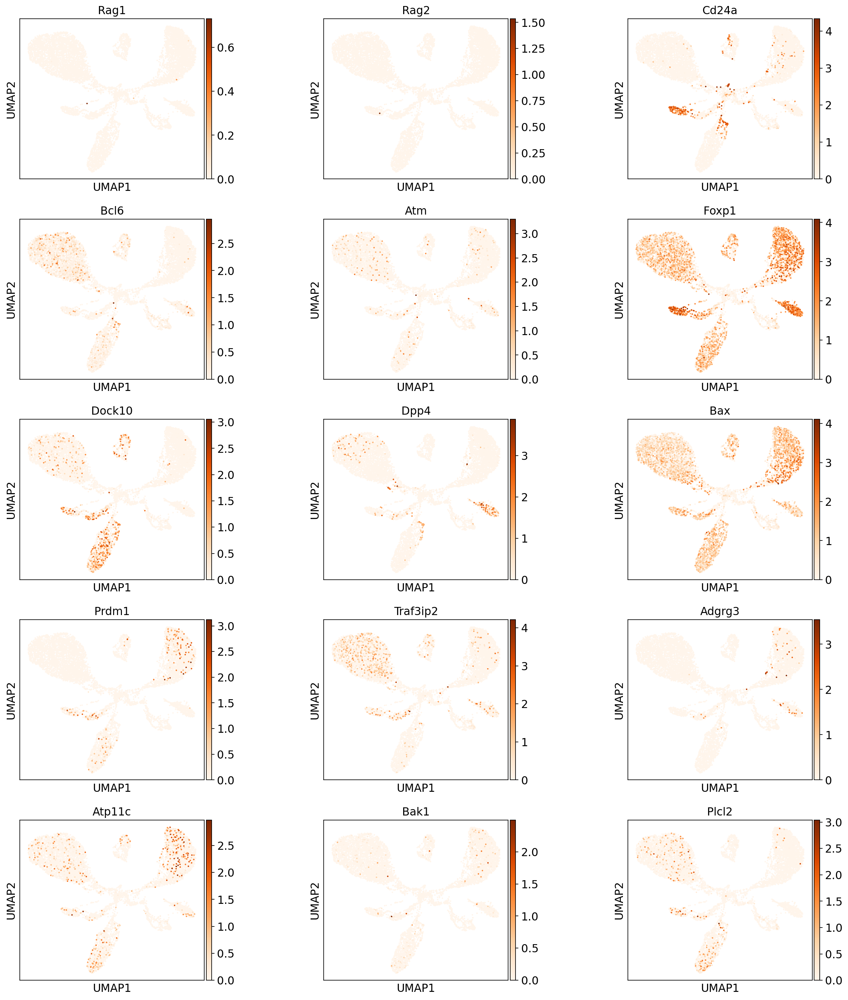

In [14]:
sc.pl.umap(tissue_heart, color = ['Rag1', 'Rag2','Cd24a','Bcl6','Atm','Foxp1','Dock10','Dpp4','Bax','Prdm1','Traf3ip2','Adgrg3','Atp11c', 'Bak1','Plcl2'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### B cell receptor complex FLAG

* The annotated macrophages for the thymus light up these BCR genes in a similar way. But Heart macrophages don't.

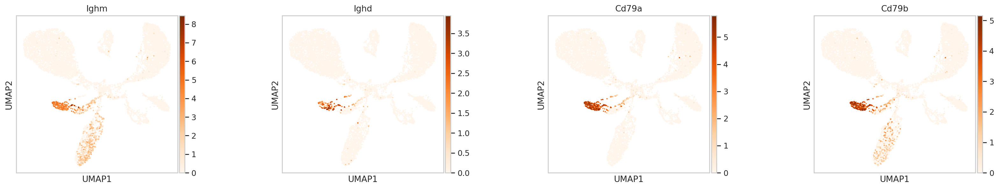

In [212]:
#sc.pl.umap(tissue_heart, color = ['Ighm','Iglc1','Syk','Ighd','Lime1', 'Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 3)
sc.pl.umap(tissue_heart, color = ['Ighm','Ighd','Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 4)


### Macrophage inflammatory protein production

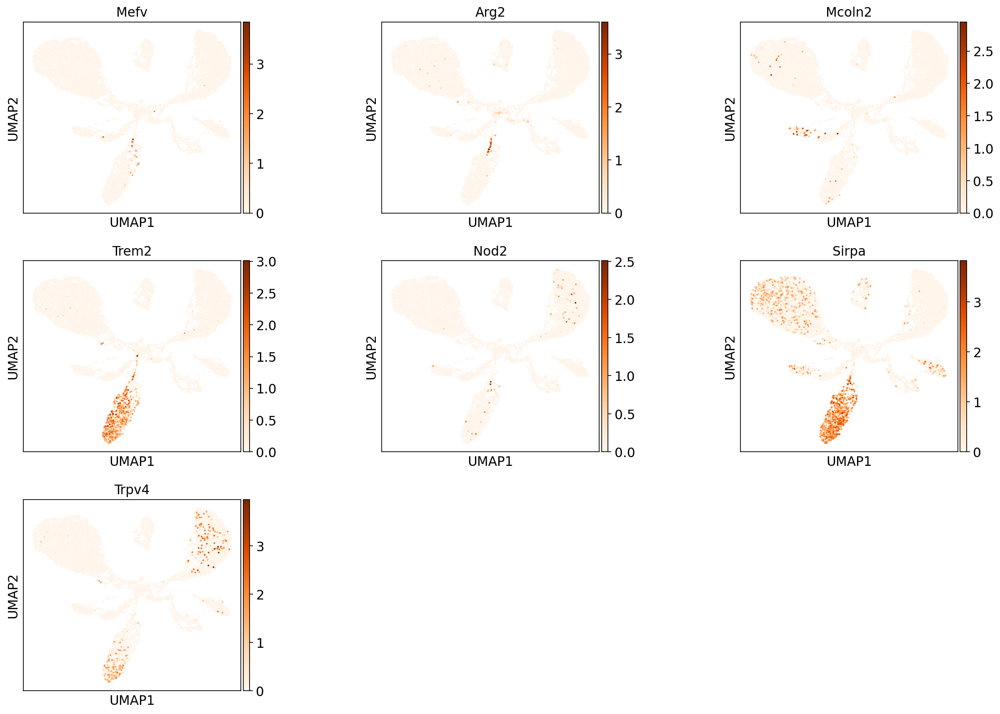

In [21]:
sc.pl.umap(tissue_heart, color = ['Mefv', 'Arg2','Mcoln2','Trem2','Nod2','Sirpa','Trpv4'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### Macrophage regulation

* Annotated Thymus macrophages also don't light up.

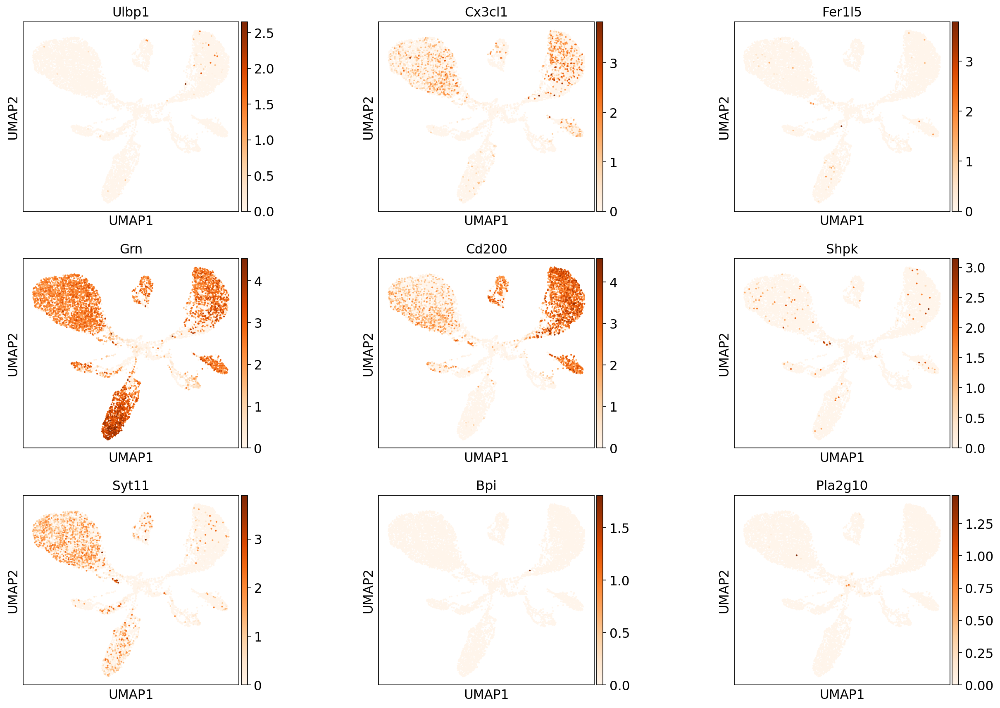

In [23]:
sc.pl.umap(tissue_heart, color = ['Ulbp1','Cx3cl1','Fer1l5','Grn','Cd200','Shpk', 'Syt11','Bpi','Pla2g10'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### Interferon genes

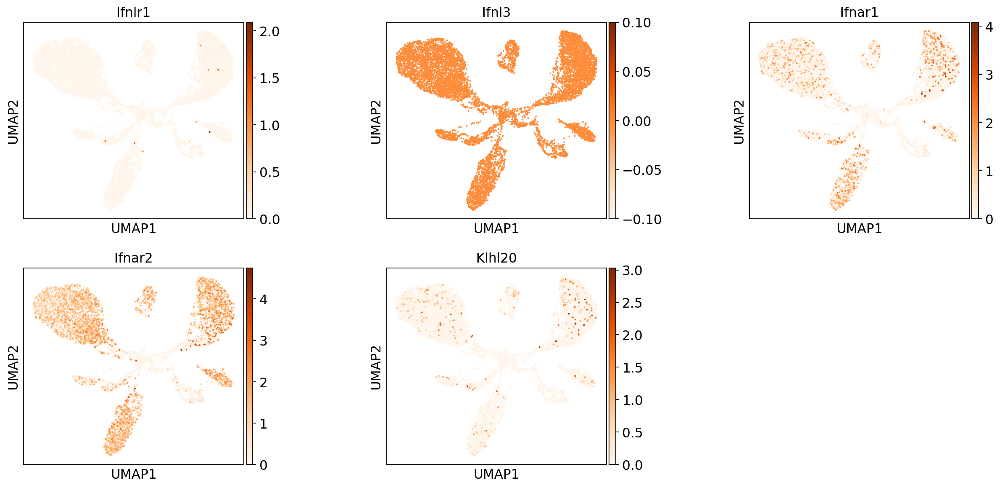

In [24]:
sc.pl.umap(tissue_heart, color = ['Ifnlr1','Ifnl3','Ifnar1','Ifnar2','Klhl20'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


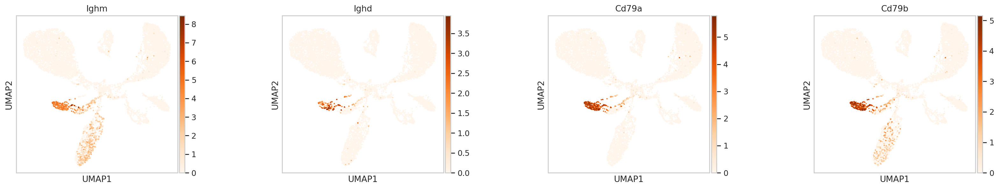

### Jablonski M1 & M2 genes FLAG

* Annotated Thymus and Heart macrophages express Gpr18.
* Annotated Thymus macrophages and Heart B cells, monocytes & endothelial cells express Cd38. 
* Heart macrophages do not express Cd38.

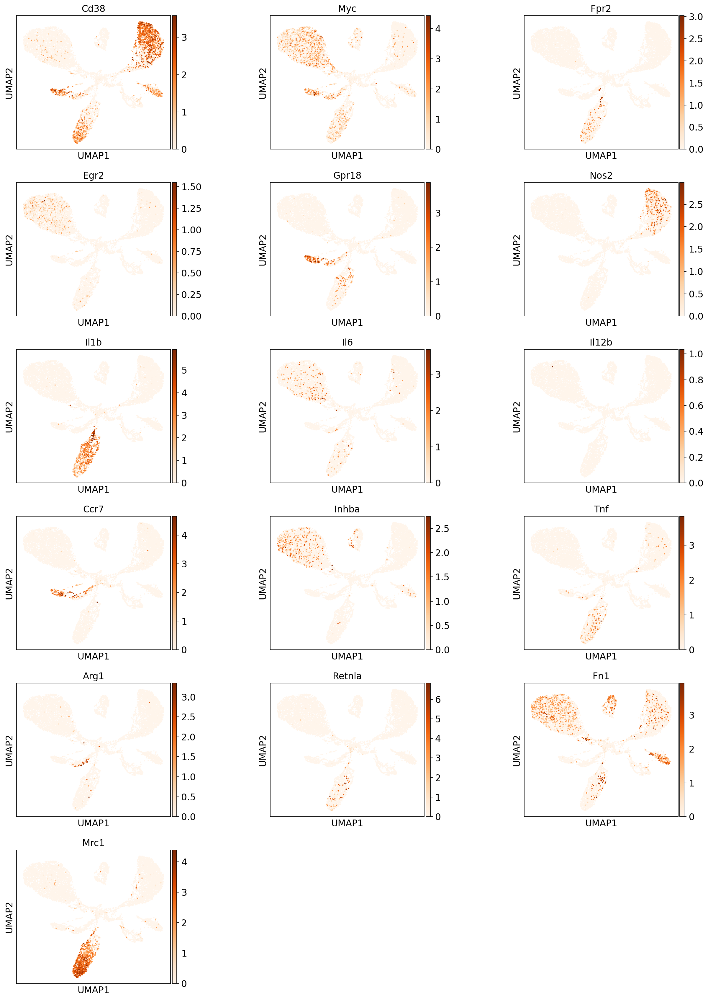

In [27]:
sc.pl.umap(tissue_heart, color = ['Cd38','Myc','Fpr2','Egr2','Gpr18',
                   'Nos2','Il1b','Il6','Il12b','Ccr7',
                   'Inhba','Tnf','Arg1','Retnla','Fn1',
                   'Mrc1'], wspace= 0.5, color_map= 'Oranges',ncols = 3)

#Annotated Thymus and Heart macrophages express Gpr18.

### 'Iglc3','Iglc2','Igkc' FLAG

* Highly expressed in B cells and Plasma cells, less so in T cells, not macrophages
* Expressed in Heart B cells and Thymus "macrophages."

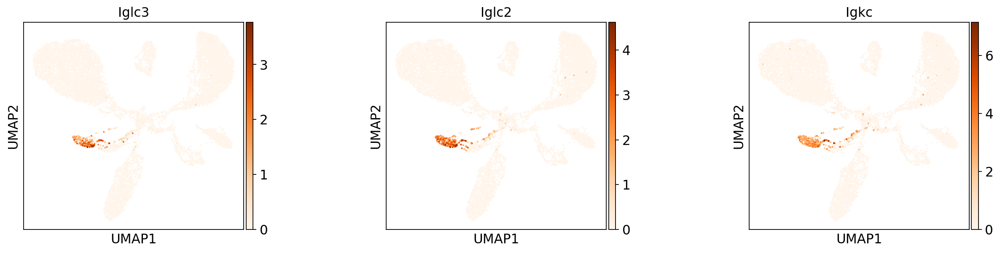

In [28]:
sc.pl.umap(tissue_heart, color = ['Iglc3','Iglc2','Igkc'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### 'Cd79a','Cd79b','Cd37' FLAG

"CD37 is a tetraspanin expressed prominently on the surface of B cells" (https://pubmed.ncbi.nlm.nih.gov/33333768/)

* Annotated Thymus macrophages had similar expression as Heart B Cells.

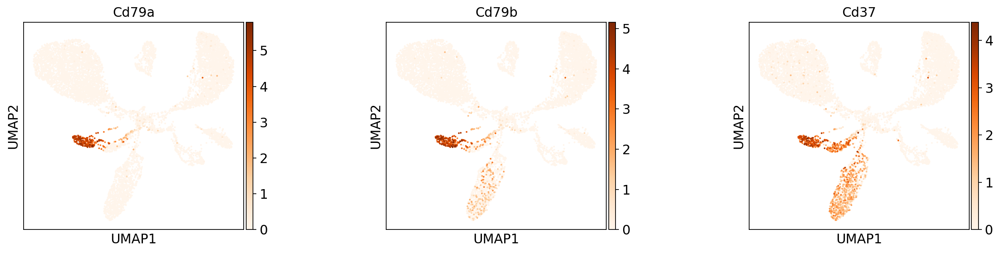

In [29]:
sc.pl.umap(tissue_heart, color = ['Cd79a','Cd79b','Cd37'], wspace= 0.5, color_map= 'Oranges')

### 'Blnk','Mzb1', 'Jchain','Ighg2b' FLAG

Once IgG2b [gene: Ighg2b] synthesis is initiated, however, undermethylated forms of [Jchain] are found. MAYUMI YAGI AND MARIAN ELLIOTT KOSHLAND, 1981

* Interesting that this was being expressed in Thymus "macropahges" but not in Heart

* Heart B cells overall aren't expressing Jchain, whereas Thymus leiden 16 'macrophage' were highly.

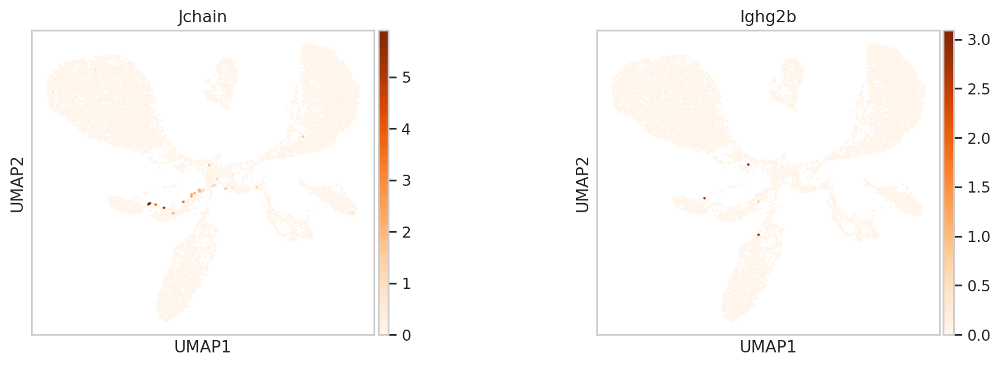

In [221]:
sc.pl.umap(tissue_heart, color = ['Jchain','Ighg2b'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )

#sc.pl.umap(tissue_heart, color = ['Blnk','Mzb1', 'Jchain','Ighg2b'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )

### 'Ms4a1', 'Cd53', 'Cd81', 'Cd82'

Ms4a1: highly expressed in B cells, a little in T cells and dendritic cells

* Thymus 'macrophages' highly express Ms4a1 whereas Heart B cells do here.

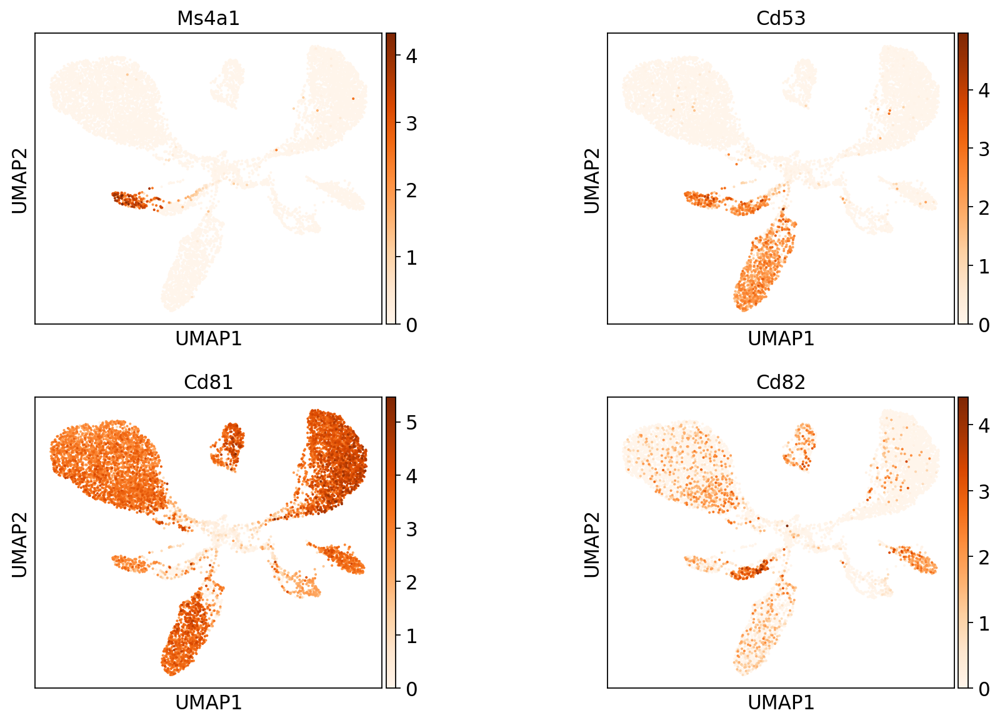

In [32]:
#Ms4a1 encodes for CD20

sc.pl.umap(tissue_heart, color = ['Ms4a1','Cd53', 'Cd81', 'Cd82'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )


### MAT macrophage genes

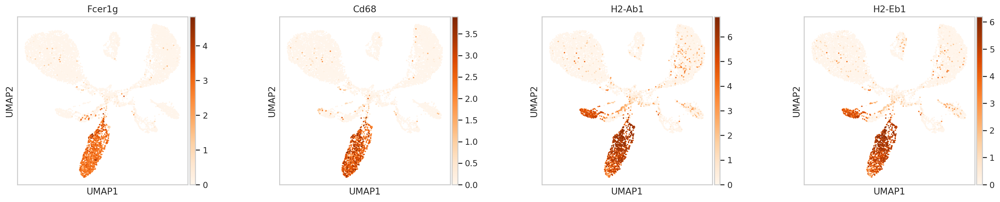

In [217]:
#sc.pl.umap(tissue_heart, color = ['Lyz2','Mrc1','Ccl6','Fcer1g','H2-Ab1','H2-Eb1','Fcgr3','Ccl9','Cd68'], color_map= 'Oranges', wspace= 0.4, ncols = 3)
#expressing in Heart monocytes like MAT & Muscle Limb macrophages

sc.pl.umap(tissue_heart, color = ['Fcer1g','Cd68','H2-Ab1','H2-Eb1'], color_map= 'Oranges', wspace= 0.4, ncols = 4)


### Extra

* Csf1r enriched in Hofbauer cells, Kupffer cells, Macrophages, Microglial cells, Extravillous trophoblasts, Langerhans cells
* C1qa,C1qb,C1qc in single cell type expression cluster: Macrophages - Innate immune response (mainly). Group enriched (Kupffer cells, Hofbauer cells, Macrophages)


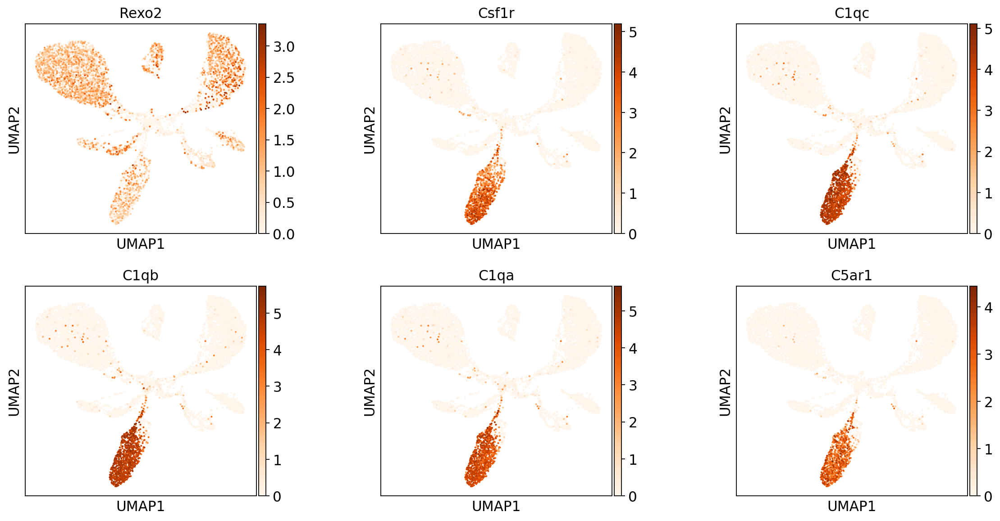

In [55]:
sc.pl.umap(tissue_heart, color = ['Rexo2','Csf1r','C1qc','C1qb','C1qa','C5ar1'], color_map= 'Oranges', wspace= 0.4, ncols=3)

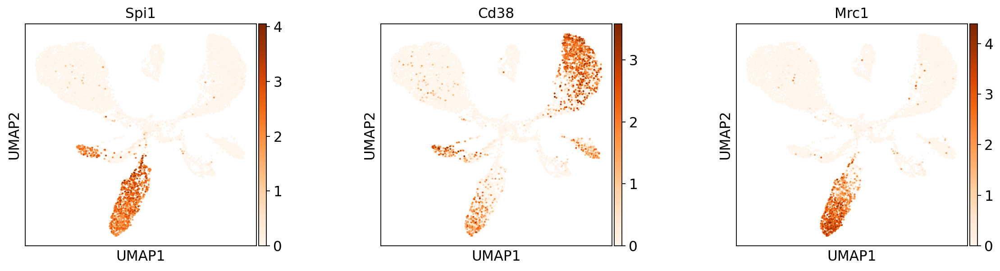

In [105]:
#macrophage assc.genes
sc.pl.umap(tissue_heart, color = ['Spi1','Cd38', 'Mrc1'], color_map= 'Oranges', wspace= 0.4)

## MAT

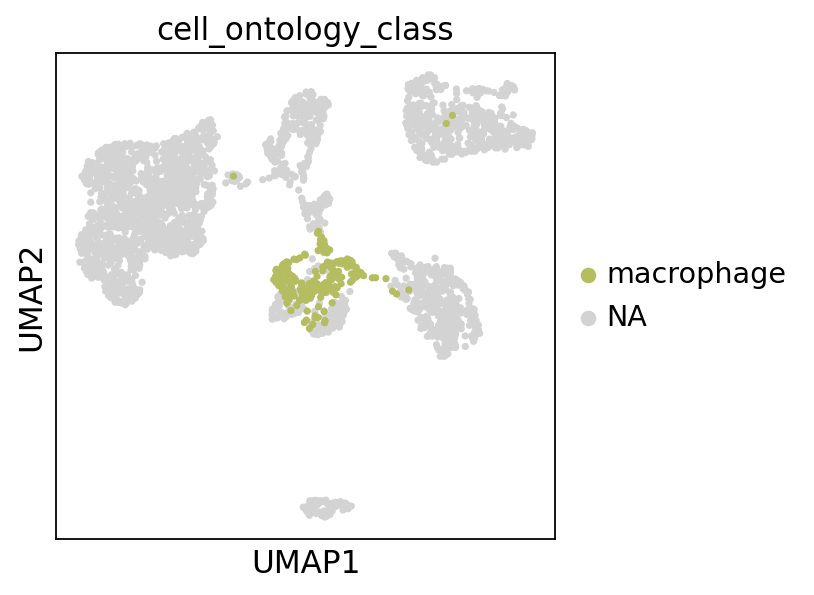

In [74]:
sc.pl.umap(tissue_mat, color = ['cell_ontology_class'], groups = 'macrophage', wspace=.5, ncols = 2)
#leiden 6, 17

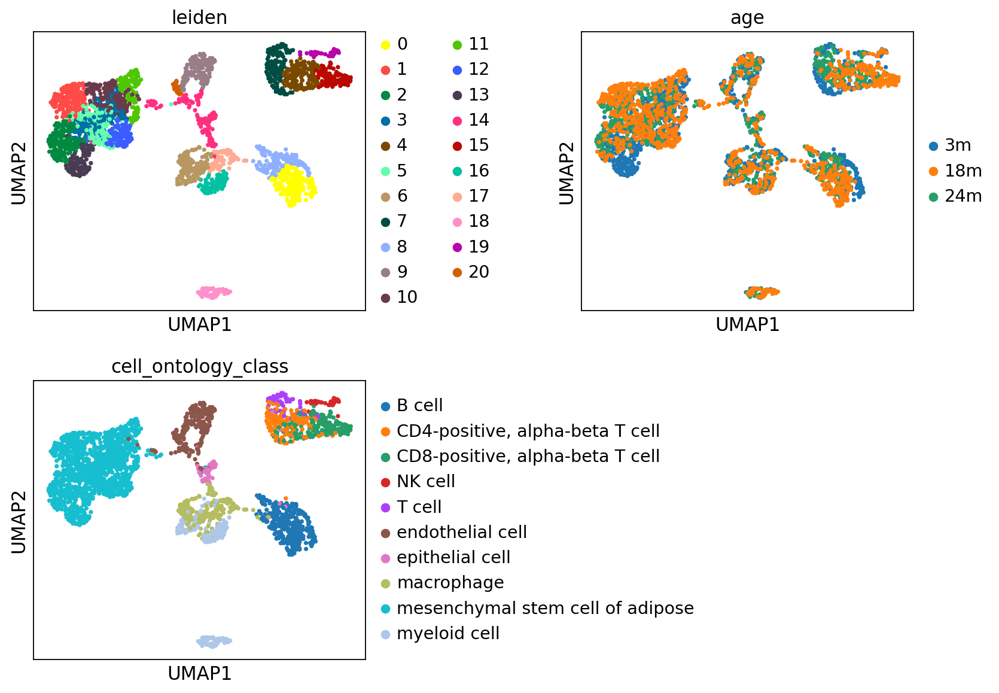

In [75]:
sc.pl.umap(tissue_mat, color = ['leiden', 'age', 'cell_ontology_class'], wspace=.5, ncols = 2)

### B cell receptor complex 

* The annotated macrophages for the thymus light up these BCR genes in a similar way. MAT macrophages (and T cells) don't except for Ighm (interesting, Immunoglobulin heavy constant mu gene). Group enriched (Plasma cells, B-cells: naive B-cell, memory B-cell)

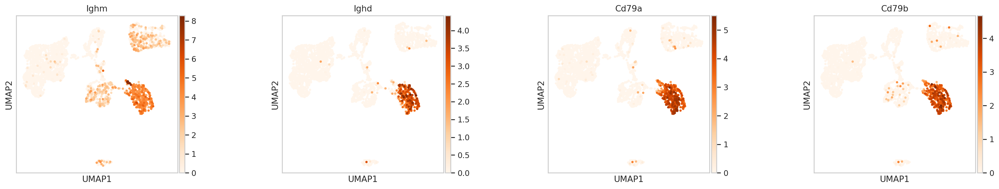

In [214]:
#sc.pl.umap(tissue_mat, color = ['Ighm','Iglc1','Syk','Ighd','Lime1', 'Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 3)
sc.pl.umap(tissue_mat, color = ['Ighm','Ighd','Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 4)


### B cell differentiation

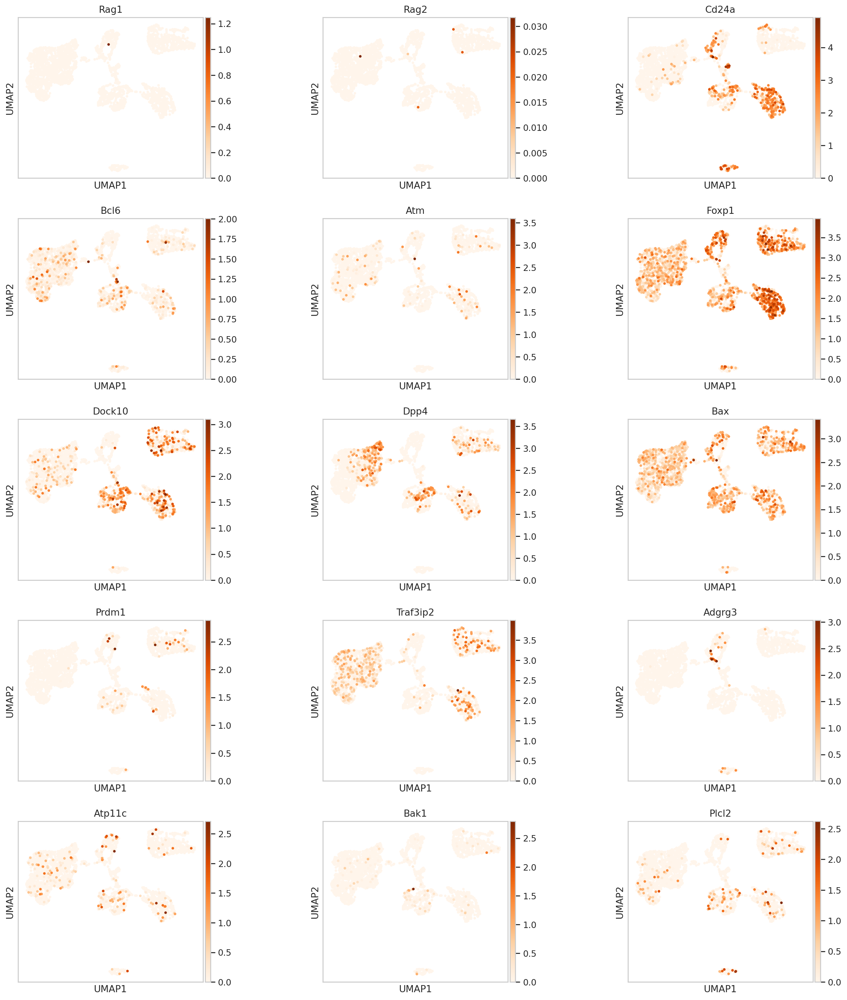

In [181]:
#as noted on geneontology.org
sc.pl.umap(tissue_mat, color = ['Rag1', 'Rag2','Cd24a','Bcl6','Atm','Foxp1','Dock10','Dpp4','Bax','Prdm1','Traf3ip2','Adgrg3','Atp11c', 'Bak1','Plcl2'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### Macrophage proliferation

* csf1r (expressed by macrophage here) promotes the release of proinflammatory chemokines in response to IL34 and CSF1 (expressed here by mesenchymal stem cells)


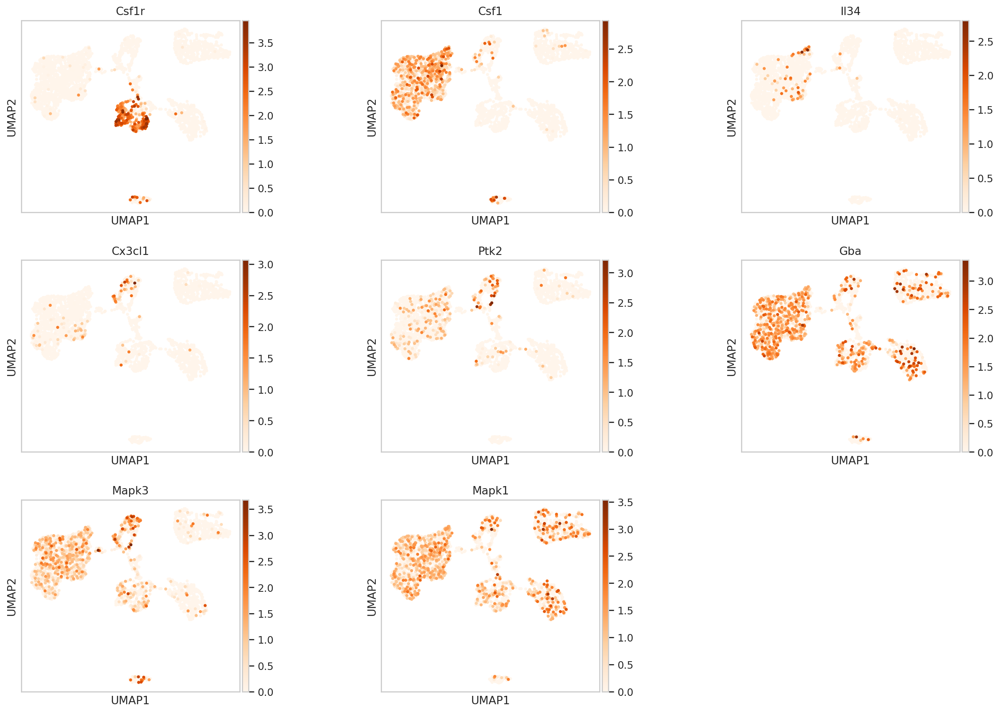

In [184]:
sc.pl.umap(tissue_mat, color = ['Csf1r','Csf1','Il34','Cx3cl1','Ptk2','Gba','Mapk3','Mapk1'], wspace= 0.5, color_map= 'Oranges', ncols= 3)



### 'Iglc3','Iglc2','Igkc'

* Highly expressed in B cells and Plasma cells, less so in T cells, not macrophages
* Expressed in Heart B cells, MAT B cells and Thymus "macrophages."

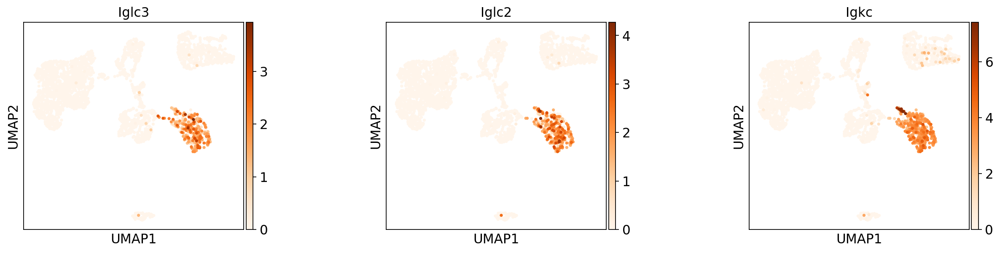

In [79]:
sc.pl.umap(tissue_mat, color = ['Iglc3','Iglc2','Igkc'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### Jablonski M1 & M2 marker genes

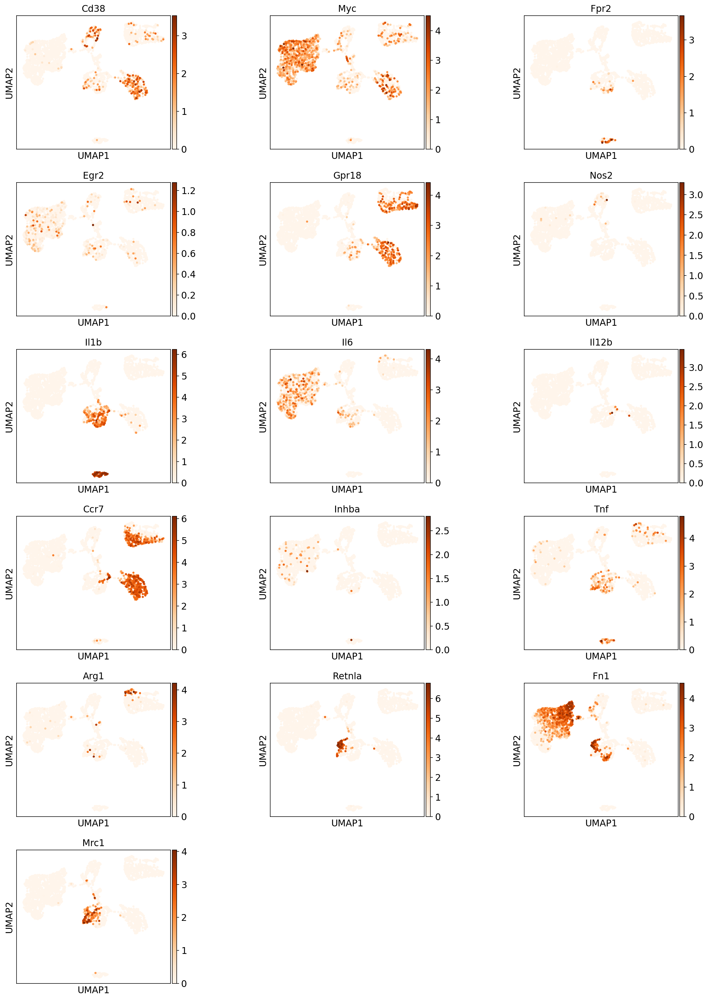

In [77]:
sc.pl.umap(tissue_mat, color = ['Cd38','Myc','Fpr2','Egr2','Gpr18',
                   'Nos2','Il1b','Il6','Il12b','Ccr7',
                   'Inhba','Tnf','Arg1','Retnla','Fn1',
                   'Mrc1'], wspace= 0.5, color_map= 'Oranges',ncols = 3)

#Annotated Thymus and Heart macrophages express Gpr18.

###  'Cd79a','Cd79b','Cd37'

* Annotated Thymus macrophages had similar expression as Heart B Cells and MAT B cells.

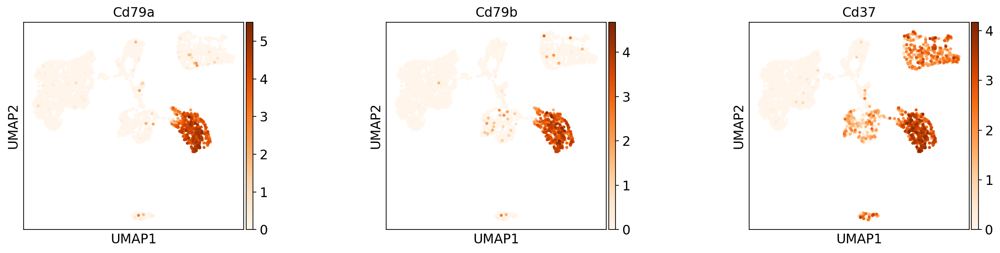

In [80]:
sc.pl.umap(tissue_mat, color = ['Cd79a','Cd79b','Cd37'], wspace= 0.5, color_map= 'Oranges')

### 'Blnk','Mzb1', 'Jchain','Ighg2b'

* Heart B cells & MAT B cells overall aren't expressing Jchain, whereas Thymus leiden 16 'macrophage' were highly.
* Once IgG2b [gene: Ighg2b] synthesis is initiated, however, undermethylated forms of [Jchain] are found. MAYUMI YAGI AND MARIAN ELLIOTT KOSHLAND, 1981

* Heart macropahges (maybe NA?) & MAT macropahges overall aren't expressing Mzb1, whereas Thymus 'macrophage' were highly.

* Blnk is expressed by macrophages and B cells in MAT. Blnk expressed in Thymus 'macrophages.'

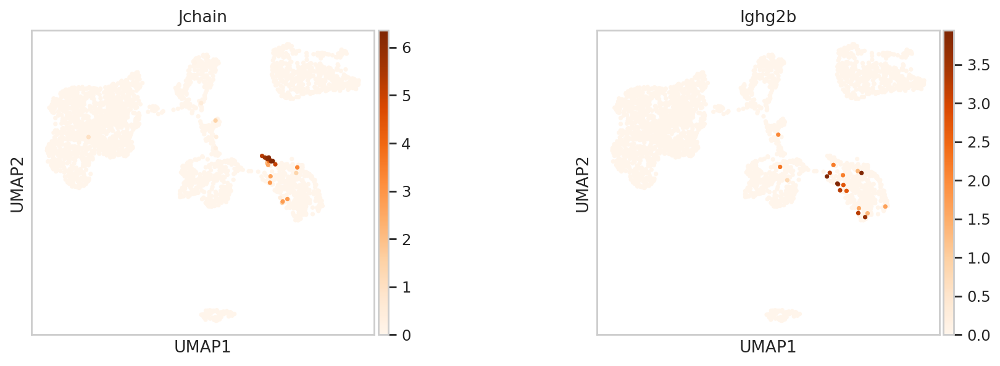

In [222]:
#sc.pl.umap(tissue_mat, color = ['Blnk','Mzb1', 'Jchain','Ighg2b'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )
sc.pl.umap(tissue_mat, color = ['Jchain','Ighg2b'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )


### Ms4a1','Cd53', 'Cd81', 'Cd82'

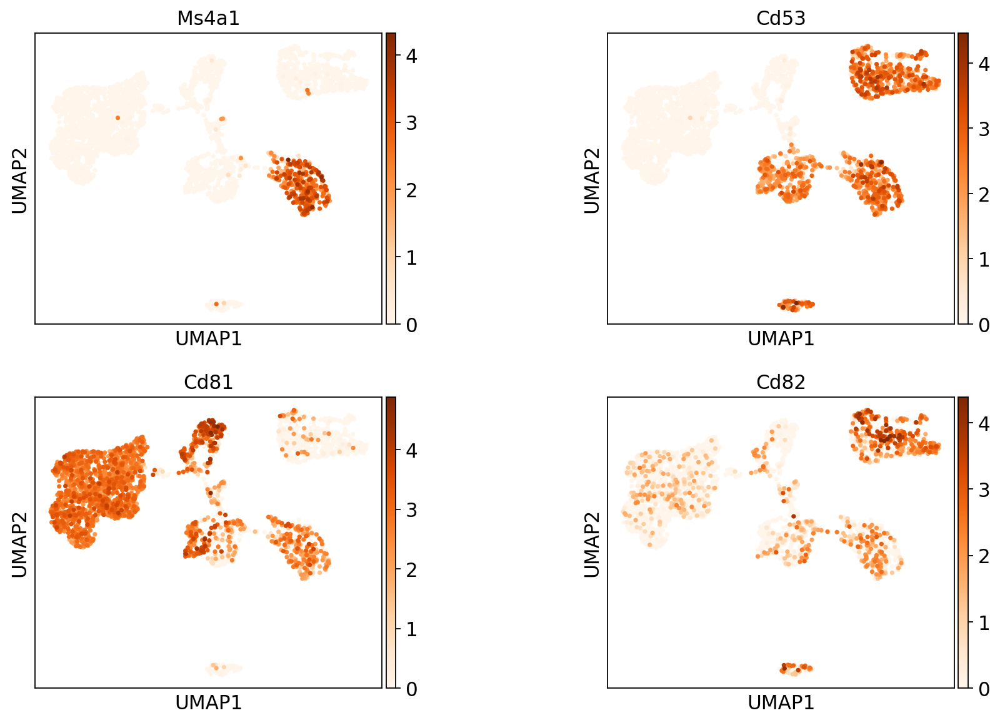

In [82]:
#Ms4a1 encodes for CD20

sc.pl.umap(tissue_mat, color = ['Ms4a1','Cd53', 'Cd81', 'Cd82'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )


### MAT macrophage genes

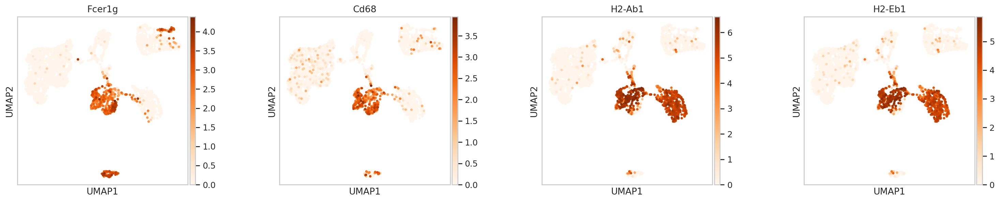

In [219]:
#sc.pl.umap(tissue_mat, color = ['Lyz2','Mrc1','Ccl6','Fcer1g','H2-Ab1','H2-Eb1','Fcgr3','Ccl9','Cd68'], color_map= 'Oranges', wspace= 0.4, ncols = 3)
#express in MAT & Limb Muscle macrophages
#H2 genes also express in MAT & Limb Muscle B Cells

sc.pl.umap(tissue_mat, color = ['Fcer1g','Cd68','H2-Ab1','H2-Eb1'], color_map= 'Oranges', wspace= 0.4, ncols = 4)


## Limb_Muscle

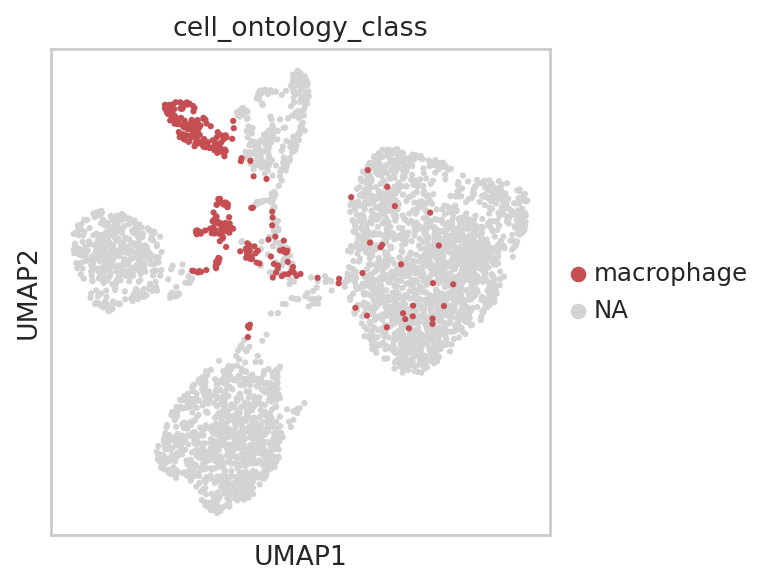

In [195]:
sc.pl.umap(tissue_lm, color = ['cell_ontology_class'], groups = 'macrophage', wspace=.5, ncols = 2)


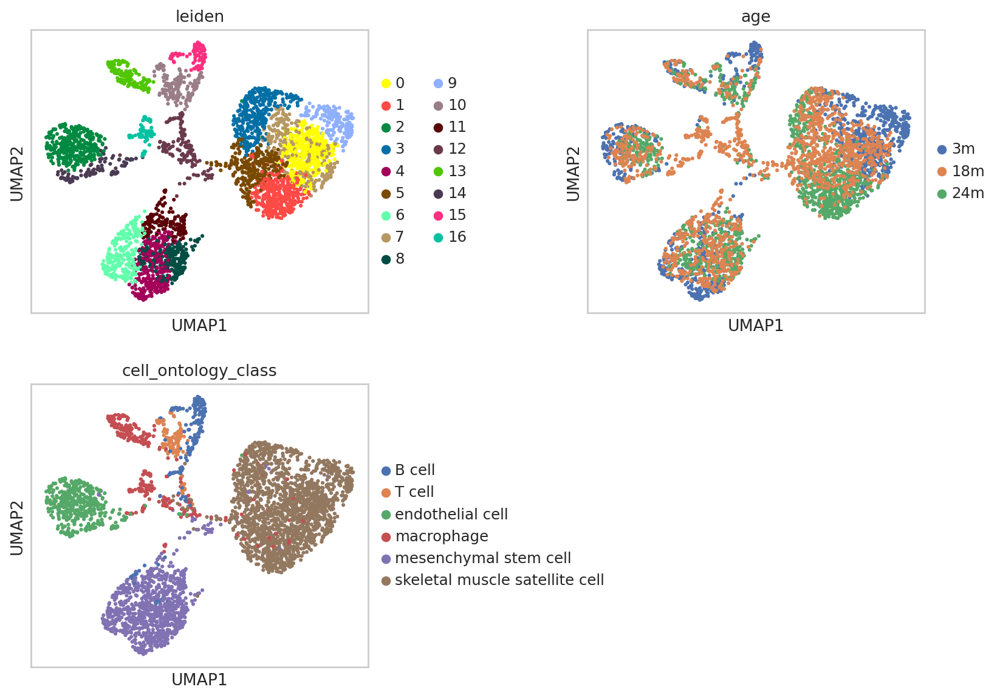

In [196]:
sc.pl.umap(tissue_lm, color = ['leiden', 'age', 'cell_ontology_class'], wspace=.5, ncols = 2)

### B cell receptor complex

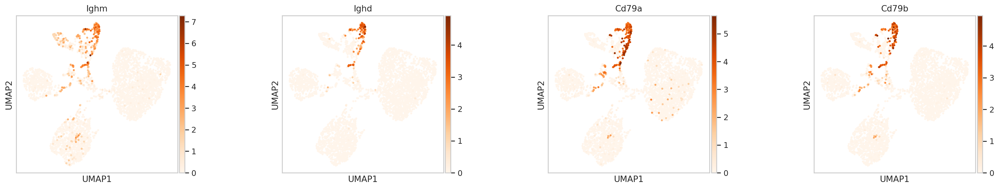

In [215]:
#sc.pl.umap(tissue_lm, color = ['Ighm','Iglc1','Syk','Ighd','Lime1', 'Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 3)
#B cells light up most
sc.pl.umap(tissue_lm, color = ['Ighm','Ighd','Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 4)


### B cell differentiation

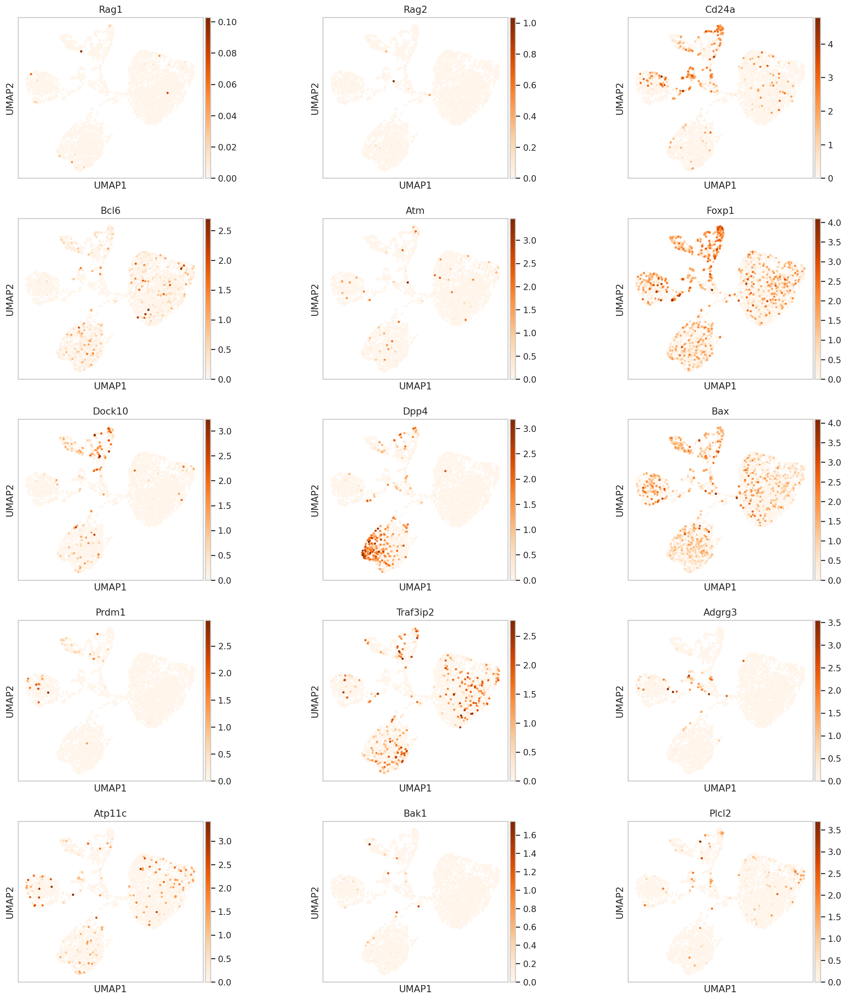

In [199]:
sc.pl.umap(tissue_lm, color = ['Rag1', 'Rag2','Cd24a','Bcl6','Atm','Foxp1','Dock10','Dpp4','Bax','Prdm1','Traf3ip2','Adgrg3','Atp11c', 'Bak1','Plcl2'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### Macrophage proliferation

* csf1r (expressed by macrophage here) promotes the release of proinflammatory chemokines in response to IL34 and CSF1 (expressed here by mesenchymal stem cells)

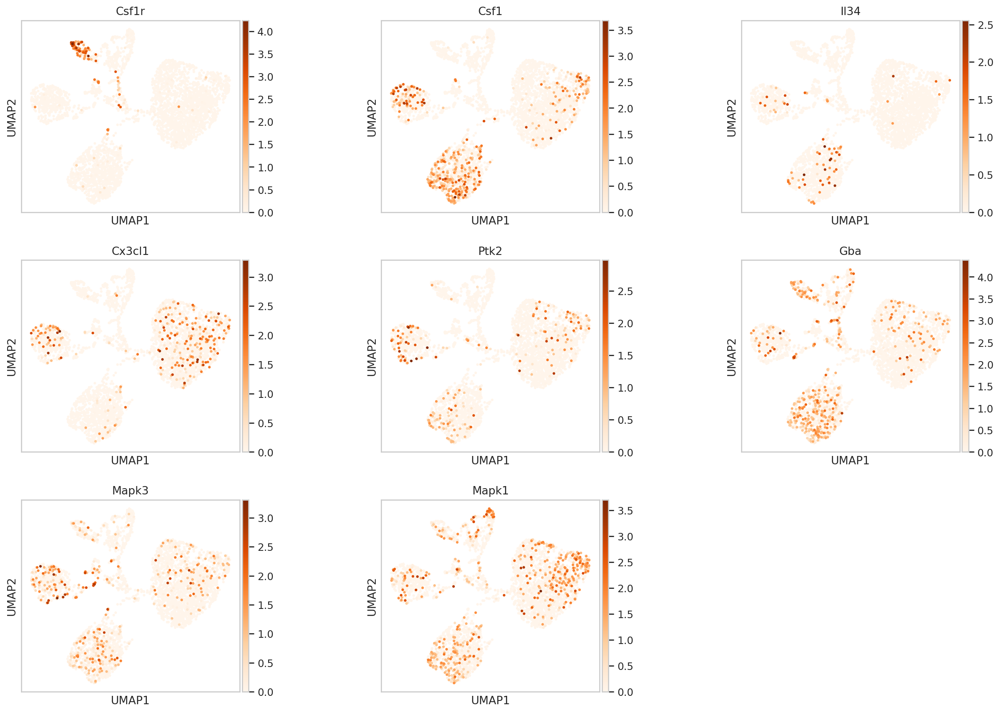

In [201]:
sc.pl.umap(tissue_lm, color = ['Csf1r','Csf1','Il34','Cx3cl1','Ptk2','Gba','Mapk3','Mapk1'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### 'Iglc3','Iglc2','Igkc'

* Highly expressed in B cells and Plasma cells, less so in T cells, not macrophages
* Expressed in Heart B cells, MAT B cells and Thymus "macrophages."

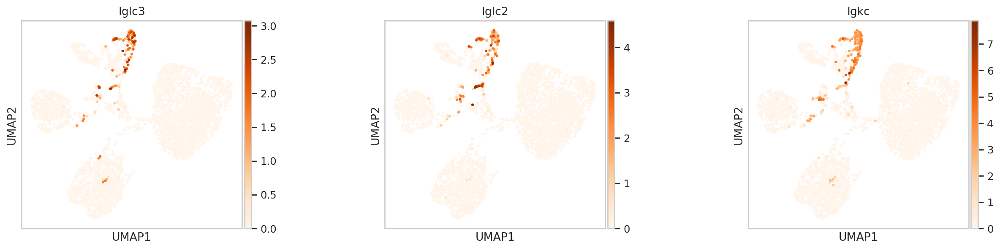

In [202]:
sc.pl.umap(tissue_lm, color = ['Iglc3','Iglc2','Igkc'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### 'Cd79a','Cd79b','Cd37'

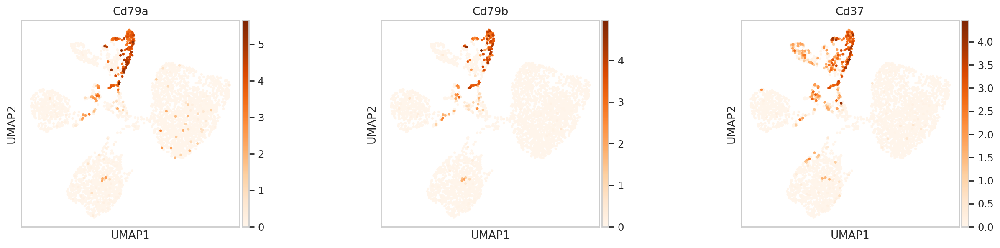

In [203]:
sc.pl.umap(tissue_lm, color = ['Cd79a','Cd79b','Cd37'], wspace= 0.5, color_map= 'Oranges')

### 'Blnk','Mzb1', 'Jchain','Ighg2b'

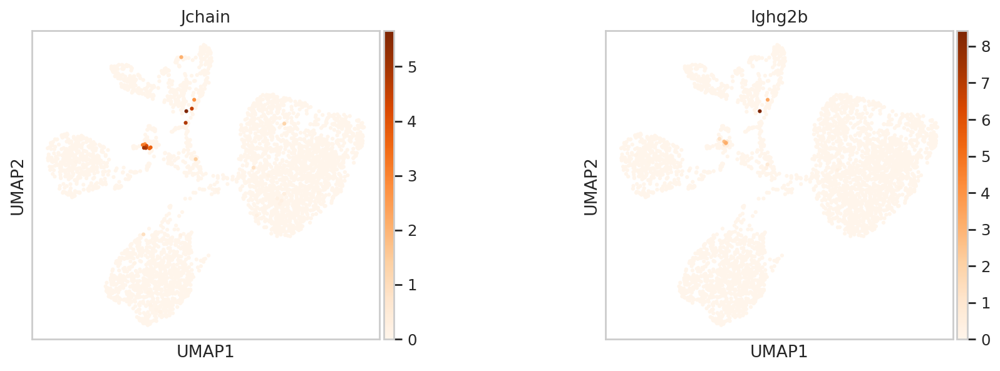

In [224]:
#sc.pl.umap(tissue_lm, color = ['Blnk','Mzb1', 'Jchain','Ighg2b'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )
#pretty in line with MAT expression

sc.pl.umap(tissue_lm, color = ['Jchain','Ighg2b'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )


### 'Ms4a1','Cd53', 'Cd81', 'Cd82'

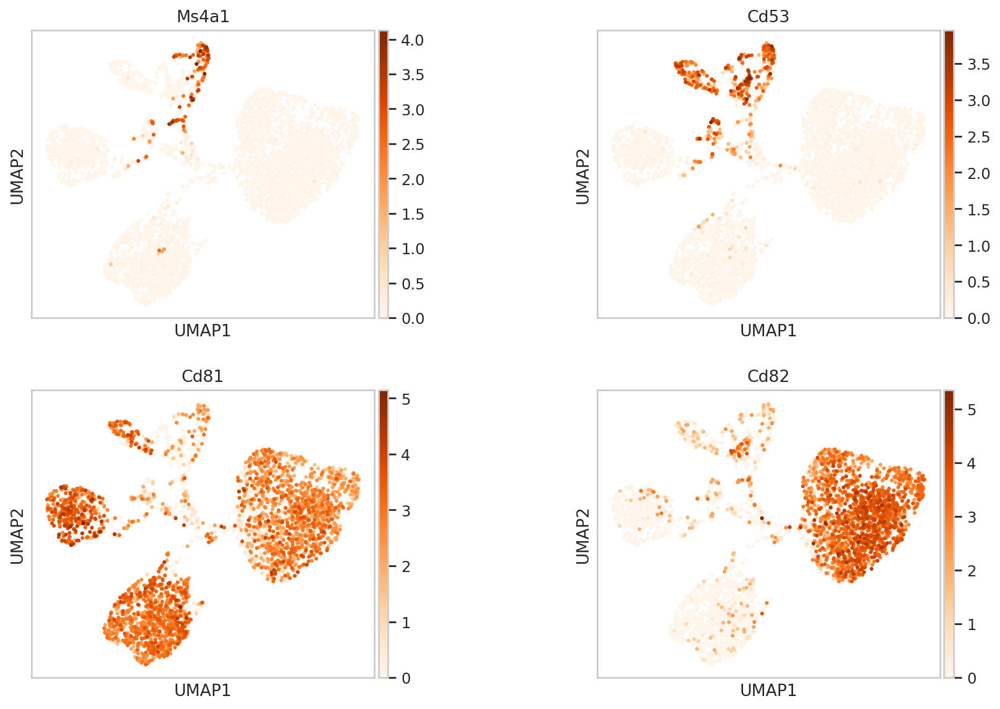

In [205]:
sc.pl.umap(tissue_lm, color = ['Ms4a1','Cd53', 'Cd81', 'Cd82'], wspace= 0.5, color_map= 'Oranges',  ncols= 2 )
#cd53: B, T and macrophages expression also in MAT
#Ms4a1 only in B cells

### MAT macrophage genes

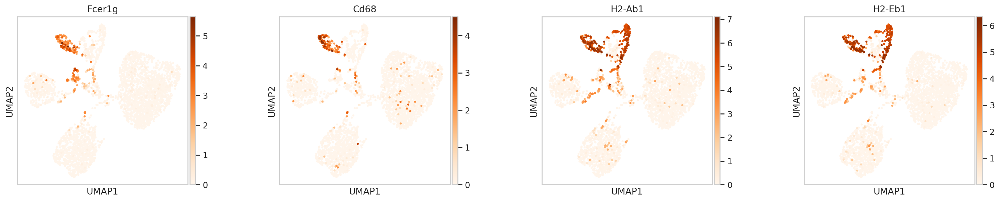

In [220]:
#sc.pl.umap(tissue_lm, color = ['Lyz2','Mrc1','Ccl6','Fcer1g','H2-Ab1','H2-Eb1','Fcgr3','Ccl9','Cd68'], color_map= 'Oranges', wspace= 0.4, ncols = 3)

#also express in Limb Muscle macrophages
#H2 genes also express in MAT B Cells

sc.pl.umap(tissue_lm, color = ['Fcer1g','Cd68','H2-Ab1','H2-Eb1'], color_map= 'Oranges', wspace= 0.4, ncols = 4)


# Lists

In [116]:
mitocarta3_path = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/Mouse_mt_genes.csv"
mitocarta3_df = pd.read_csv(mitocarta3_path)
mt_nc_genes = list(mitocarta3_df['Symbol'])

mitocarta_remove = ["mt-Atp6",
                    "mt-Atp8",
                    "mt-Co1",
                    "mt-Co2",
                    "mt-Co3",
                    "mt-Cytb",
                    "mt-Nd1",
                    "mt-Nd2",
                    "mt-Nd3",
                    "mt-Nd4",
                    "mt-Nd4l",
                    "mt-Nd5",
                    "mt-Nd6"]

#removing mt_encoded genes
for m in mitocarta_remove:
    mt_nc_genes.remove(m)

In [117]:
mt_genes = [
    "mt-Atp6",
    "mt-Atp8",
    "mt-Co1",
    "mt-Co2",
    "mt-Co3",
    "mt-Cytb",
    "mt-Nd1",
    "mt-Nd2",
    "mt-Nd3",
    "mt-Nd4",
    "mt-Nd4l",
    "mt-Nd5",
    "mt-Nd6",
    "mt-Rnr1",
    "mt-Rnr2",
    "mt-Ta",
    "mt-Te",
    "mt-Tf",
    "mt-Ti",
    "mt-Tl1",
     "mt-Tl2",
    "mt-Tm",
    "mt-Tp",
    "mt-Tq",
    "mt-Tt",
    "mt-Tv"
]

Genes not in adata.vars

In [118]:
#sc.tl.score_genes_cell_cycle ignored these genes since they're not in .vars
ignored = ['Gatd3a', 'Micos10', 'Fdx2', 'Mmut', 'Atp5pb', 'Mtarc2', 'Micos13', 'Mtres1', 'Coa8', 'Tmlhe', 'Mtarc1', 'Prxl2a', 'Marchf5', 'Dmac2l', 'Atp5md', 'Antkmt', 'Atpsckmt', 'Septin4', 'Prorp', 'Htd2', 'Pigbos1']


Mitocarta3.0 nuclear genes combined with mitochondrial genes

In [119]:
mt_nc = mt_genes + mt_nc_genes

In [120]:
tis_cells = list(set(tissue.obs['cell_ontology_class']))
ages = ['3m','18m','24m']

In [150]:
bcr = ['Ighm','Iglc1','Syk','Ighd','Lime1', 'Cd79a','Cd79b']

## Macrophage gene lists

Macrophage Polarization: Different Gene Signatures in M1(LPS+) vs. Classically and M2(LPS–) vs. Alternatively Activated Macrophages
Marco Orecchioni et al. 2019.

https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6543837/#SM5

In [121]:
#Only in vivo M1(=LPS+) UPREG
genes1 = ['Irg1','Ccl2','Csf2','Marcksl1','Il23a','Cmpk2','Rtp4','Slc7a11','Maff','Gpr85','Pde4b','Trex1','Ier3','Ifi47','Nfkbie','Oasl2','Gdf15','Cdkn1a','Slc7a2','Gem','F10','Oas2','Il15','Rnd3','Gbp2','Lif','Irf1','Fabp3','Src','Slc39a14','Ccl9','Ripk2','Plagl1','Iigp1','Rel','Tap1','Sphk1','Stat5a','Sh3bp5','Lad1','Adm','Lcp2','Zc3h12a','Calcrl','Irgm1','Arid5a','Arrdc4','Cebpd','Junb','Etv6','Stk40','Nfkb1','Daxx','E2f8','Tlr7','Fam129a','Tmem2','Znfx1','Cav1','Mmp13','Plek','Trib3','Herpud1','Asns','Tgm2','Klf7','Ptprj','Ccdc86','Slc1a4','Nmi','Tpst1','Hk2','Osgin2','Slamf9','Egr1','Akna','Atp10a','Phldb1','Sesn2','Rbpj','Mthfd2','Parp12','Aff1','Slc12a4','Tor3a','Ogfr','Kpna3','Plagl2','Casp7','Ugcg','N4bp1','Igsf8','Rasa2','Tank','Rcsd1','Trim13','Marcks','Siah2','Hivep1','Rbbp8','Tnfaip2','Tcof1','Myd88','Apbb1ip','Dab2','Psmb10','Stip1','Sp100','Myo10','Psme2','Mtmr14','Plaur','Il2rg','Aftph','Tars','Appl1','Myo1g','Dck','Sap30','Fcgr2b','Sertad2','Rabgef1','Azi2','Rnf19b','Nck1','Vav3','Trim34','Itgav','Prdm1','Aebp2','Larp1','Eef1e1','Ifitm3','Rela','Aars','Epsti1','Slc4a7','Rps6ka2','Rnf14','Gars','Tor1aip1','Katna1','Ddx21','Eif2s2','Nampt','Zfand3','Wars','Wdr43','Aida','Ube2f','Rps6ka4','Ptpn2','Sbds','Notch2','Nup62','Txnrd1','Top1','Eif6','Klf6','Gtpbp2','Lztfl1','Hspa9','Mat2a','Abca1','Ptpn12','Surf4','B3gnt2','Ghitm','Gtf2b','Slc3a2','Bcl10','Srgn','Sqstm1','Atf4','Tapbp','Eif3c','Hspa5']
M1 = []
for i in genes1:
    if i in list(tissue.var.index):
        M1.append(i)
    



In [122]:
#Only in vivo M2(+LPS-) UPREG
genes2 = ['Egr2','Fbxo32','Cebpa','Gadd45g','N4bp2l1','Tns1','Lpin1','Mnt','Rgs2','Gprc5b','Rassf3','Rasa3','Ypel3','Mknk2','Pparg','Tpcn1','Pdcd4','Arhgap18','Dnmt1','Gmnn','Rapgef6','Idh1','Klc4','Mxi1','Dennd4c','H2afv','St6gal1','Ldlrap1','Mef2d','Sgsh','Pcmtd2','Inpp5d','Ift74','Nfic','Fbxl20','Nbr1','Tsc22d3','Zdhhc14','Zrsr1','Appl2','Dio2','Cbr3','Ulk1','Pcyox1','Rab11fip5','AU020206','Cdadc1','Hmha1','Dag1','B3gnt8','Abtb1','Tbl1xr1','Mtss1','Rbl2','Gnpda1','Hdac5','Parp1','Hscb','Paip2','Ctdsp2','Fbxo8','Cnot6l','C3ar1','Hip1','Erp29','Tmem71','Mkl1','Dhcr7','Hacl1','Dgkz','Cnnm3','Sash3','Nr1d2','Ptpn22','Tmem51','Gtf2i','Cdt1','Slc29a3','Glul','0610009B22Rik','Nfam1','Acadm','Siva1','Dguok','Rmnd5a','Zfp36l2','Wdr26','Cbx3','Arhgap9','Cpt1a','Selplg','Tspan14','Hmgcl','Usf2','Slc48a1','Mfsd6','Pla2g15','Adcy7','Numa1','Coro1c','Rgl2','Rab40c','Itgb5','Thap11','Pctp','Tec','Hsd3b7','Gabarapl1','Cdk2ap2','Abhd4','Fam63a','Cd300a','Snap47','Pcyt1a','Rab31','Mbp','Bnip3l','Ivns1abp','Hbp1','Ppp3ca','Pnpla2','Snapin','Lat2','Ip6k1','Rfc2','Kif3a','Sec14l1','Xpr1','Zfand2a','Slc6a8','Pnpla7','Klhdc2','Oxct1','Clip1','Timp2','Maf1','Echs1','Map1lc3b','Ppp2r5c','Hadhb','Ncf2','Cd151','Polr2e','Osbpl9','Ralbp1','1810058I24Rik','Paics','Snx5','Hadh','Fam134b','2900097C17Rik','Hp1bp3','Dusp3','Rnf128','Elp2','Asnsd1','Large','Atxn10','Abhd12','Dap','Soat1','Lipa','Bach1','Vamp4','Rnh1','Cd84','Crip1','Gusb','Gltp','Ctnnb1','Pla2g6','Tmub1','B4galnt1','Arhgap12']
M2 = []
for i in genes2:
    if i in list(tissue.var.index):
        M2.append(i)


In [123]:
M = M1 + M2

In [124]:
M1_short = ['Junb','Cebpd','Cav1','Herpud1','Tgm2','Egr1','Il2rg','Dck','Ifitm3','Srgn','Sqstm1','Atf4','Tapbp','Hspa5']

M2_short = ['Egr2','Tns1','Ypel3','Pdcd4','Dnmt1','Gmnn','Rapgef6','Mxi1','H2afv','Nfic','Tsc22d3','AU020206','Dag1','Parp1','Paip2','Erp29','Sash3','Ptpn22','Siva1','Rmnd5a','Selplg','Cdk2ap2','Timp2','Map1lc3b','Ppp2r5c','Cd151','Dusp3','Vamp4','Crip1','Gltp','Ctnnb1','B4galnt1']


In [125]:
#Only in vivo M1(=LPS+) DOWNREG
genes3 = ['Irg1','Cd40','Ptgs2','Ccl2','Csf2','Marcksl1','Il12a','Il12b','Icam1','Ifit2','Il23a','Vcam1','Rsad2','Cmpk2','Gpr84','Nfkbiz','Rtp4','Ehd1','Traf1','Ccnd2','Socs3','Adora2a','Slc7a11','Maff','Cish','Ccl7','Ccl22','Serpine1','Serpinb2','Slfn1','Cd38','Inhba','Edn1','Csf1','Lcn2','Mefv','Aqp9','Gpr85','Nfkb2','Pde4b','Hbegf','Trex1','AW112010','Il15ra','Ier3','Ifi47','Nfkbie','Oasl2','Irf7','Zbp1','Pilra','Oas3','Gdf15','Ifih1','Slco3a1','Nfkbia','Met','Sdc4','Cdkn1a','Slc7a2','Gem','F10','Isg20','Stat2','Il15','Rnd3','Batf2','Gbp2','Tlr2','Lif','Chac1','Irf1','Fabp3','Src','Cflar','Slc39a14','Ccl9','Ripk2','Spred1','Plagl1','Iigp1','Rel','Hdc','Nupr1','Igtp','Tap1','Gas7','Mmp14','Dhx58','Agrn','Sphk1','Vcan','Stat5a','Ccl17','Ifi35','Jak2','Sh3bp5','Arg2','Gch1','Ch25h','Lad1','Peli1','Adm','Ddx60','Vasp','Lcp2','Zc3h12a','Zufsp','Calcrl','Irgm1','Eif2ak2','Arid5a','Arrdc4','Sod2','Cd274','Ell2','Cd83','Ptges','Cebpd','Junb','Etv6','Stk40','Nfkb1','Daxx','E2f8','Pvr','Tlr7','Batf','Cxcl9','Slc25a37','Ms4a6c','Pstpip2','Ccl24','Fam129a','Tmem2','Itgal','Parp9','Znfx1','Cav1','Mmp13','A630072M18Rik','Plek','Notch1','Hck','Trib3','Herpud1','Asns','Snx20','Tgm2','Nfkbib','Klf7','Ptprj','Ccdc86','Slc1a4','Nmi','Tpst1','Ccrl2','Samsn1','Dusp2','Cd14','Hk2','Cxcl16','Slfn2','Ddhd1','Jdp2','Shmt2','Osgin2','Tapbpl','Slamf9','Egr1','Akna','Stat1','Atp10a','Phldb1','Sesn2','Rbpj','Mthfd2','Parp12','Rbpms','Aff1','Socs2','Rab32','Map3k5','Slc12a4','Il1rn','Tor3a','Flnb','Ogfr','Kpna3','Birc3','Tap2','Mitd1','Rcn1','Plagl2','Casp7','Ugcg','N4bp1','Igsf8','Rasa2','Tank','Ggct','Tnip1','Rcsd1','Rrs1','Cd86','Trim13','Irf9','Il17ra','Marcks','Siah2','Hivep1','Rbbp8','Trim25','Tnfaip2','Lmo4','Tcof1','Myd88','Apbb1ip','Psmb10','Stip1','Acsl1','Ebi3','Gramd1a','Sp100','Itga5','Myo10','Acp5','Psme2','Mtmr14','Plaur','Rnf114','Il2rg','Agtrap','Iars','Aftph','Tars','Appl1','Psmb9','Ifnar2','Myo1g','Dck','St3gal3','Sap30','Fcgr2b','Sertad2','Rabgef1','Azi2','Rnf19b','Nck1','Vav3','Trim34','Clcn5','Slc31a1','Tnfrsf1b','Mtdh','Itgav','Prdm1','Aebp2','Larp1','Eef1e1','Ifitm3','Rela','Aars','Epsti1','Slc4a7','Zyx','Rps6ka2','Rnf14','Gars','Tor1aip1','Katna1','Ddx21','Eif2s2','Nampt','Zfand3','Clic4','Wars','Wdr43','Aida','Cpd','Ube2f','Rps6ka4','Ptpn2','Sbds','Psmb8','Notch2','Nup62','Skil','Txnrd1','Top1','Pdpn','Eif6','Klf6','Gtpbp2','Lztfl1','Hspa9','Mat2a','Plk2','Abca1','Ptpn12','Surf4','Cd44','B3gnt2','Snx10','Syk','Ghitm','Denr','Gtf2b','Gadd45b','Slc3a2','Rars','Bcl10','Srgn','Slc15a3','Sqstm1','Actn1','Atf4','Tapbp','Eif3c','Hspa5']

M1_down = []
for i in genes3:
    if i in list(tissue.var.index):
        M1_down.append(i)


In [126]:
#Only in vivo M2(+LPS-) DOWNREG
M2_down = ['Fbxo32','Cebpa','Gadd45g','N4bp2l1','Tns1','Lpin1','Mnt','Rgs2','Gprc5b','Rassf3','Rasa3','Ypel3','Mknk2','Pparg','Rhov','Tpcn1','Pdcd4','Arhgap18','Fos','Dnmt1','Gmnn','Rapgef6','Idh1','Klc4','Mxi1','Dennd4c','H2afv','St6gal1','Ldlrap1','Mef2d','Sgsh','Pcmtd2','Inpp5d','Ift74','Nfic','Fbxl20','Nbr1','Tsc22d3','Zdhhc14','Zrsr1','Appl2','P2ry1','Dio2','Dnmt3a','Cbr3','Ulk1','Pcyox1','Rab11fip5','AU020206','Tnfrsf21','Cdadc1','Hmha1','Dag1','Jun','B3gnt8','Abtb1','Tbl1xr1','Mtss1','Rbl2','Gnpda1','Hdac5','Parp1','Hscb','Paip2','Ctdsp2','Ggta1','Fbxo8','Cnot6l','C3ar1','Hip1','Erp29','Tmem71','Mkl1','Mical1','Dhcr7','Hacl1','Dgkz','Cnnm3','Sash3','Gab1','Nr1d2','Ptpn22','Tmem51','Gtf2i','Cdt1','Slc29a3','0610009B22Rik','Nfam1','Acadm','Siva1','Dguok','Rmnd5a','Zfp36l2','Wdr26','Cbx3','Arhgap9','Cpt1a','Dhrs3','Selplg','Tspan14','Hmgcl','Usf2','Slc48a1','Pla2g15','Adcy7','Numa1','Coro1c','Rgl2','Lpxn','Rab40c','Itgb5','Thap11','Pctp','Tec','Hsd3b7','Gabarapl1','Cdk2ap2','Abhd4','Fam63a','Cd300a','Snap47','Pcyt1a','Rab31','Mbp','Bnip3l','Ivns1abp','Hbp1','Ppp3ca','Pnpla2','Snapin','Lat2','Ip6k1','Rfc2','Kif3a','Psen2','Sec14l1','Xpr1','Zfand2a','Slc6a8','Pnpla7','Klhdc2','Oxct1','Clip1','Timp2','Maf1','Echs1','Map1lc3b','Ppp2r5c','Hadhb','Ncf2','Cd151','Polr2e','Osbpl9','Ralbp1','1810058I24Rik','Paics','Snx5','Hadh','Fam134b','2900097C17Rik','Hp1bp3','Dusp3','Rnf128','Elp2','Asnsd1','Sdc1','Large','Atxn10','Abhd12','Dap','Soat1','Bach1','Vamp4','Rnh1','Tuba4a','Cd84','Crip1','Gusb','Gltp','Ctnnb1','Pla2g6','Tmub1','B4galnt1']

M2_down = []
for i in genes3:
    if i in list(tissue.var.index):
        M2_down.append(i)

"However, the exact functional role of CD38 in macrophages is still unclear. If Cd38 surface expression is correlated with Cd38 gene expression, CD38 might be a good new marker for M1 polarization"

In [127]:
iffy = ['Irf9', 'Irf7', 'Ifi35', 'Ifnar2', 'Isg20', 'Ifit2', 'Ifih1','Il12a','Il12b','Jak2','Stat1','Stat2','Cd38','Cd86','Cd40','Tnfrsf5']


IFN = []
for i in iffy:
    if i in list(tissue.var.index):
        IFN.append(i)



In [128]:
chem = ['Cxcl16', 'Cxcl9', 'Il15ra', 'Il17ra']

Chemokines = []
for i in chem:
    if i in list(tissue.var.index):
        Chemokines.append(i)

# leiden plots

## Thymus

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


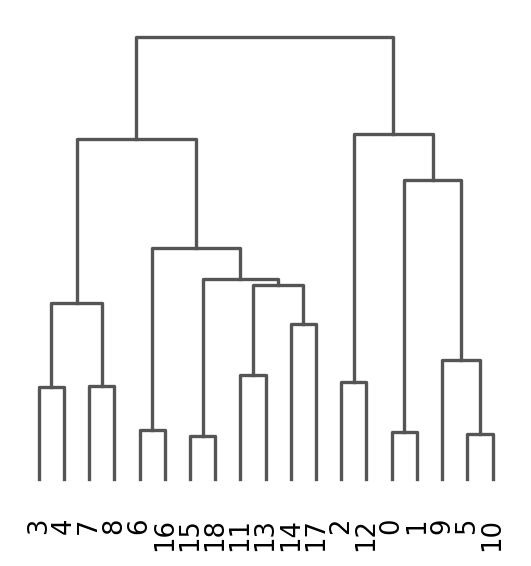

<AxesSubplot:>

In [12]:
sc.tl.dendrogram(tissue, groupby = 'leiden')
sc.pl.dendrogram(tissue, groupby = 'leiden')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: 6


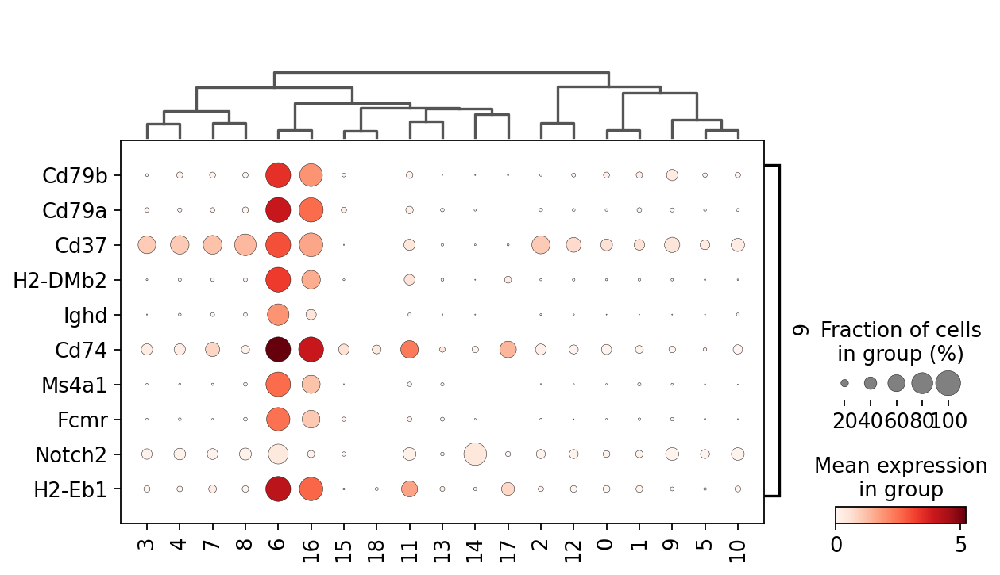

In [5]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['6'], reference='16', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)



ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
categories: 0, 1, 2, etc.
var_group_labels: 16


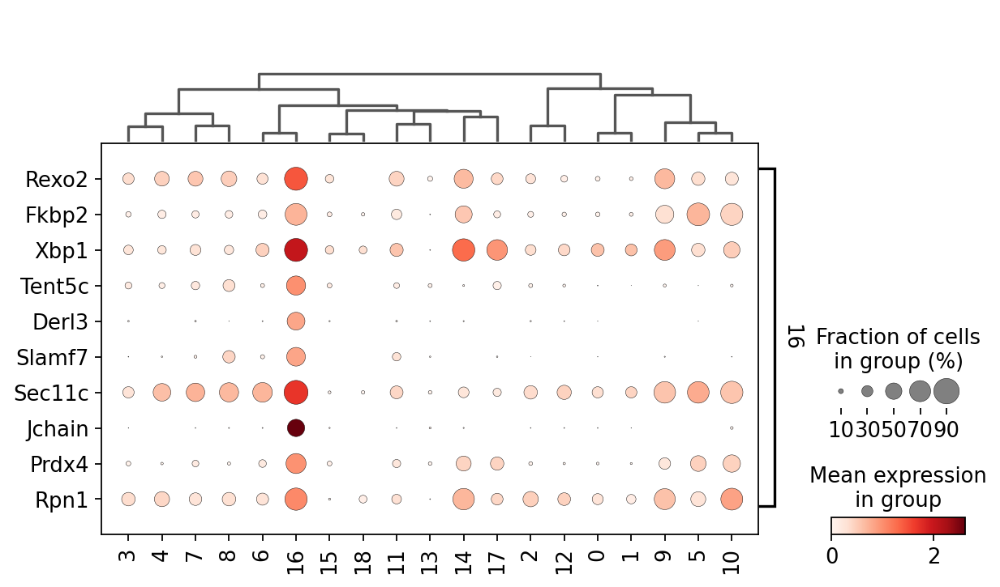

In [6]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['16'], reference='6', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)


### leiden 14/fibroblast sanity check

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:14)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: 14


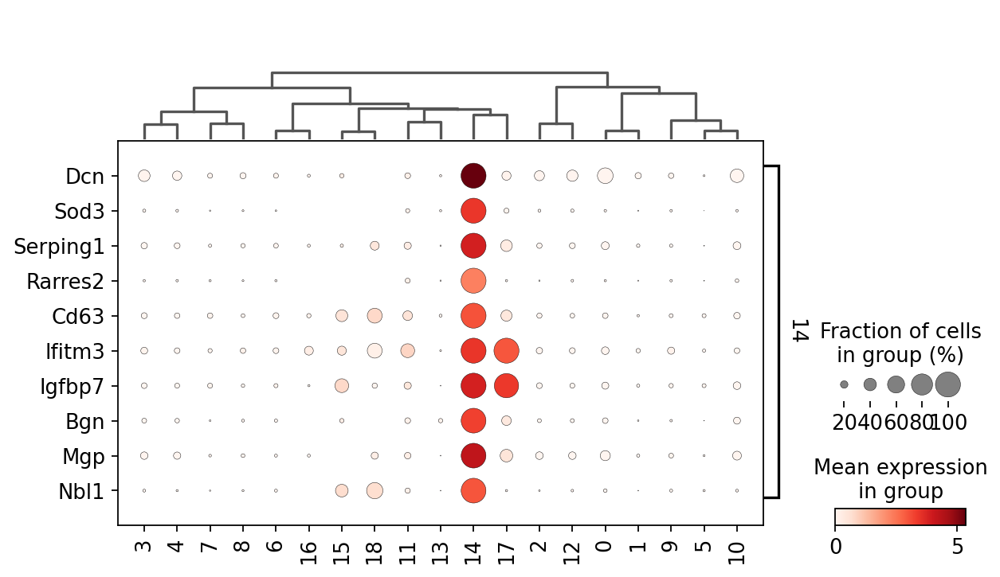

In [43]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['14'], method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)


### leiden 6, 16 vs rest

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 3, max_out_group_fraction: 0.5


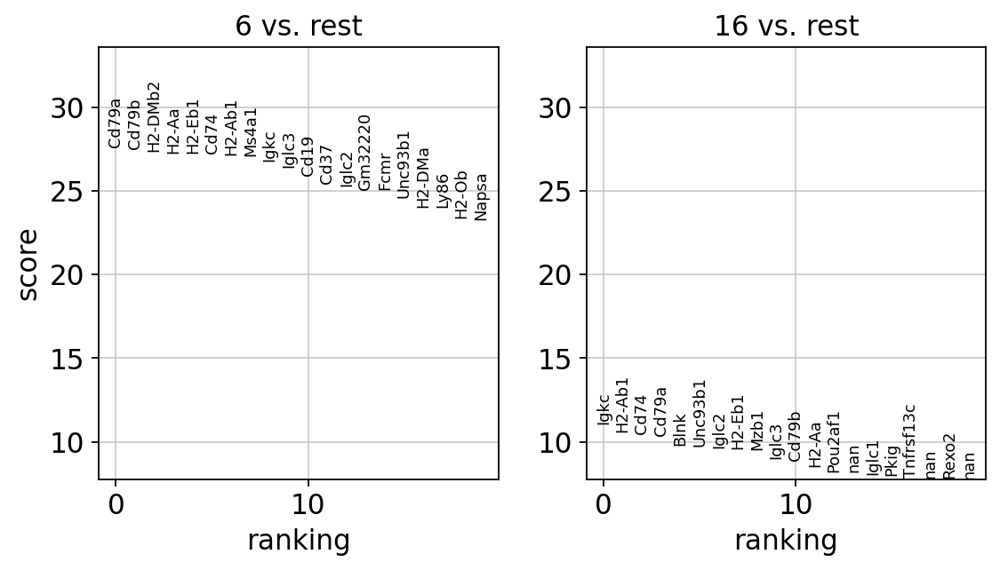

categories: 0, 1, 2, etc.
var_group_labels: 6, 16


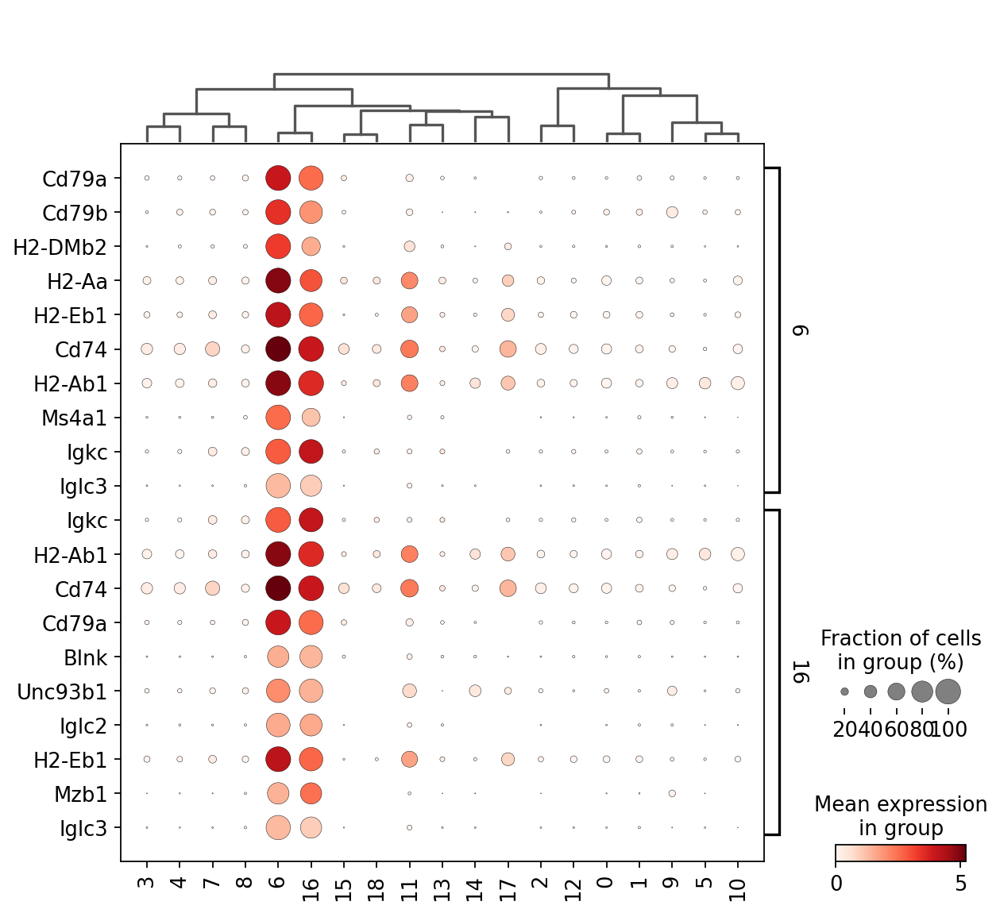

In [7]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['6','16'], method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=3)
sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)

### all leiden vs rest

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:19)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 3, max_out_group_fraction: 0.5


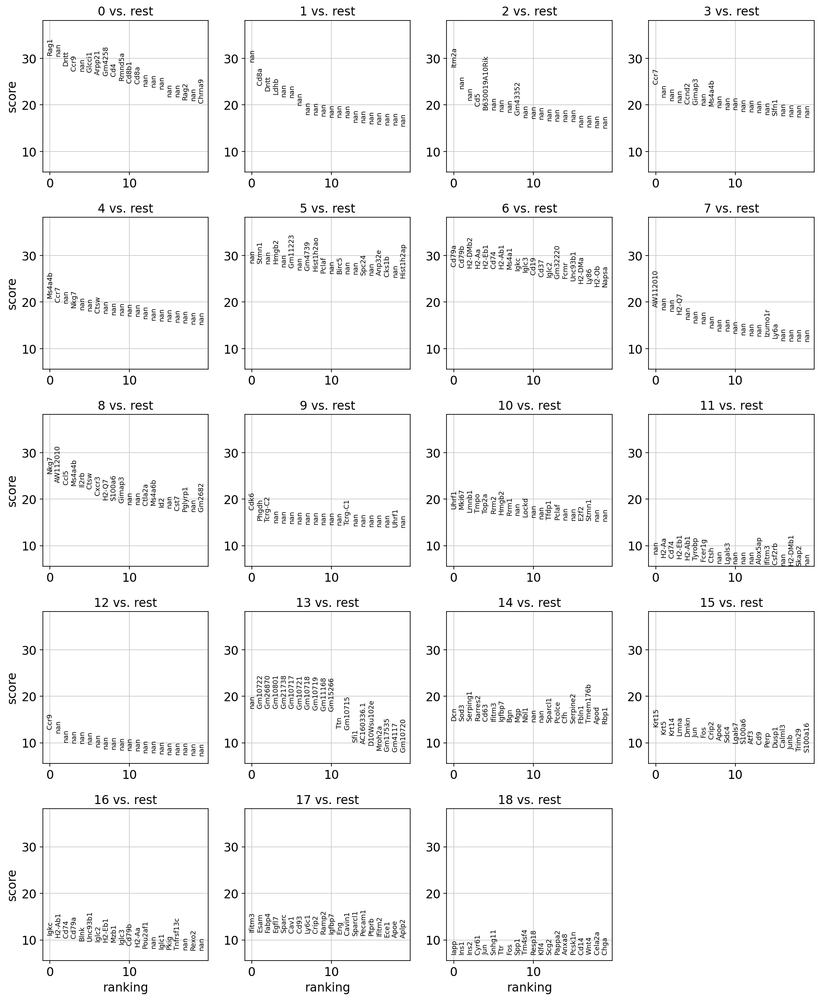

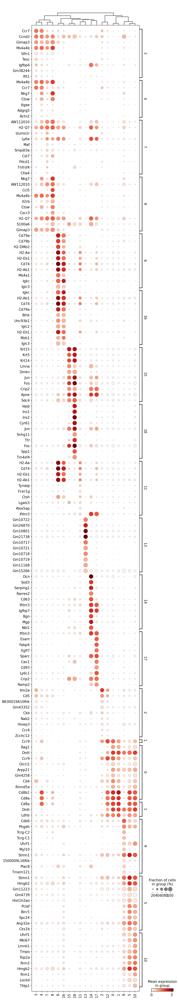

In [13]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=3)
sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)

In [ ]:
sc.pl.dotplot(tissue, IFN, groupby='leiden', dendrogram=True, swap_axes=True)

In [ ]:
sc.pl.dotplot(tissue, Chemokines, groupby='leiden', dendrogram=True, swap_axes=True)

In [ ]:
sc.pl.dotplot(tissue, M1, groupby='leiden', dendrogram=True, swap_axes=True)

In [ ]:
sc.pl.dotplot(tissue, M1_short, groupby='leiden', dendrogram=True, swap_axes=True)

In [ ]:
sc.pl.dotplot(tissue, M2_short, groupby='leiden', dendrogram=True, swap_axes=True)

In [ ]:
sc.pl.dotplot(tissue, M2, groupby='leiden', dendrogram=True, swap_axes=True)

In [ ]:
sc.pl.dotplot(tissue, M1_down, groupby='leiden', dendrogram=True, swap_axes=True)

In [ ]:
sc.pl.dotplot(tissue, M2_down, groupby='leiden', dendrogram=True, swap_axes=True)

## Heart

* 'No genes found for group 8' where group 8 appears to be where the macrophages are :(
* Group 18 = B cells
* Group 4, 9 = monocyte 
* Group 9 has classical monocyte marker Ctss

In [89]:
a = tissue_heart[tissue_heart.obs['leiden']=='8']


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:42)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 3, max_out_group_fraction: 0.5


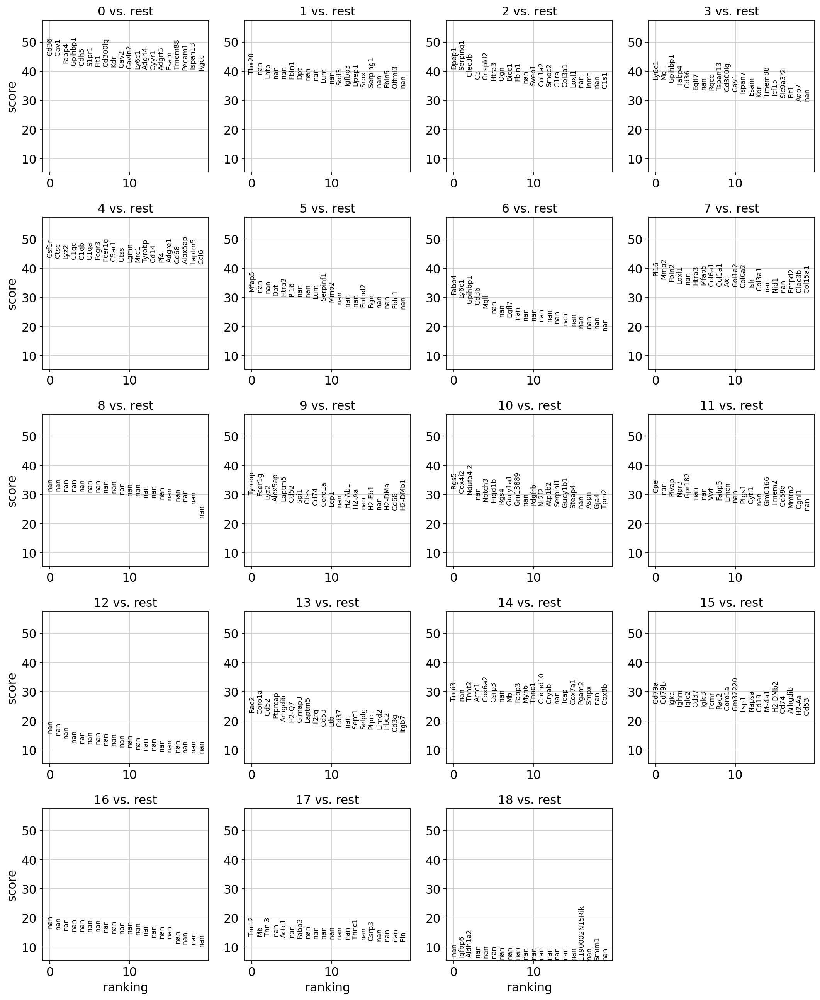

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: 0, 1, 2, etc.


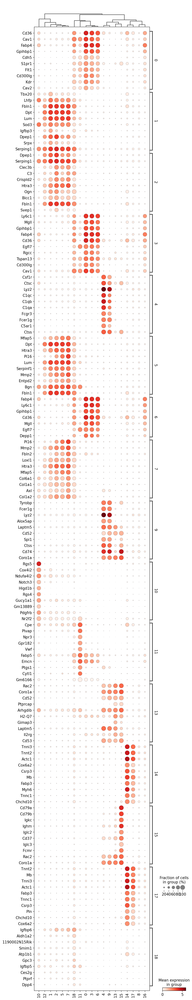

In [37]:
sc.tl.rank_genes_groups(tissue_heart, groupby = 'leiden', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue_heart, min_fold_change=3)
sc.pl.rank_genes_groups(tissue_heart, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue_heart, key='rank_genes_groups_filtered', swap_axes=True)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


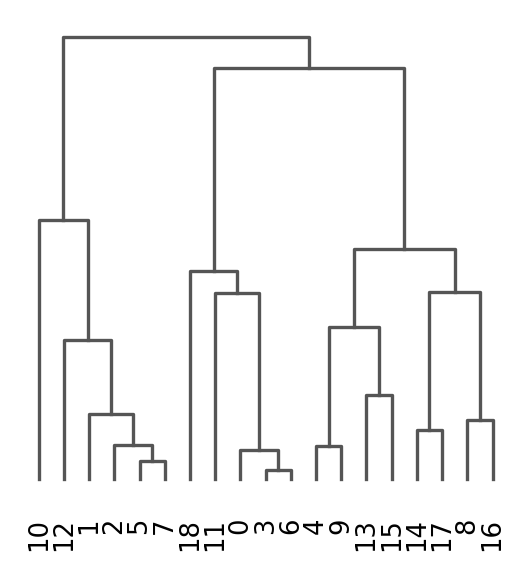

<AxesSubplot:>

In [91]:
sc.tl.dendrogram(tissue_heart, groupby = 'leiden')
sc.pl.dendrogram(tissue_heart, groupby = 'leiden')

## leiden 8 w/respect to 18 (macrophage vs B cell)

Group 8 / Heart macrophages
* Myl2 is highly expressed in Cardiomyocytes.
* Mitochondrial gene mt-Nd4l
* Several predicted genes (GM#####)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
categories: 0, 1, 2, etc.
var_group_labels: 8


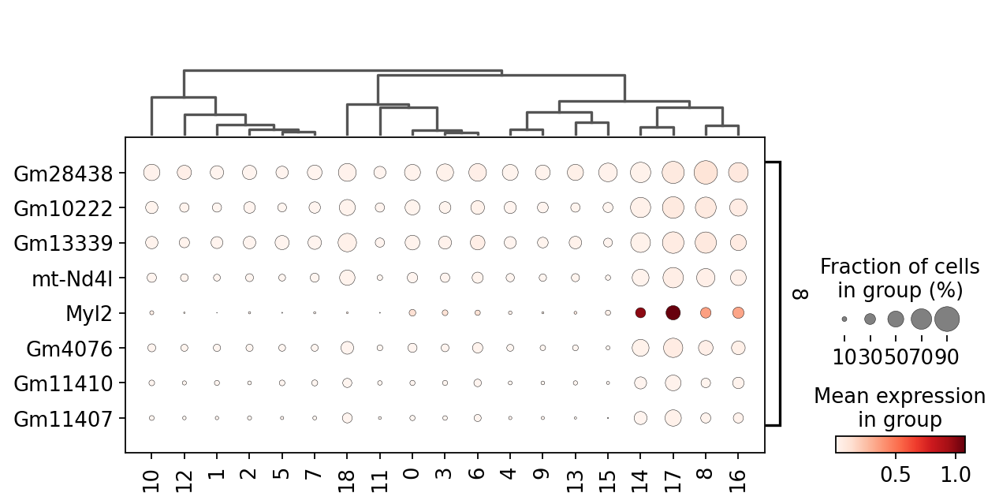

In [93]:
sc.tl.rank_genes_groups(tissue_heart, groupby = 'leiden', groups = ['8'], reference='18', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue_heart, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue_heart, key='rank_genes_groups_filtered', swap_axes=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:25)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
categories: 0, 1, 2, etc.
var_group_labels: 8


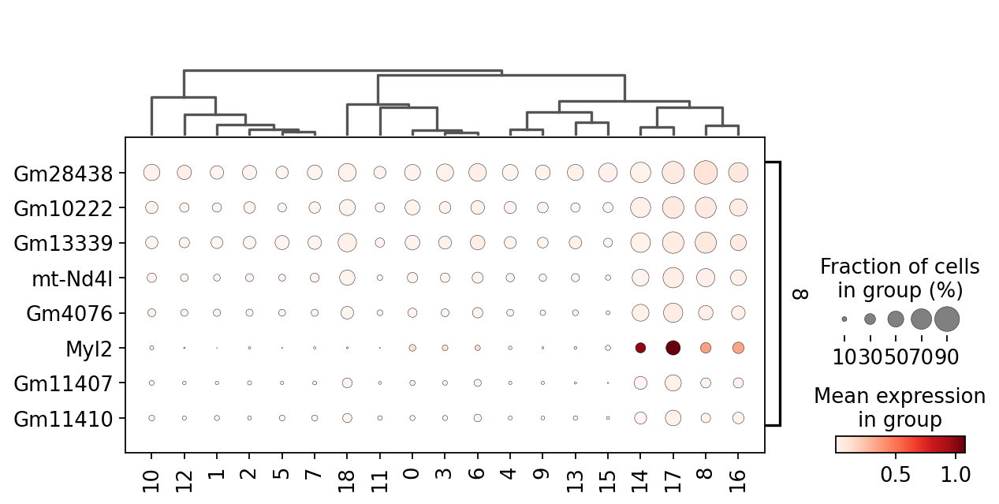

In [107]:
sc.tl.rank_genes_groups(tissue_heart, groupby = 'leiden', groups = ['8'], reference = 'rest', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue_heart, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue_heart, key='rank_genes_groups_filtered', swap_axes=True)

## MAT

leiden 6,17 = macrophages

leiden 0,8 = B cells

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:13)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 3, max_out_group_fraction: 0.5


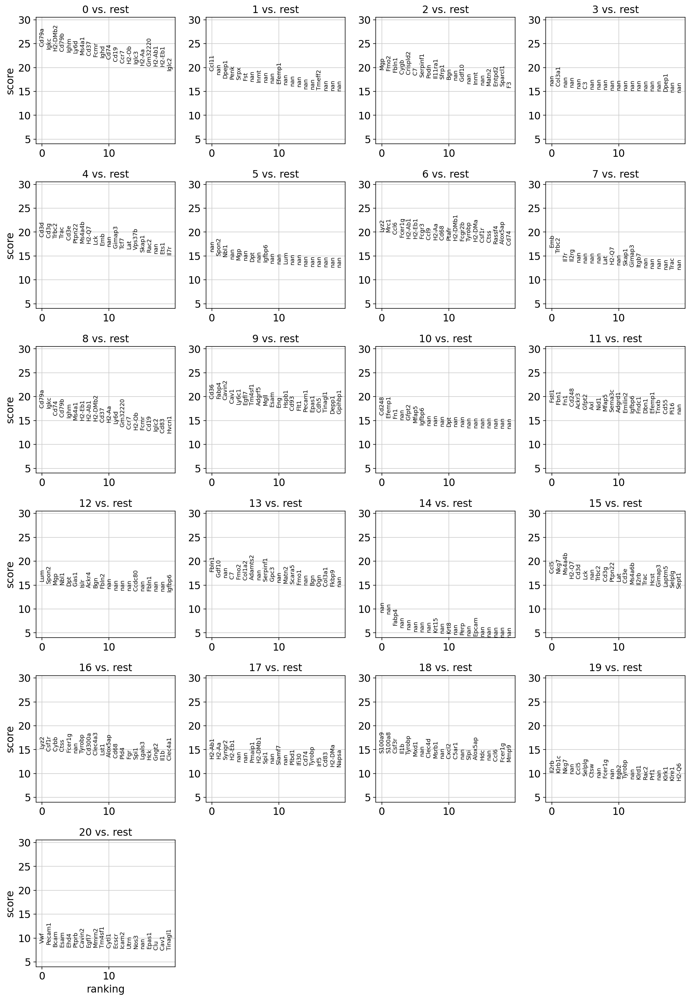

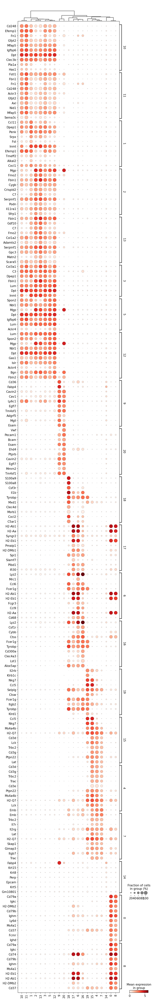

In [98]:
sc.tl.rank_genes_groups(tissue_mat, groupby = 'leiden', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue_mat, min_fold_change=3)
sc.pl.rank_genes_groups(tissue_mat, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue_mat, key='rank_genes_groups_filtered', swap_axes=True)

### leiden 6,17 (macrophage) vs rest

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
categories: 0, 1, 2, etc.
var_group_labels: 6, 17


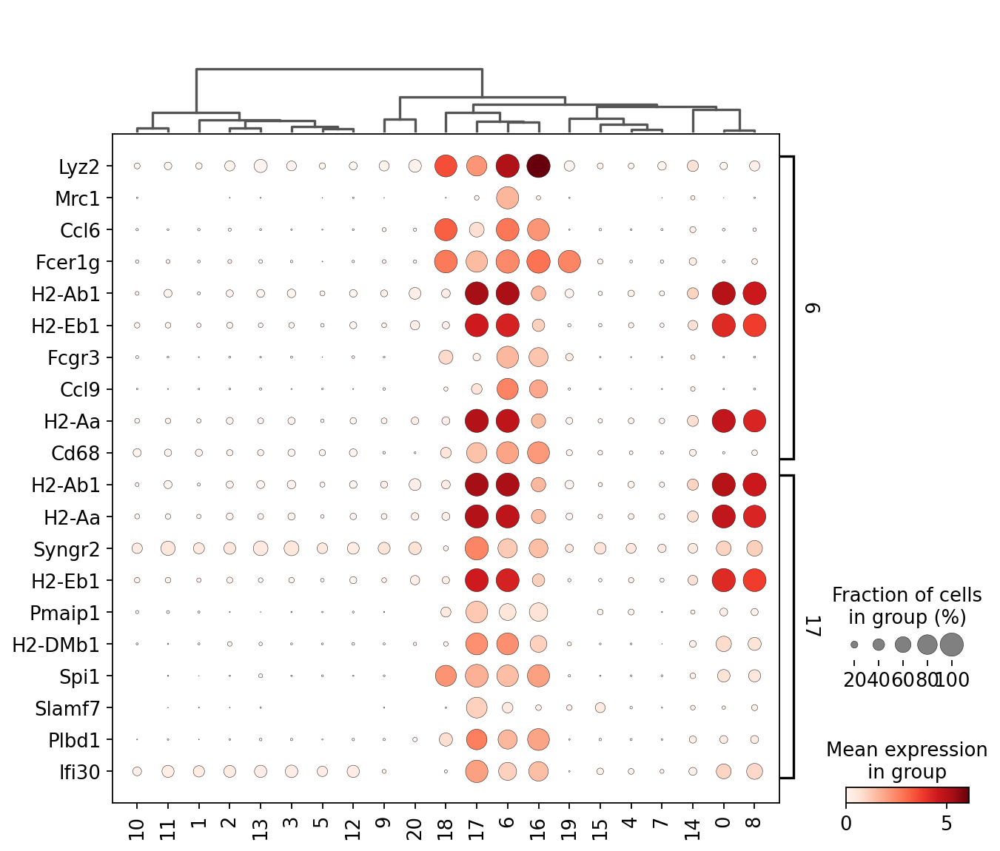

In [108]:
sc.tl.rank_genes_groups(tissue_mat, groupby = 'leiden', groups = ['6','17'], method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue_mat, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue_mat, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue_mat, key='rank_genes_groups_filtered', swap_axes=True)


### leiden 0,8 (B cells) vs rest

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
categories: 0, 1, 2, etc.
var_group_labels: 0, 8


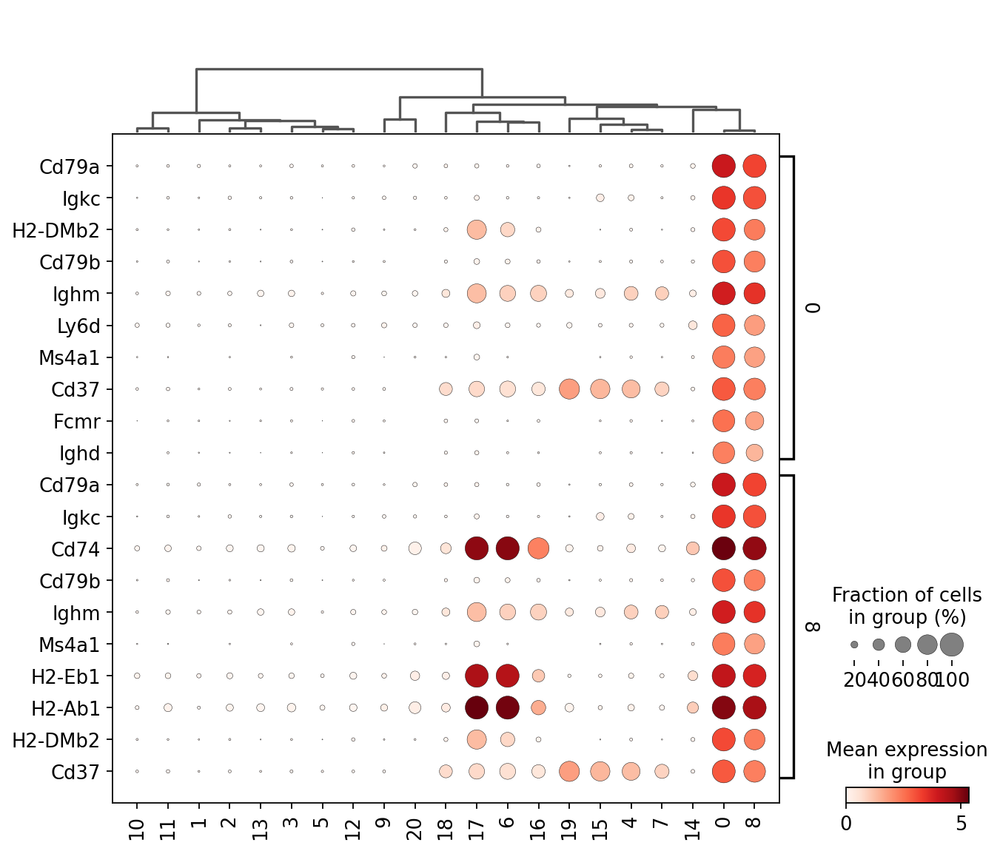

In [109]:
sc.tl.rank_genes_groups(tissue_mat, groupby = 'leiden', groups = ['0','8'], method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue_mat, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue_mat, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue_mat, key='rank_genes_groups_filtered', swap_axes=True)


### leiden 6, 17 (macrophage)  w/ref to 0 (B cell)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
categories: 0, 1, 2, etc.
var_group_labels: 6, 17


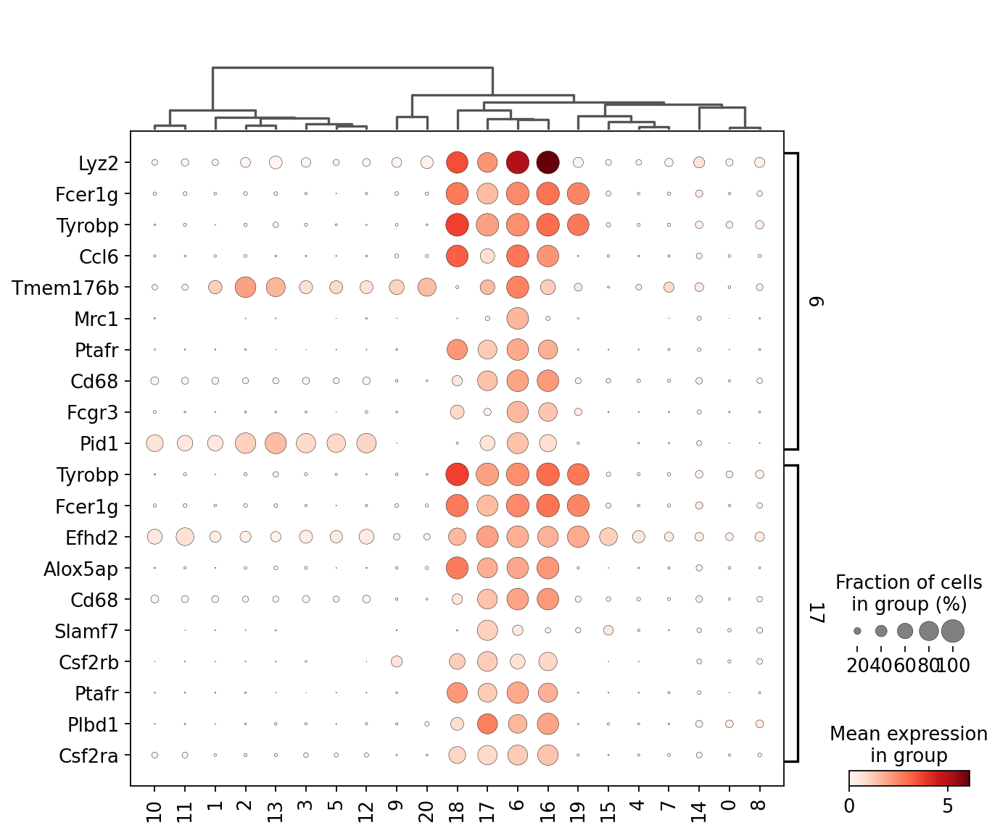

In [111]:
sc.tl.rank_genes_groups(tissue_mat, groupby = 'leiden', groups = ['6','17'], reference = '0', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue_mat, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue_mat, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue_mat, key='rank_genes_groups_filtered', swap_axes=True)

### leiden 6, 17 (macrophage)  w/ref to 8 (B cell)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5
categories: 0, 1, 2, etc.
var_group_labels: 6, 17


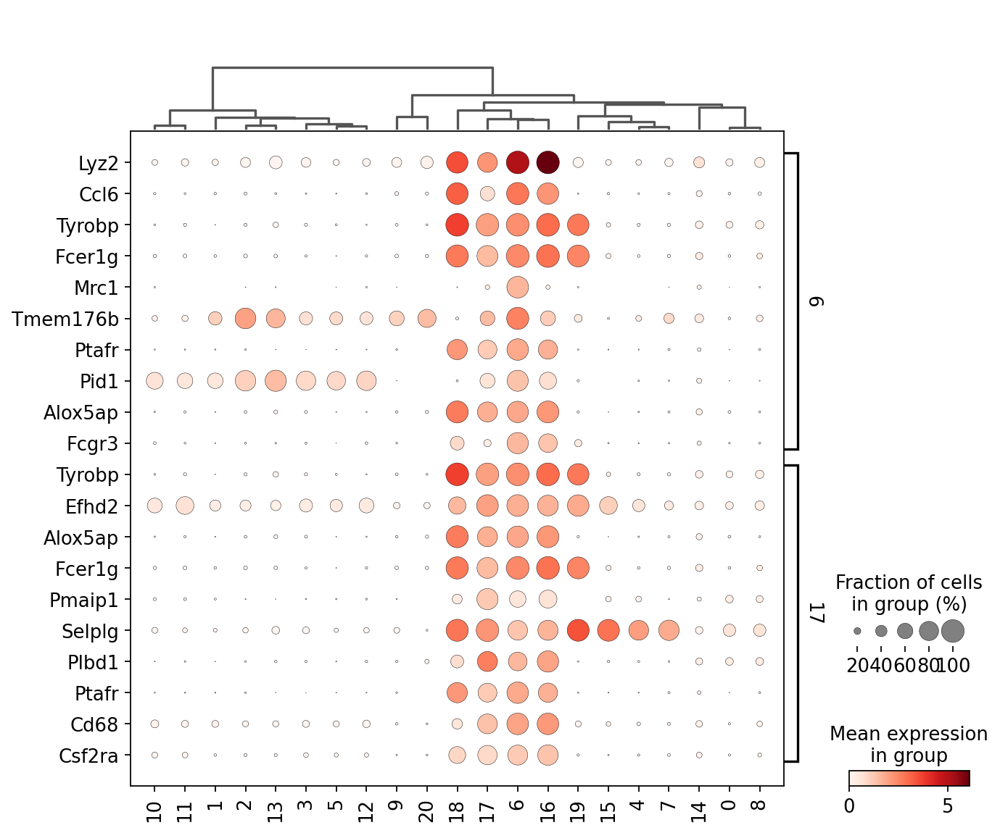

In [112]:
sc.tl.rank_genes_groups(tissue_mat, groupby = 'leiden', groups = ['6','17'], reference = '8', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue_mat, min_fold_change=2)
#sc.pl.rank_genes_groups(tissue_mat, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue_mat, key='rank_genes_groups_filtered', swap_axes=True)

# Characterize cell proportions across ages

In [129]:
from collections import defaultdict

def cell_per_tissue(celltypelist, adata):
    ''' Input is cell type list. Output is a pandas DataFrame 
    of the percentage of that cell type for inputted subsetted adata tissue object'''
    
    data = defaultdict(list)
    
    for a in ages:
        b = adata[adata.obs['age']== a]#filter by age
        for e in celltypelist:#going through keys/tissue types       
            c = b[b.obs['cell_ontology_class']== e]#have adata filtered by cell types in list
            tissue_cell_count = adata.n_obs
            data["Age"].append(a)
            data["Cell Type"].append(e)
            data["Cell Count"].append(c.n_obs)
            data["Cell Type/Tissue %"].append((c.n_obs/b.n_obs)*100)
            
    df = pd.DataFrame(data)
    return df

[Text(0.5, 1.0, 'Cell Type % of Thymus')]

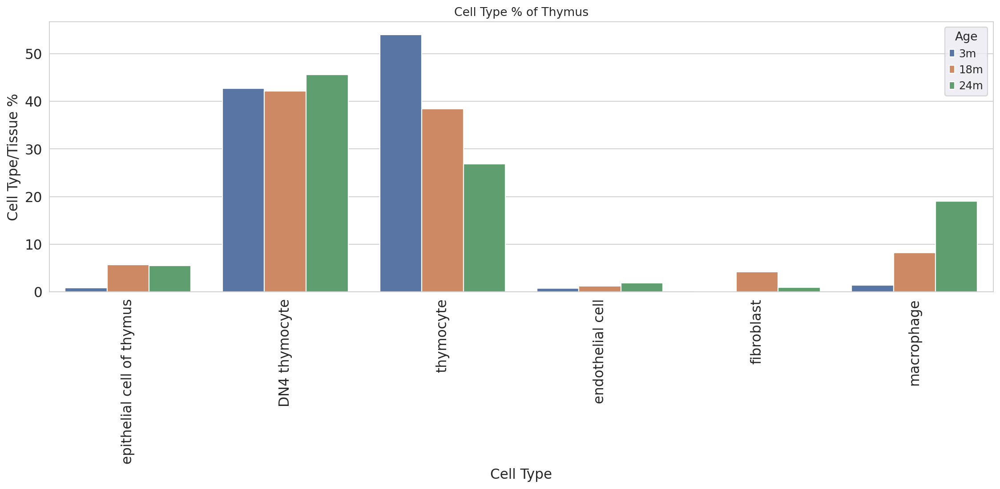

In [130]:
df = cell_per_tissue(tis_cells,tissue)

sns.set_style('whitegrid')
fig = plt.figure(figsize=(17, 5))
plt.xticks(rotation=90)
sns.set(font_scale =1)
sns.barplot(data=df, y="Cell Type/Tissue %", x="Cell Type", hue = "Age").set(title="Cell Type % of Thymus")

In [131]:
mouse_ids = list(set(tissue.obs['mouse.id']))

In [132]:
from collections import defaultdict

def cell_per_tissue2(a_list, adata):
    ''' Input is list and adata tissue object. Output is a pandas DataFrame 
    of the percentage of that cell type for inputted subsetted adata tissue object'''
    
    data = defaultdict(list)
    
    for a in a_list:
        b = adata[adata.obs['mouse.id']== a]#filter by mouse
        for c in tis_cells:       
            d = b[b.obs['cell_ontology_class']== c]#have adata filtered by cell types in list
            tissue_cell_count = b.n_obs
            
            data["mouse.id"].append(a)
            data["Cell Type"].append(c)
            data["Cell Count"].append(d.n_obs)
            data["Cell Type/Tissue %"].append((d.n_obs/b.n_obs)*100)
            
    df = pd.DataFrame(data)
    return df

In [133]:
df2=cell_per_tissue2(mouse_ids,tissue)

In [134]:
df2.groupby(["mouse.id"])[["Cell Type/Tissue %"]].sum()#don't think i need
dd = df2.groupby(["mouse.id", "Cell Type"]).sum()

In [135]:
dd = dd.reset_index('Cell Type')

Pivoting pandas DataFrame so that Cell Type column values becomes columns, and Cell Type/Tissue % populate new columns.

In [136]:
tmp = dd.pivot_table(values='Cell Type/Tissue %', columns="Cell Type", index=dd.index)

Reordering mouse.id X axis

In [137]:
mouse_id_order = [
    '3_8_M', 
    '3_9_M',
    '3_11_M', 
    '3_38_F', 
    '3_39_F', 
    '18_45_M', 
    '18_46_F', 
    '18_47_F', 
    '18_53_M', 
    '24_58_M', 
    '24_59_M',
    '24_60_M', 
    '24_61_M', 
]

tmp = tmp.reindex(mouse_id_order)

**Cell Type % of Thymus per Mouse**

<ipython-input-138-1a8c41979784>:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = plt.axes()


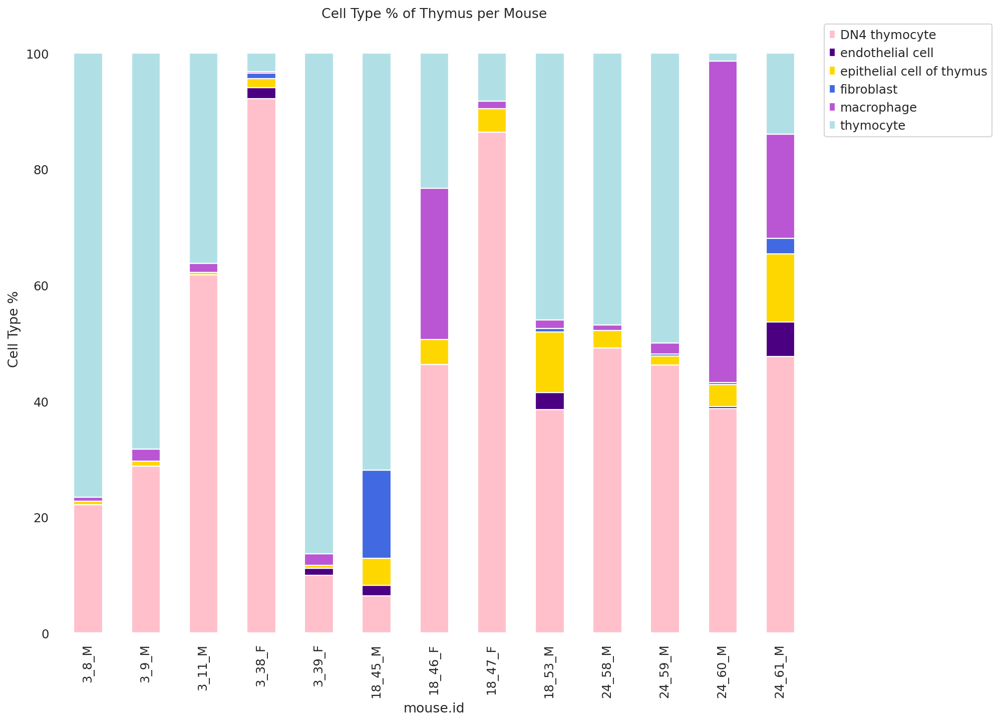

In [138]:
tmp.plot(kind='bar', stacked=True, figsize=(12, 10), color = ['pink','indigo','gold','royalblue','mediumorchid','powderblue'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, facecolor = 'white')
plt.title("Cell Type % of Thymus per Mouse")
plt.ylabel('Cell Type %')
ax = plt.axes()
ax.set_facecolor("white")


**Cell Type % of Thymus by Age**

In [139]:
from collections import defaultdict

def cell_per_age(a_list, adata):
    ''' Input is list and adata tissue object. Output is a pandas DataFrame 
    of the percentage of that cell type by age for inputted subsetted adata tissue object'''
    
    data = defaultdict(list)
    
    for a in a_list:
        b = adata[adata.obs['age']== a]#filter by age
        for c in tis_cells:       
            d = b[b.obs['cell_ontology_class']== c]#have adata filtered by cell types in list
            tissue_cell_count = b.n_obs
            
            data["age"].append(a)
            data["Cell Type"].append(c)
            #data["Cell Count"].append(d.n_obs)
            data["Cell Type/Tissue %"].append((d.n_obs/b.n_obs)*100)
            
    df = pd.DataFrame(data)
    return df

In [140]:
ac = cell_per_age(ages,tissue)

In [141]:
ad = ac.groupby(["age", "Cell Type"]).sum()

In [142]:
ad = ad.reset_index('Cell Type')

In [143]:
ae = ad.pivot_table(values='Cell Type/Tissue %', columns="Cell Type", index=ad.index)
ae = ae.reindex(ages)

<ipython-input-144-8b10e0581ed1>:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = plt.axes()


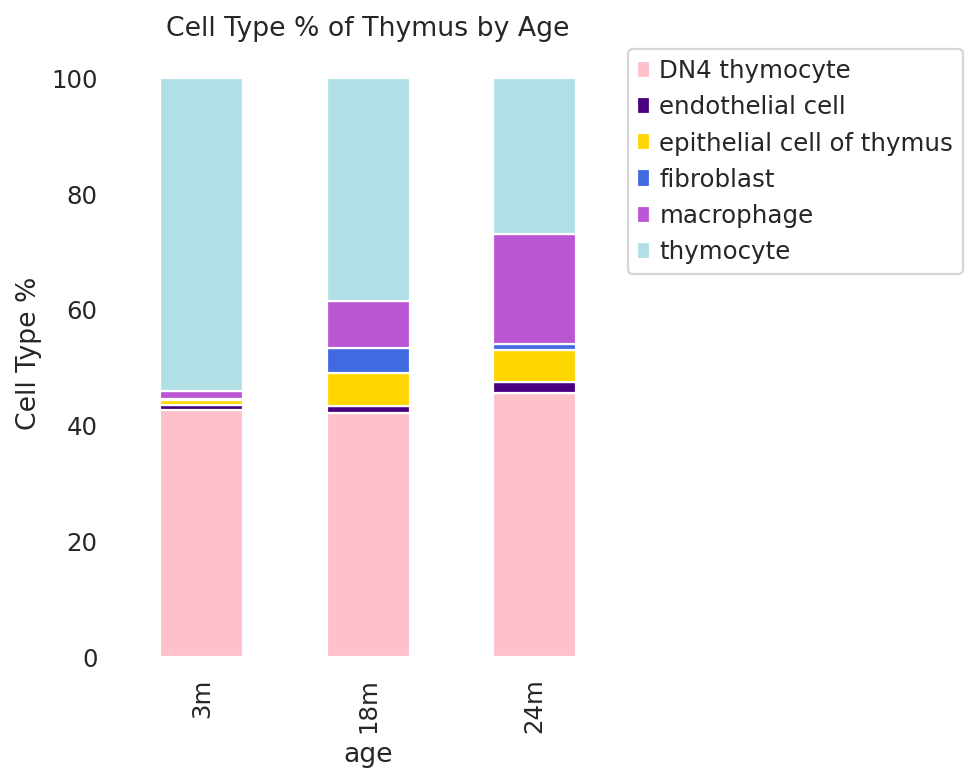

In [144]:
ae.plot(kind='bar', stacked=True, figsize=(4, 5), color = ['pink','indigo','gold','royalblue','mediumorchid','powderblue'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, facecolor = 'white')
plt.title("Cell Type % of Thymus by Age")
plt.ylabel('Cell Type %')
ax = plt.axes()
ax.set_facecolor("white")

**Variance of Cell Type % of Thymus across Age**

* I'd like to break apart the macrophage cluster (shows two leiden clusters) into two categories and plot

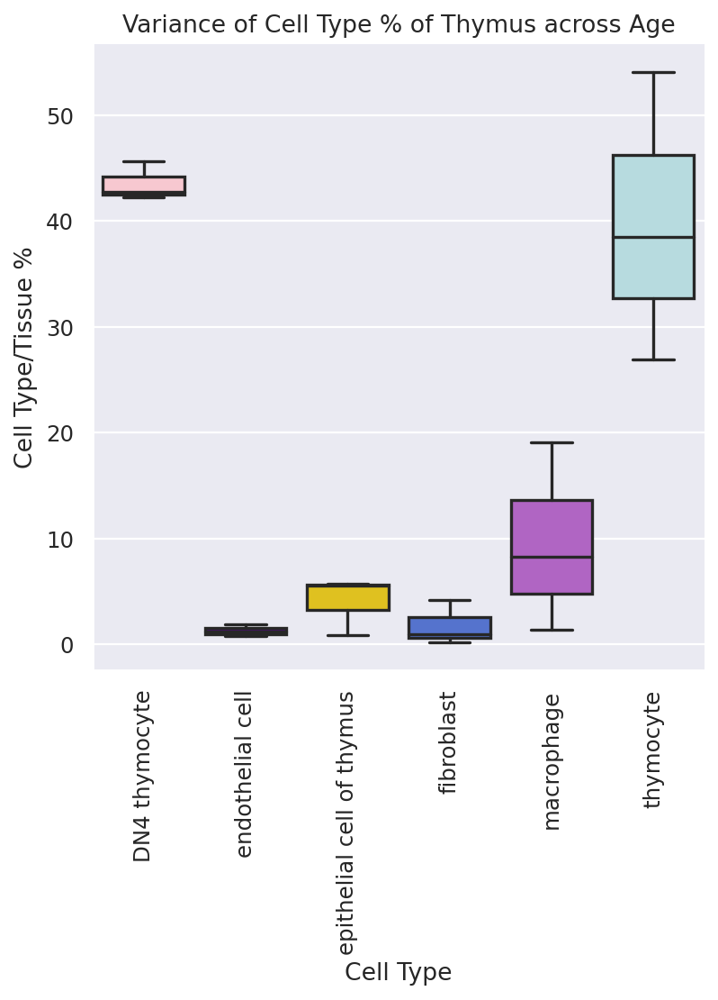

In [145]:
sns.catplot(data = ad, x = 'Cell Type', y = 'Cell Type/Tissue %', kind = "box", palette=sns.color_palette(['pink','indigo','gold','royalblue','mediumorchid','powderblue']))
plt.title("Variance of Cell Type % of Thymus across Age")
sns.set_style("whitegrid")
plt.xticks(rotation=90);


In [146]:
#Angela's to remove 0's from dataframe below

def remove_cats(adata):

    cat_columns = adata.obs.select_dtypes(['category']).columns
    adata.obs[cat_columns] = adata.obs[cat_columns].astype(str)
    
    return adata

In [147]:
tissue = remove_cats(tissue)

In [148]:
'''Angela showing me some pandas tricks and suggestions'''

pd.DataFrame(tissue.obs.groupby(["age",'mouse.id', 'cell_ontology_class']).agg({"mouse.id":[len]}))

mouse.id
                                            len
age mouse.id cell_ontology_class               
18m 18_45_M  DN4 thymocyte                   25
             endothelial cell                 7
             epithelial cell of thymus       18
             fibroblast                      59
             thymocyte                      279
...                                         ...
3m  3_8_M    thymocyte                      121
    3_9_M    DN4 thymocyte                   97
             epithelial cell of thymus        3
             macrophage                       7
             thymocyte                      230

[63 rows x 1 columns]

# Gene expression vars->obs & dataframe

score_genes on M1, M2 and IFN gene lists

In [ ]:
sc.tl.score_genes(tissue, M1, score_name = 'M1')
sc.tl.score_genes(tissue, M2, score_name = 'M2')
sc.tl.score_genes(tissue, IFN, score_name = 'IFN')

In [ ]:
sc.tl.score_genes(tissue, M1, score_name = 'M1_500', ctrl_size = 500)
sc.tl.score_genes(tissue, M2, score_name = 'M2_500',ctrl_size = 500)
sc.tl.score_genes(tissue, IFN, score_name = 'IFN_500', ctrl_size = 500)

In [ ]:
sc.tl.score_genes(tissue, M1, score_name = 'M1_175', ctrl_size = 175)
sc.tl.score_genes(tissue, M2, score_name = 'M2_169',ctrl_size = 169)
sc.tl.score_genes(tissue, IFN, score_name = 'IFN_150', ctrl_size = 150)

In [152]:
sc.tl.score_genes(tissue, bcr, score_name = 'BCR')

computing score 'BCR'
    finished: added
    'BCR', score of gene set (adata.obs).
    249 total control genes are used. (0:00:00)


To add var gene expression to obs

In [153]:
def gene_expression_obs(adata, listy):
    '''Takes adata object. 
    Returns adata copy with var genes where genes 
    and their expression values are columns in dataframe of adata.'''
    adata2 = adata.copy()
    
    for j in listy:#list(adata2.var.index): took hours & didn't finish
        adata2.obs[j] = adata2[:,j].X.toarray().flatten()
    
    return adata2

To make dataframe from obs gene expression adata

In [154]:
def gene_expression_df(adata, genelist):
    '''Takes adata object and a list of genes. 
    Returns a pandas dataframe where genes and their expression values are columns in dataframe of adata.'''
    df = adata.obs.copy()
    
    for g in genelist:
        df[g] = tissue[:,g].X.toarray().flatten()
    return df   

Removing genes from MitoCarta gene list that are not in .vars

In [155]:
genes = list(mt_nc.copy())

for i in range(len(ignored)):
    for i in ignored:
        if i in genes:
            genes.remove(i) 

In [156]:
'''Checking for duplicate genes'''
dupe_genes = []
for g in genes:
    count = genes.count(g)
    if count > 1:
        dupe_genes.append(g)
print(f'There are {len(dupe_genes)} duplicate genes in genes list')

There are 0 duplicate genes in genes list


In [157]:
'''Checking that all MT genes are in genes (mt_nc) list'''

for m in mt_genes:
    if m in genes:
        print(m,'yes')
    else:
        print(m, 'no') 

mt-Atp6 yes
mt-Atp8 yes
mt-Co1 yes
mt-Co2 yes
mt-Co3 yes
mt-Cytb yes
mt-Nd1 yes
mt-Nd2 yes
mt-Nd3 yes
mt-Nd4 yes
mt-Nd4l yes
mt-Nd5 yes
mt-Nd6 yes
mt-Rnr1 yes
mt-Rnr2 yes
mt-Ta yes
mt-Te yes
mt-Tf yes
mt-Ti yes
mt-Tl1 yes
mt-Tl2 yes
mt-Tm yes
mt-Tp yes
mt-Tq yes
mt-Tt yes
mt-Tv yes


**DataFrames**

In [ ]:
#may be too large?

#df_nc_mt = gene_expression_df(tissue_sg1,list(tissue_sg1.var.index))

In [ ]:
#tissue_obs = gene_expression_obs(tissue, list(tissue.var.index)) has ALL genes but running for hoooours
#need to figure out how to save it

In [ ]:
#adata has mitochondria and nuclear-encoded mitochondria (MitoCarta3.0) gene expressions in obs
tissue2 = gene_expression_obs(tissue, genes)

In [161]:
#has IFN genes from IFN gene list in obs
tissueI = gene_expression_obs(tissue, IFN)

In [ ]:
#df has mitochondria and nuclear-encoded mitochondria (MitoCarta3.0) gene expressions
tissue3 = gene_expression_df(tissue2, genes)

In [162]:
#df has IFN genes from IFN gene list
tissueIFN = gene_expression_df(tissueI, IFN)

In [ ]:
#df has M1 and M2 genes from M1 and M2 gene lists in obs
tissue_M = gene_expression_df(tissue, M)

In [ ]:
#df has Chemokine genes from Chemokine gene list
tissueChemokines = gene_expression_df(tissue, Chemokines)

In [158]:
#df has BCR genes
tissueBCR = gene_expression_df(tissue, bcr)

In [226]:
j = ['Jchain', 'Ighg2b']
jchain_thymus = gene_expression_obs(tissue, j)
df_thy = gene_expression_df(jchain_thymus, j)

## leiden cluster breakdown

Only the clusters that have annotated macrophages present

In [ ]:
leiden0 = tissue[tissue.obs['leiden']=='0']
l = pd.crosstab(leiden0.obs['cell_ontology_class'],leiden0.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden1 = tissue[tissue.obs['leiden']=='1']
l = pd.crosstab(leiden1.obs['cell_ontology_class'],leiden1.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden3 = tissue[tissue.obs['leiden']=='3']
l = pd.crosstab(leiden3.obs['cell_ontology_class'],leiden3.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden5 = tissue[tissue.obs['leiden']=='5']
l = pd.crosstab(leiden5.obs['cell_ontology_class'],leiden5.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden6 = tissue[tissue.obs['leiden']=='6']
l = pd.crosstab(leiden6.obs['cell_ontology_class'],leiden6.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden7 = tissue[tissue.obs['leiden']=='7']
l = pd.crosstab(leiden7.obs['cell_ontology_class'],leiden7.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden11 = tissue[tissue.obs['leiden']=='11']
l = pd.crosstab(leiden11.obs['cell_ontology_class'],leiden11.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden16 = tissue[tissue.obs['leiden']=='16']
l = pd.crosstab(leiden16.obs['cell_ontology_class'],leiden16.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
m = tissue[tissue.obs['cell_ontology_class']=='macrophage']
mp = pd.crosstab(m.obs['leiden'],m.obs['age'], normalize='index')
mp.plot.bar(stacked=True).legend(loc='upper right')

In [ ]:
tmp = pd.crosstab(tissue.obs['leiden'],tissue.obs['cell_ontology_class'], normalize='index')
tmp.plot.bar(stacked=True).legend(loc='upper left')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

# MT and MitoCarta score_genes

**Save MT score_genes result** (unhash if doing for the first time)

* score_genes_cell_cycle(adata, s_genes, g2m_genes)
* mt_genes -> s_genes
* mt_nc_genes -> g2m_genes

A function to make a dataframe of gene_scores and gene expression score by cell

In [177]:
def cell_gene_exp_df(adata, gene):
    ''' Input is gene name that has an obs.gene_score. 
    Output is a pandas DataFrame with two columns: cell index and gene's gene_score'''
    
    data = defaultdict(list)
    
    for d in list(adata.obs['cell']):
        data["Cell"].append(d)
        
        cg = adata[adata.obs.cell == d, adata.var.index == gene]
        data["Gene Expression"].append(cg.X[0,0]) 
    
    #for g in list(adata.obs[gene]):
    #    data["gene_score"].append(g)
       
    df = pd.DataFrame(data)
    return df

In [ ]:
#tissue_score_genes = sc.tl.score_genes_cell_cycle(tissue, mt_genes, mt_nc_genes, copy = True)

In [ ]:
tissue_score_genes_path = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/tissue_sg1_02172022.h5ad"
#tissue_sg1.write(tissue_score_genes_path)
tissue_sg1 = sc.read_h5ad(tissue_score_genes_path)

In [ ]:
tissue_sg1.obs[['age','cell_ontology_class','S_score','G2M_score']]

**Check this out!**  

tissue_sg1 is after using it. sc.tl.score_genes_cell_cycle seems to change the Gene Expression values. 

tissue is the adata before using sc.tl.score_genes_cell_cycle.

**Before going through sc.tl.score_genes_cell_cycle there aren't negative gene expression values.**

In [ ]:
cell_gene_exp_df('Nr4a1',tissue)

**But after going through sc.tl.score_genes_cell_cycle the values are now negative**

In [ ]:
cell_gene_exp_df('Nr4a1',tissue_sg1)

# Statistics tests on gene expression

In [ ]:
#I think I need to use a dataframe that has ALL the genes as columns, not just my genes of interest.

Need to run **7 Gene expression vars -> obs & dataframe** first

## statannot plots

### mt genes

#### mt-Atp6

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Atp6']]

x = "cell_ontology_class" 
y = "mt-Atp6" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### mt-Atp8

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Atp8']]

x = "cell_ontology_class" 
y = "mt-Atp8" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


#### mt-Co1

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Co1']]

x = "cell_ontology_class" 
y = "mt-Co1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


#### mt-Co2

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Co2']]

x = "cell_ontology_class" 
y = "mt-Co2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


#### mt-Co3

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Co3']]

x = "cell_ontology_class" 
y = "mt-Co3" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


#### mt-Cytb

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Cytb']]

x = "cell_ontology_class" 
y = "mt-Cytb" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### mt-Nd1

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Nd1']]

x = "cell_ontology_class" 
y = "mt-Nd1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### mt-Nd2

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Nd2']]

x = "cell_ontology_class" 
y = "mt-Nd2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


#### mt-Nd3

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Nd3']]

x = "cell_ontology_class" 
y = "mt-Nd3" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


#### mt-Nd4

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Nd4']]

x = "cell_ontology_class" 
y = "mt-Nd4" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


#### mt-Nd4l

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Nd4l']]

x = "cell_ontology_class" 
y = "mt-Nd4l" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


#### mt-Nd5

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Nd5']]

x = "cell_ontology_class" 
y = "mt-Nd5" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### mt-Nd6

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Nd6']]

x = "cell_ontology_class" 
y = "mt-Nd6" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### mt-Rnr1

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Rnr1']]

x = "cell_ontology_class" 
y = "mt-Rnr1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### mt-Rnr2

In [ ]:
df = tissue3[['age','cell_ontology_class','mt-Rnr2']]

x = "cell_ontology_class" 
y = "mt-Rnr2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)


### Genes and score_genes

#### BCR

No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

macrophage_3m v.s. macrophage_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.855e+03
macrophage_24m v.s. macrophage_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=9.692e-01 U_stat=1.218e+04
DN4 thymocyte_24m v.s. DN4 thymocyte_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.019e-01 U_stat=1.835e+05
endothelial cell_3m v.s. endothelial cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=8.119e-02 U_stat=4.200e+01
endothelial cell_24m v.s. endothelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.920e+02
epithelial cell of thymus_3m v.s. epithelial cell of thymus_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.

(<AxesSubplot:xlabel='cell_ontology_class', ylabel='BCR'>,
  <statannot.StatResult.StatResult at 0x7fd8ad85a8e0>])

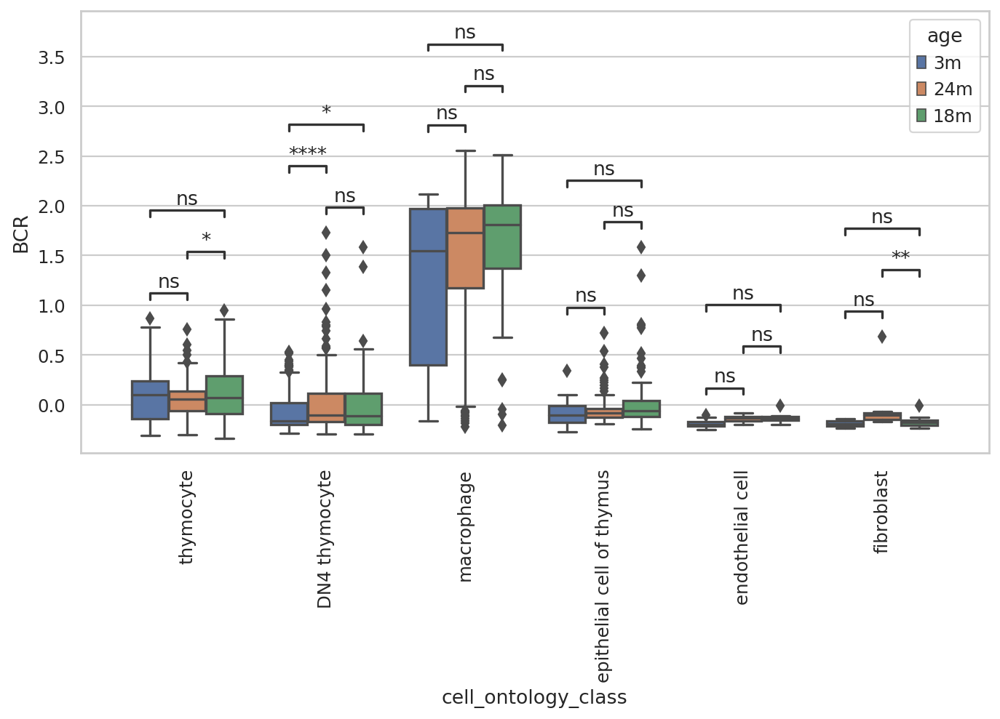

In [168]:
df = tissueBCR[['age','cell_ontology_class','BCR']]

x = "cell_ontology_class" 
y = "BCR" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

macrophage_3m v.s. macrophage_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=8.545e-01 U_stat=1.616e+03
macrophage_24m v.s. macrophage_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.031e-12 U_stat=7.328e+03
DN4 thymocyte_24m v.s. DN4 thymocyte_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.731e+05


ValueError: All numbers are identical in mannwhitneyu

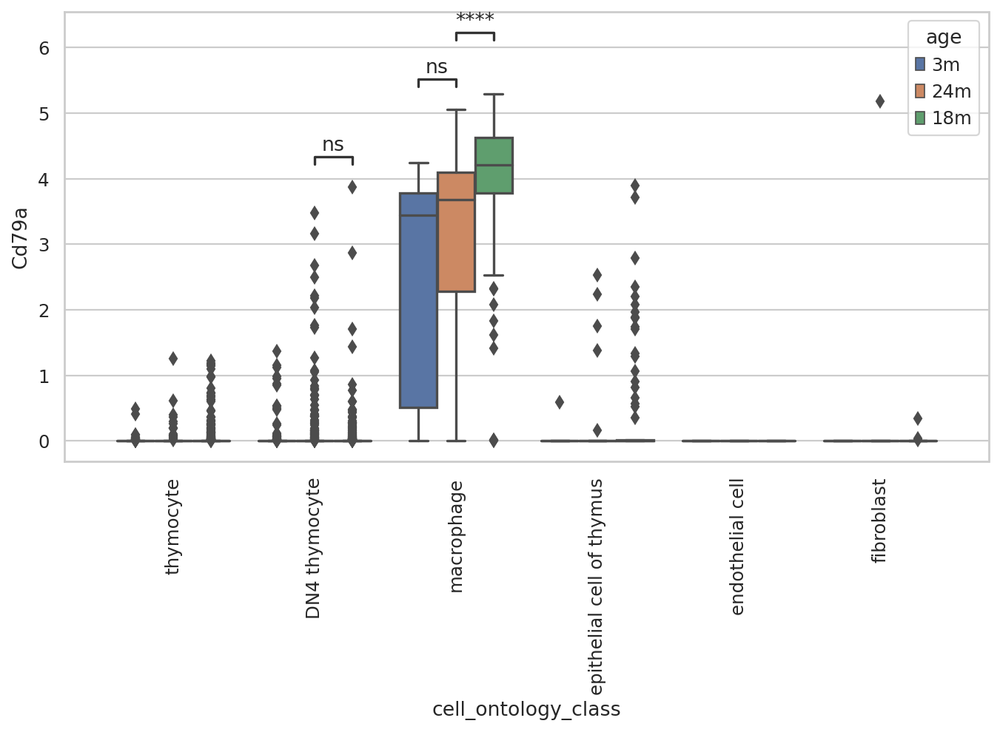

In [167]:
df = tissueBCR[['age','cell_ontology_class','Cd79a']]

x = "cell_ontology_class" 
y = "Cd79a" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Cd79a

No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

macrophage_3m v.s. macrophage_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=8.545e-01 U_stat=1.616e+03
macrophage_24m v.s. macrophage_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.031e-12 U_stat=7.328e+03
DN4 thymocyte_24m v.s. DN4 thymocyte_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.731e+05


ValueError: All numbers are identical in mannwhitneyu

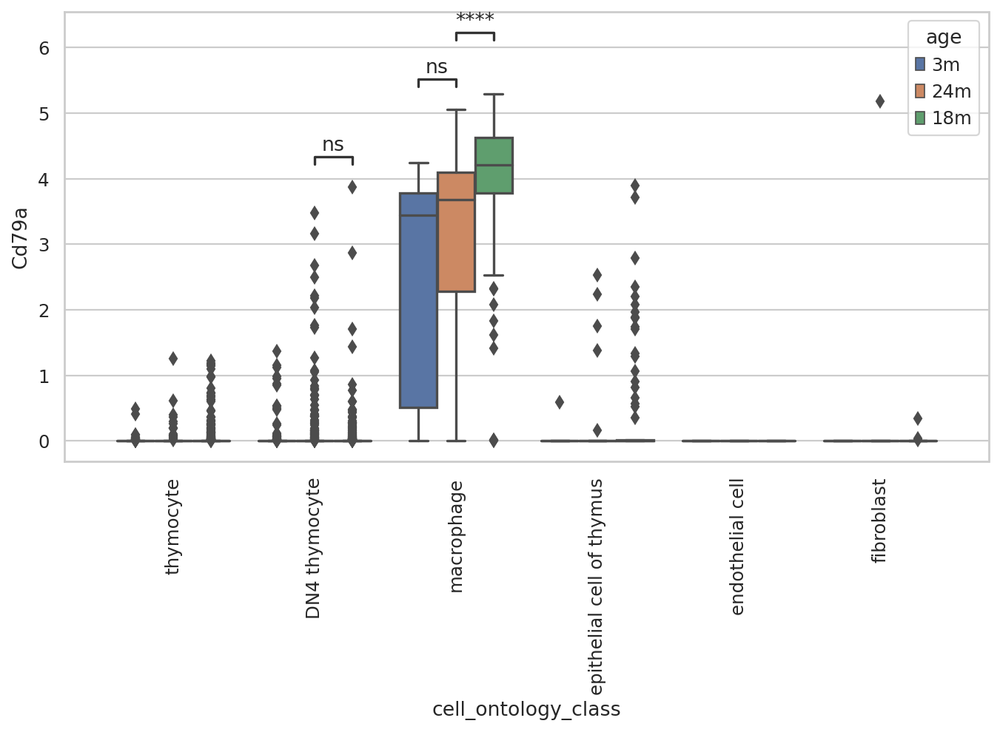

In [173]:
df = tissueBCR[['age','cell_ontology_class','Cd79a']]

x = "cell_ontology_class" 
y = "Cd79a" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Cd79b

No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

macrophage_3m v.s. macrophage_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.890e+03
macrophage_24m v.s. macrophage_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.508e-05 U_stat=9.612e+03
DN4 thymocyte_24m v.s. DN4 thymocyte_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.374e-04 U_stat=1.847e+05
endothelial cell_3m v.s. endothelial cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.265e+02


ValueError: All numbers are identical in mannwhitneyu

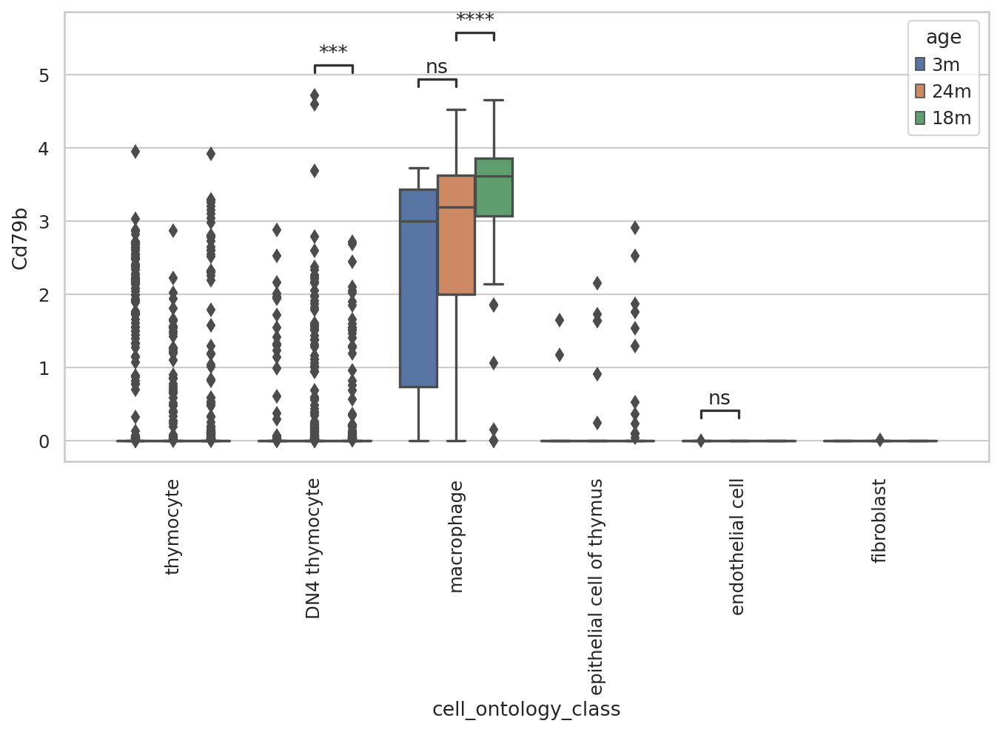

In [174]:
df = tissueBCR[['age','cell_ontology_class','Cd79b']]

x = "cell_ontology_class" 
y = "Cd79b" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Iglc1 Immunoglobulin lambda constant 1 B-cells - Adaptive immune response (mainly)

Immune cell specificity: Group enriched (naive B-cell, memory B-cell)

No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

macrophage_3m v.s. macrophage_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.440e-02 U_stat=1.387e+03
macrophage_24m v.s. macrophage_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.293e-02 U_stat=1.138e+04
DN4 thymocyte_24m v.s. DN4 thymocyte_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.491e-01 U_stat=1.727e+05


ValueError: All numbers are identical in mannwhitneyu

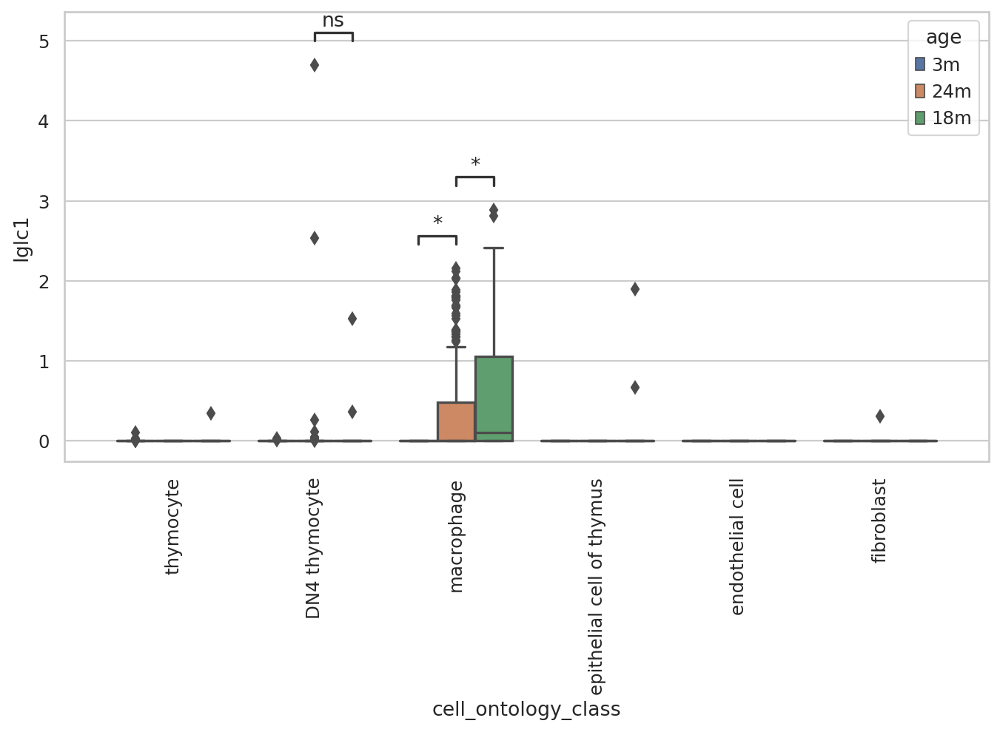

In [171]:
df = tissueBCR[['age','cell_ontology_class','Iglc1']] 

x = "cell_ontology_class" 
y = "Iglc1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Ighd Immunoglobulin heavy constant delta

* Single cell type specificity: Group enriched (Plasma cells, T-cells, B-cells)
* Immune cell specificity: Group enriched (naive B-cell, memory B-cell)

No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

macrophage_3m v.s. macrophage_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.800e+03
macrophage_24m v.s. macrophage_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.429e+04
DN4 thymocyte_24m v.s. DN4 thymocyte_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.640e-01 U_stat=1.763e+05


ValueError: All numbers are identical in mannwhitneyu

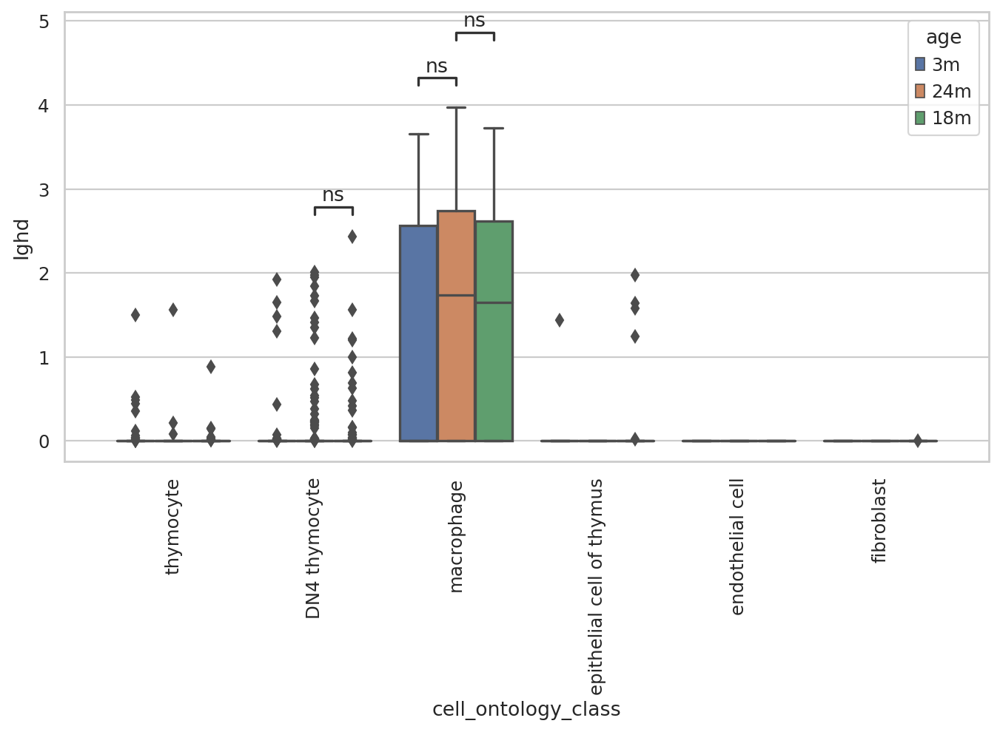

In [172]:
df = tissueBCR[['age','cell_ontology_class','Ighd']]

x = "cell_ontology_class" 
y = "Ighd" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Ighg2b

No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

macrophage_3m v.s. macrophage_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.200e+02
macrophage_18m v.s. macrophage_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.765e-01 U_stat=1.541e+04


ValueError: All numbers are identical in mannwhitneyu

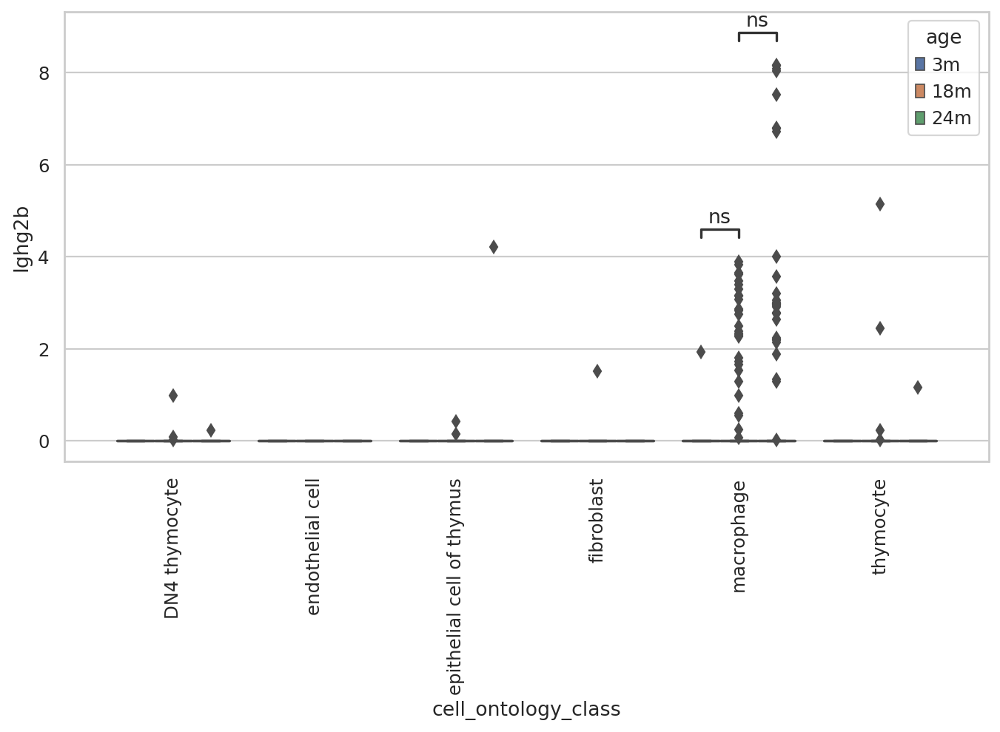

In [227]:
df = df_thy[['age','cell_ontology_class','Ighg2b']]

x = "cell_ontology_class" 
y = "Ighg2b" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Cd38

Cd38 has a zero inflated distribution so I don't think this test works. However it is interesting to see CD38 expression in annotated endothelial cells

No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

macrophage_3m v.s. macrophage_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.612e-01 U_stat=1.583e+03
macrophage_24m v.s. macrophage_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.181e-02 U_stat=1.117e+04
DN4 thymocyte_24m v.s. DN4 thymocyte_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.688e+05
endothelial cell_3m v.s. endothelial cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.938e-01 U_stat=1.760e+02
endothelial cell_24m v.s. endothelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=2.030e+02


ValueError: All numbers are identical in mannwhitneyu

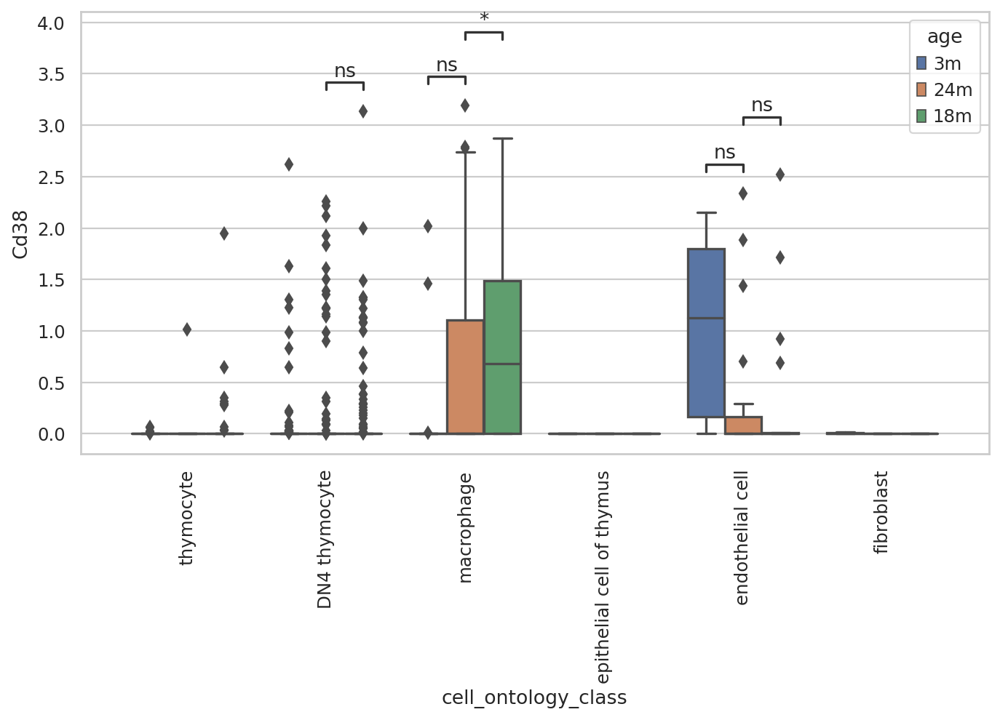

In [164]:
df = tissueIFN[['age','cell_ontology_class','Cd38']]

x = "cell_ontology_class" 
y = "Cd38" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### IFN score_genes

In [163]:
df = tissueIFN[['age','cell_ontology_class','IFN']]

x = "cell_ontology_class" 
y = "IFN" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

KeyError: "['IFN'] not in index"

#### IFN_500 score_genes

In [ ]:
df = tissueIFN[['age','cell_ontology_class','IFN_500']]

x = "cell_ontology_class" 
y = "IFN_500" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### M1 score_genes

In [ ]:
df = tissue_M[['age','cell_ontology_class','M1']]

x = "cell_ontology_class" 
y = "M1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### M1_500 score_genes

In [ ]:
df = tissue_M[['age','cell_ontology_class','M1_500']]

x = "cell_ontology_class" 
y = "M1_500" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### M2 score_genes

In [ ]:
df = tissue_M[['age','cell_ontology_class','M2']]

x = "cell_ontology_class" 
y = "M2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### M2_500 score_genes

In [ ]:
df = tissue_M[['age','cell_ontology_class','M2_500']]

x = "cell_ontology_class" 
y = "M2_500" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### IFN Stat1 gene

In [ ]:
df = tissueIFN[['age','cell_ontology_class','Stat1']]

x = "cell_ontology_class" 
y = "Stat1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### Ifnar2 gene

In [ ]:
df = tissueIFN[['age','cell_ontology_class','Ifnar2']]

x = "cell_ontology_class" 
y = "Ifnar2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)

#### Cd38 gene

Zero inflated distribution

### Exploring Novel Markers to Delineate Murine M1 and M2 Macrophages

'Novel Markers to Delineate Murine M1 and M2 Macrophages' by Jablonski et al. 2015.

https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4689374/

ABSTRACT
"...We validated by real-time PCR an M1-exclusive pattern of expression for **CD38**, G-protein coupled receptor 18 (**Gpr18**) and Formyl peptide receptor 2 (**Fpr2**) whereas Early growth response protein 2 (**Egr2**) and **c-Myc** were M2-exclusive. We further confirmed these data by flow cytometry and show that M1 and M2 macrophages can be distinguished by their relative expression of CD38 and Egr2. Egr2 labeled more M2 macrophages (~70%) than the canonical M2 macrophage marker Arginase-1, which labels 24% of M2 macrophages. Conversely, CD38 labeled most (71%) in vitro M1 macrophages. In vivo, a similar CD38+ population greatly increased after LPS exposure. Overall, this work defines exclusive and common M1 and M2 signatures and provides novel and improved tools to distinguish M1 and M2 murine macrophages."

"Therefore, we performed transcriptional mRNA profiling in murine macrophages in either undifferentiated (M0), M1 or M2 conditions."

"Among these, 21 genes corresponding to canonical M1 markers such as Nos2, IL-1β, IL-6, IL-12β, CCR7, Inhba and TNF-α were also up-regulated in our M1 array (labeled in Fig 1A). Likewise, known M2 macrophage markers Arg1, Chi3l3/Ym1, Retnla/Fizz1, Egr2, Fn1 and Mrc1/CD206 were also expressed in our M2 dataset (labeled in Fig 1B)."

**Paper uses Bone marrow derived macrophages (BMDM). Maybe these aren't M1, M2 macrophages? Or these genes aren't transcribed often in thymus macrophages?**

In [ ]:
if 'Rexo2' in list(tissue.var.index):
    print('yup')
else:
    print('nope')

In [ ]:
leiden16 = ['Rexo2','Fkbp2','Xbp1','Tent5c','Derl3','Slamf7','Sec11c','Jchain','Prdx4','Rpn1']

In [ ]:
leiden16_df = gene_expression_df(tissue,leiden16)

In [ ]:
df.loc[df['col1'] == value]

In [ ]:
#leiden16_df.loc[leiden16_df['leiden'] == '6']
leiden16_df.loc[leiden16_df['leiden'].isin(['6', '16'])]

#### Rexo2 (related to mt transcription)

In [ ]:
df = leiden16_df[['age','cell_ontology_class','Rexo2']]

x = "cell_ontology_class" 
y = "Rexo2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

JCHAIN IN MACROPHAGES IS FUCKING WEIRD

In [ ]:
df = leiden16_df[['age','cell_ontology_class','Jchain']]

x = "cell_ontology_class" 
y = "Jchain" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

### Jablonski

In [ ]:
Jablonski_genes = ['Cd38','Myc','Fpr2','Egr2','Gpr18','Nos2','Il1b','Il6','Il12b','Ccr7','Inhba','Tnf','Arg1','Retnla','Fn1','Mrc1'
                  ]

In [ ]:
Jablonski_df = gene_expression_df(tissue,Jablonski_genes)

#### Mrc1, M2

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Mrc1']]

x = "cell_ontology_class" 
y = "Mrc1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Fn1, M2

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Fn1']]

x = "cell_ontology_class" 
y = "Fn1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Retnla, M2

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Retnla']]

x = "cell_ontology_class" 
y = "Retnla" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Arg1, M2

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Arg1']]

x = "cell_ontology_class" 
y = "Arg1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Tnf, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Tnf']]

x = "cell_ontology_class" 
y = "Tnf" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Inhba, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Inhba']]

x = "cell_ontology_class" 
y = "Inhba" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Il12b, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Il12b']]

x = "cell_ontology_class" 
y = "Il12b" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Ccr7, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Ccr7']]

x = "cell_ontology_class" 
y = "Ccr7" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Il6, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Il6']]

x = "cell_ontology_class" 
y = "Il6" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Il1b, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Il1b']]

x = "cell_ontology_class" 
y = "Il1b" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Nos2, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Nos2']]

x = "cell_ontology_class" 
y = "Nos2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

In [ ]:
df = tissueIFN[['age','cell_ontology_class','Cd38']]

x = "cell_ontology_class" 
y = "Cd38" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Myc, M2

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Myc']]

x = "cell_ontology_class" 
y = "Myc" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.xticks(rotation=90)
plt.legend(loc='upper left', bbox_to_anchor=(1.02, 1))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)




#### Fpr2, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Fpr2']]

x = "cell_ontology_class" 
y = "Fpr2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.xticks(rotation=90)
plt.legend(loc='upper left', bbox_to_anchor=(1.02, 1))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)




#### Egr2, M2

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Egr2']]

x = "cell_ontology_class" 
y = "Egr2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.xticks(rotation=90)
plt.legend(loc='upper left', bbox_to_anchor=(1.02, 1))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)




#### Gpr18, M1

In [ ]:
df = Jablonski_df[['age','cell_ontology_class','Gpr18']]

x = "cell_ontology_class" 
y = "Gpr18" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "18m")),
    (("DN4 thymocyte", "3m"), ("DN4 thymocyte", "24m")),
    (("DN4 thymocyte", "18m"), ("DN4 thymocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "18m")),
    (("epithelial cell of thymus", "3m"), ("epithelial cell of thymus", "24m")),
    (("epithelial cell of thymus", "18m"), ("epithelial cell of thymus", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("thymocyte", "3m"), ("thymocyte", "18m")),
    (("thymocyte", "3m"), ("thymocyte", "24m")),
    (("thymocyte", "18m"), ("thymocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.xticks(rotation=90)
plt.legend(loc='upper left', bbox_to_anchor=(1.02, 1))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)


